## Preparation de la bdd

In [ ]:
!pip install hyperimpute

In [ ]:
!pip install tensorflow==2.15.0 tensorflow-addons

In [ ]:
!git clone https://github.com/johanndejong/VaDER.git

fatal: destination path 'VaDER' already exists and is not an empty directory.


In [ ]:
import sys
import os
import numpy as np
import pandas as pd
from scipy.stats import sem
import matplotlib.pyplot as plt

VaDER_path = '/content/VaDER' # Change this if your VaDER folder is somewhere else
sys.path.append(VaDER_path)
sys.path.append(os.path.join(VaDER_path, 'VaDER'))  # Add path to the inner VaDER folder

# Now import VADER
from vader import VADER
# Vérifier que l'importation a réussi
print("La classe VADER a été importée avec succès !")

/usr/local/lib/python3.11/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
Instructions for updating:
experimental_relax_shapes is deprecated, use reduce_retracing instead


La classe VADER a été importée avec succès !


In [ ]:
import numpy as np
import pandas as pd

In [ ]:
result = pd.read_csv('result_2_wide_format(in).csv', delimiter='\;')

<ipython-input-10-fe5b3c3bf03f>:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  result = pd.read_csv('result_2_wide_format(in).csv', delimiter='\;')


In [ ]:
prd=pd.read_csv('pd_prodromal_patients.csv', delimiter='\,')

<ipython-input-11-dc8a710d1ca8>:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  prd=pd.read_csv('pd_prodromal_patients.csv', delimiter='\,')


In [ ]:
result.columns

Index(['PATNO', 'AGE_ASSESS_SDM_BL', 'AGE_ASSESS_SDM_PW', 'AGE_ASSESS_SDM_R01',
       'AGE_ASSESS_SDM_R06', 'AGE_ASSESS_SDM_ST', 'AGE_ASSESS_SDM_U01',
       'AGE_ASSESS_SDM_V01', 'AGE_ASSESS_SDM_V03', 'AGE_ASSESS_SDM_V04',
       ...
       'STAIAD9_V20', 'STAIAD9_V21', 'SXMO_BL', 'SXMO_SC', 'SXMO_V04',
       'SXYEAR_BL', 'SXYEAR_SC', 'SXYEAR_V04', 'TRACK_SC',
       'UPSIT_CONSENTST_SC'],
      dtype='object', length=9965)

In [ ]:
prd.columns

Index(['PATNO', 'COHORT'], dtype='object')

In [ ]:
ppmi=pd.read_csv("ppmi.csv")

<ipython-input-14-7c427bfda421>:1: DtypeWarning: Columns (85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,374,408,411,414,417,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,545,547,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,565,566,567,568,569,570,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,1869,1870,1871,2362,2365,2366,2367,2369,2370,2372,2373,2374,2375,2376,2377,2378,2379,2380,2381,2382,2383,2384,2385,2386,2387,2391,2392,2393,2394,2395,2397,2398,2399,2400,2401,2402,2403,2404,2405,2406,2407,2408,2409,2410,2

In [ ]:
ppmi.head()

,Unnamed: 0,PATNO,AGE_ASSESS_SDM_BL,AGE_ASSESS_SDM_PW,AGE_ASSESS_SDM_R01,AGE_ASSESS_SDM_R06,AGE_ASSESS_SDM_ST,AGE_ASSESS_SDM_U01,AGE_ASSESS_SDM_V01,AGE_ASSESS_SDM_V03,...,STAIAD9_V21,SXMO_BL,SXMO_SC,SXMO_V04,SXYEAR_BL,SXYEAR_SC,SXYEAR_V04,TRACK_SC,UPSIT_CONSENTST_SC,COHORT
0,0,3001.0,65.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2009.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PD
1,1,3002.0,67.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2009.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PD
2,2,3003.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2006.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PD
3,3,3006.0,57.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2009.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PD
4,4,3007.0,64.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2010.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PD


In [ ]:
ppmi.shape

(1413, 9967)

In [ ]:
ppmi.isnull().sum()

,0
Unnamed: 0,0
PATNO,0
AGE_ASSESS_SDM_BL,39
AGE_ASSESS_SDM_PW,1409
AGE_ASSESS_SDM_R01,1413
...,...
SXYEAR_SC,1413
SXYEAR_V04,1413
TRACK_SC,1413
UPSIT_CONSENTST_SC,1413


In [ ]:
ppmi.columns

Index(['Unnamed: 0', 'PATNO', 'AGE_ASSESS_SDM_BL', 'AGE_ASSESS_SDM_PW',
       'AGE_ASSESS_SDM_R01', 'AGE_ASSESS_SDM_R06', 'AGE_ASSESS_SDM_ST',
       'AGE_ASSESS_SDM_U01', 'AGE_ASSESS_SDM_V01', 'AGE_ASSESS_SDM_V03',
       ...
       'STAIAD9_V21', 'SXMO_BL', 'SXMO_SC', 'SXMO_V04', 'SXYEAR_BL',
       'SXYEAR_SC', 'SXYEAR_V04', 'TRACK_SC', 'UPSIT_CONSENTST_SC', 'COHORT'],
      dtype='object', length=9967)

In [ ]:
missing_cols = ppmi.columns[ppmi.isna().all()]
missing_cols.shape

(534,)

In [ ]:
'''
df_missing = ppmi[missing_cols]
ppmi=ppmi.drop(missing_cols, axis=1)
ppmi.shape
'''

'\ndf_missing = ppmi[missing_cols]\nppmi=ppmi.drop(missing_cols, axis=1)\nppmi.shape\n'

In [ ]:
from sklearn.model_selection import train_test_split

def split_data(df,s):
  train_val_dict={}
  if f"NP3TOT_{s}" in df.columns and f"MCATOT_{s}" in df.columns:
    y1=df[f"NP3TOT_{s}"]
    y2=df[f"MCATOT_{s}"]
    y=pd.concat([y1, y2], axis=1)
    melb_predictors=df.drop([f'NP3TOT_{s}', f'MCATOT_{s}'], axis=1)
    X = melb_predictors.select_dtypes(exclude=['object'])
    X=X[[col for col in X.columns if col.endswith("V01")  or col.startswith("EDUCYRS") or col=="BIRTHSEX_SC"  or col.startswith("AGE_AT_VISIT") or col=="PATNO"]]
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, train_size=0.8, test_size=0.2,random_state=0)
    train_val_dict[f'X_train_{s}'] = X_train
    train_val_dict[f'X_valid_{s}'] = X_valid
    train_val_dict[f'y_train_{s}'] = y_train
    train_val_dict[f'y_valid_{s}'] = y_valid
    train_val_dict[f'X_{s}']=X
    train_val_dict[f'y_{s}']=y
  else:
    print(f"Skipping suffix {s} as one or both columns are missing.")
  return train_val_dict

suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]

all_train_val_dict = {}


for s in suffixes:
    train_val_dict = split_data(ppmi, s)
    if train_val_dict:

        all_train_val_dict[f'X_train_{s}'] = train_val_dict[f"X_train_{s}"]
        all_train_val_dict[f'X_valid_{s}'] = train_val_dict[f"X_valid_{s}"]
        all_train_val_dict[f'y_train_{s}'] = train_val_dict[f"y_train_{s}"]
        all_train_val_dict[f'y_valid_{s}'] = train_val_dict[f"y_valid_{s}"]


        print(f"Suffix {s}:")
        print("X_train shape:", train_val_dict[f"X_train_{s}"].shape)
        print("X_valid shape:", train_val_dict[f"X_valid_{s}"].shape)
        print("y_train shape:", train_val_dict[f"y_train_{s}"].shape)
        print("y_valid shape:", train_val_dict[f"y_valid_{s}"].shape)

    else:
        print(f"Skipping suffix {s} as one or both columns are missing.")

Skipping suffix V02 as one or both columns are missing.
Skipping suffix V02 as one or both columns are missing.
Suffix V03:
X_train shape: (1130, 230)
X_valid shape: (283, 230)
y_train shape: (1130, 2)
y_valid shape: (283, 2)
Suffix V04:
X_train shape: (1130, 230)
X_valid shape: (283, 230)
y_train shape: (1130, 2)
y_valid shape: (283, 2)
Suffix V05:
X_train shape: (1130, 230)
X_valid shape: (283, 230)
y_train shape: (1130, 2)
y_valid shape: (283, 2)
Suffix V06:
X_train shape: (1130, 230)
X_valid shape: (283, 230)
y_train shape: (1130, 2)
y_valid shape: (283, 2)
Skipping suffix V07 as one or both columns are missing.
Skipping suffix V07 as one or both columns are missing.
Suffix V08:
X_train shape: (1130, 230)
X_valid shape: (283, 230)
y_train shape: (1130, 2)
y_valid shape: (283, 2)
Skipping suffix V09 as one or both columns are missing.
Skipping suffix V09 as one or both columns are missing.


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
from sklearn.metrics import r2_score

#Je voudrais creer une fonction pour comparer les modeles dimputations avec randomforest et mean error
def score_dataset(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0)
    # Get the common columns ending with "BL" that are present in both X_train and ppmi.columns
    #bl_cols = [col for col in X_train.columns if col.endswith("V01") and col in ppmi.columns]
    #X_train = X_train[bl_cols]
    #X_valid = X_valid[bl_cols]
    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return mean_absolute_error(y_valid, preds)

def score_dataset2(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0)
    # Get the common columns ending with "BL" that are present in both X_train and ppmi.columns
    #bl_cols = [col for col in X_train.columns if col.endswith("V01") and col in ppmi.columns]
   #X_train = X_train[bl_cols]
   # X_valid = X_valid[bl_cols]
    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return mean_squared_error(y_valid,preds)

def score_dataset3(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0)
    # Get the common columns ending with "BL" that are present in both X_train and ppmi.columns
   #bl_cols = [col for col in X_train.columns if col.endswith("V01") and col in ppmi.columns]
    #X_train = X_train[bl_cols]
    #X_valid = X_valid[bl_cols]
    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return np.sqrt(mean_squared_error(y_valid,preds))

#Pearson’s Correlation Coefficient (R2)
def score_dataset4(X_train, X_valid, y_train, y_valid):
  model = RandomForestRegressor(n_estimators=10, random_state=0)
  # Get the common columns ending with "BL" that are present in both X_train and ppmi.columns
 # bl_cols = [col for col in X_train.columns if col.endswith("V01") and col in ppmi.columns]
 #X_train = X_train[bl_cols]
  #X_valid = X_valid[bl_cols]
  model.fit(X_train, y_train)
  preds = model.predict(X_valid)
  return r2_score(y_valid, preds)

In [ ]:
for s in all_train_val_dict.keys():
  print(s)
  print(all_train_val_dict[s].isnull().sum())


X_train_V03
PATNO                    0
AGE_ASSESS_SDM_V01    1129
AGE_AT_VISIT_BL         22
AGE_AT_VISIT_PW       1126
AGE_AT_VISIT_R01      1049
                      ... 
STAIAD5_V01           1128
STAIAD6_V01           1128
STAIAD7_V01           1128
STAIAD8_V01           1128
STAIAD9_V01           1128
Length: 230, dtype: int64
X_valid_V03
PATNO                   0
AGE_ASSESS_SDM_V01    282
AGE_AT_VISIT_BL         6
AGE_AT_VISIT_PW       278
AGE_AT_VISIT_R01      269
                     ... 
STAIAD5_V01           283
STAIAD6_V01           283
STAIAD7_V01           283
STAIAD8_V01           283
STAIAD9_V01           283
Length: 230, dtype: int64
y_train_V03
NP3TOT_V03    341
MCATOT_V03    164
dtype: int64
y_valid_V03
NP3TOT_V03    64
MCATOT_V03    33
dtype: int64
X_train_V04
PATNO                    0
AGE_ASSESS_SDM_V01    1129
AGE_AT_VISIT_BL         22
AGE_AT_VISIT_PW       1126
AGE_AT_VISIT_R01      1049
                      ... 
STAIAD5_V01           1128
STAIAD6_V01         

## Methodes transersales

In [ ]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from datetime import datetime
import pandas as pd

def imputer_faz(dict_data, suffix, typeImputer, choix):
    start_time = datetime.now()

    if f'X_train_{suffix}' not in dict_data or f'X_valid_{suffix}' not in dict_data or f'y_train_{suffix}' not in dict_data or f'y_valid_{suffix}' not in dict_data:
        return None, None, None, None, None

    X_train = dict_data[f'X_train_{suffix}']
    X_valid = dict_data[f'X_valid_{suffix}']
    y_train = dict_data[f'y_train_{suffix}']
    y_valid = dict_data[f'y_valid_{suffix}']

    cols_with_all_missing = X_train.columns[X_train.isna().all()]
    X_train = X_train.drop(columns=cols_with_all_missing)
    X_valid = X_valid.drop(columns=cols_with_all_missing)

    if choix == "SimpleImputer":
        my_imputer = SimpleImputer(strategy=typeImputer)
    elif choix == "KNNImputer":
        my_imputer = KNNImputer(n_neighbors=typeImputer)
    elif choix == "IterativeImputer":
        my_imputer = IterativeImputer(random_state=0, max_iter=10, n_nearest_features=typeImputer)

    imputed_X_train = pd.DataFrame(my_imputer.fit_transform(X_train), columns=X_train.columns, index=X_train.index)
    imputed_X_valid = pd.DataFrame(my_imputer.transform(X_valid), columns=X_valid.columns, index=X_valid.index)

    y_train_clean = y_train.dropna()
    X_train_clean = imputed_X_train.loc[y_train_clean.index]

    y_valid_clean = y_valid.dropna()
    X_valid_clean = imputed_X_valid.loc[y_valid_clean.index]

    if X_valid_clean.empty:
        print(f" X_valid_clean for suffix {suffix} is empty after filtering. Skipping imputation.")
        return None, None, None, None, None


    mean_mae = score_dataset(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mean_mse = score_dataset2(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mean_rmse = score_dataset3(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mean_r2 = score_dataset4(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)

    end_time = datetime.now()
    execution_time = end_time - start_time

    imputed_df = pd.concat([imputed_X_train, imputed_X_valid])

    return mean_mae, mean_mse, mean_rmse, mean_r2, execution_time, imputed_df


In [ ]:
dict_simpleImputer_mae={}
dict_simpleImputer_mse={}
dict_simpleImputer_rmse={}
dict_simpleImputer_r2={}
dict_simpleImputer_time={}
dict_simpleImputer_imp={}
suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffixes:
  result = imputer_faz(all_train_val_dict,s,"mean","SimpleImputer")

  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp = result
    dict_simpleImputer_mae[s]=mae
    dict_simpleImputer_mse[s]=mse
    dict_simpleImputer_rmse[s]=rmse
    dict_simpleImputer_r2[s]=r2
    dict_simpleImputer_time[s]=time
    dict_simpleImputer_imp[s]=imp
  else:
    print(f"Skipping suffix {s} due to imputation issues.")

Skipping suffix V02 due to imputation issues.
 X_valid_clean for suffix V04 is empty after filtering. Skipping imputation.
Skipping suffix V04 due to imputation issues.
Skipping suffix V07 due to imputation issues.
Skipping suffix V09 due to imputation issues.


In [ ]:
import math
print(dict_simpleImputer_mae)
print(dict_simpleImputer_mse)
print(dict_simpleImputer_rmse)
print(dict_simpleImputer_r2)
print(dict_simpleImputer_time)


filtered_mae_values = {k: v for k, v in dict_simpleImputer_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_simpleImputer_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_simpleImputer_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_simpleImputer_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only


if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V03': 4.285817307692307, 'V05': 5.179545454545454, 'V06': 5.237172774869111, 'V08': 5.971739130434783}
{'V03': 42.641802884615394, 'V05': 61.4363961038961, 'V06': 63.36827225130887, 'V08': 94.43791925465844}
{'V03': 6.530069133218682, 'V05': 7.838137285343763, 'V06': 7.960419100230142, 'V08': 9.71791743403176}
{'V03': 0.33216227481726995, 'V05': 0.2826682044682741, 'V06': 0.2755113106243448, 'V08': 0.2384340860281653}
{'V03': datetime.timedelta(seconds=1, microseconds=7165), 'V05': datetime.timedelta(microseconds=775168), 'V06': datetime.timedelta(microseconds=936086), 'V08': datetime.timedelta(microseconds=833394)}
5.168568666885414
65.4710976236197
8.011635738206087
0.28219396898451354


In [ ]:
dict_simpleImputer_median_mae={}
dict_simpleImputer_median_mse={}
dict_simpleImputer_median_rmse={}
dict_simpleImputer_median_r2={}
dict_simpleImputer_median_time={}
dict_simpleImputer_median_imp={}
suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffixes:
  result = imputer_faz(all_train_val_dict,s,"median","SimpleImputer")

  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp = result
    dict_simpleImputer_median_mae[s]=mae
    dict_simpleImputer_median_mse[s]=mse
    dict_simpleImputer_median_rmse[s]=rmse
    dict_simpleImputer_median_r2[s]=r2
    dict_simpleImputer_median_time[s]=time
    dict_simpleImputer_median_imp[s]=imp
  else:
    print(f"Skipping suffix {s} due to imputation issues.")

Skipping suffix V02 due to imputation issues.
 X_valid_clean for suffix V04 is empty after filtering. Skipping imputation.
Skipping suffix V04 due to imputation issues.
Skipping suffix V07 due to imputation issues.
Skipping suffix V09 due to imputation issues.


In [ ]:
print(dict_simpleImputer_median_mae)
print(dict_simpleImputer_median_mse)
print(dict_simpleImputer_median_rmse)
print(dict_simpleImputer_median_r2)
print(dict_simpleImputer_median_time)


filtered_mae_values = {k: v for k, v in dict_simpleImputer_median_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_simpleImputer_median_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_simpleImputer_median_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_simpleImputer_median_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only


if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")

if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")

if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")

if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V03': 4.352163461538462, 'V05': 5.247727272727272, 'V06': 5.223821989528795, 'V08': 6.04751552795031}
{'V03': 41.087379807692294, 'V05': 61.65756493506492, 'V06': 63.97615183246071, 'V08': 93.61077639751556}
{'V03': 6.409943822506738, 'V05': 7.85223311772294, 'V06': 7.9985093506515765, 'V08': 9.67526621843118}
{'V03': 0.37314706038507744, 'V05': 0.29512154671535573, 'V06': 0.24530166622286487, 'V08': 0.2241955476809278}
{'V03': datetime.timedelta(microseconds=861830), 'V05': datetime.timedelta(microseconds=698209), 'V06': datetime.timedelta(microseconds=856957), 'V08': datetime.timedelta(microseconds=761408)}
5.21780706293621
65.08296824318337
7.983988127328109
0.28444145525105646


In [ ]:
dict_KNNImputer_mae={}
dict_KNNImputer_mse={}
dict_KNNImputer_rmse={}
dict_KNNImputer_r2={}
dict_KNNImputer_time={}
dict_KNNImputer_imp={}
suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffixes:
  result = imputer_faz(all_train_val_dict,s,5,"KNNImputer")
  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp = result
    dict_KNNImputer_mae[s]=mae
    dict_KNNImputer_mse[s]=mse
    dict_KNNImputer_rmse[s]=rmse
    dict_KNNImputer_r2[s]=r2
    dict_KNNImputer_time[s]=time
    dict_KNNImputer_imp[s]=imp
  else:
    print(f"Skipping suffix {s} due to imputation issues.")

Skipping suffix V02 due to imputation issues.
 X_valid_clean for suffix V04 is empty after filtering. Skipping imputation.
Skipping suffix V04 due to imputation issues.
Skipping suffix V07 due to imputation issues.
Skipping suffix V09 due to imputation issues.


In [ ]:
print(dict_KNNImputer_mae)
print(dict_KNNImputer_mse)
print(dict_KNNImputer_rmse)
print(dict_KNNImputer_r2)
print(dict_KNNImputer_time)


filtered_mae_values = {k: v for k, v in dict_KNNImputer_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_KNNImputer_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_KNNImputer_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_KNNImputer_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only

if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V03': 4.5920673076923055, 'V05': 5.276948051948053, 'V06': 5.323560209424085, 'V08': 5.895652173913042}
{'V03': 48.22233173076924, 'V05': 63.91886363636361, 'V06': 69.60151832460734, 'V08': 84.77236024844724}
{'V03': 6.944230103529781, 'V05': 7.9949273690486775, 'V06': 8.342752442965532, 'V08': 9.207190681660027}
{'V03': 0.30623253236401027, 'V05': 0.32147915230581653, 'V06': 0.23931168700635813, 'V08': 0.24738542111095746}
{'V03': datetime.timedelta(seconds=2, microseconds=659582), 'V05': datetime.timedelta(seconds=2, microseconds=400831), 'V06': datetime.timedelta(seconds=2, microseconds=575981), 'V08': datetime.timedelta(seconds=2, microseconds=498068)}
5.272056935744371
66.62876848504686
8.122275149301004
0.27860219819678556


In [ ]:
dict_IterativeImputer_mae={}
dict_IterativeImputer_mse={}
dict_IterativeImputer_rmse={}
dict_IterativeImputer_r2={}
dict_IterativeImputer_time={}
dict_IterativeImputer_imp={}
suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffixes:
  result = imputer_faz(all_train_val_dict,s,10,"IterativeImputer")
  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp = result
    dict_IterativeImputer_mae[s]=mae
    dict_IterativeImputer_mse[s]=mse
    dict_IterativeImputer_rmse[s]=rmse
    dict_IterativeImputer_r2[s]=r2
    dict_IterativeImputer_time[s]=time
    dict_IterativeImputer_imp[s]=imp
  else:
    print(f"Skipping suffix {s} due to imputation issues.")

Skipping suffix V02 due to imputation issues.
 X_valid_clean for suffix V04 is empty after filtering. Skipping imputation.
Skipping suffix V04 due to imputation issues.
Skipping suffix V07 due to imputation issues.
Skipping suffix V09 due to imputation issues.


In [ ]:
print(dict_IterativeImputer_mae)
print(dict_IterativeImputer_mse)
print(dict_IterativeImputer_rmse)
print(dict_IterativeImputer_r2)
print(dict_IterativeImputer_time)
filtered_mae_values = {k: v for k, v in dict_IterativeImputer_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_IterativeImputer_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_IterativeImputer_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_IterativeImputer_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only

if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V03': 4.4394230769230765, 'V05': 4.984415584415584, 'V06': 5.410471204188484, 'V08': 6.004347826086956}
{'V03': 43.946730769230776, 'V05': 57.37844155844157, 'V06': 70.15895287958118, 'V08': 92.95677018633538}
{'V03': 6.629233045325136, 'V05': 7.574855877073937, 'V06': 8.376094130296124, 'V08': 9.641409139038513}
{'V03': 0.3315868305191965, 'V05': 0.29667266515868174, 'V06': 0.23193956984026576, 'V08': 0.2043625780658494}
{'V03': datetime.timedelta(seconds=3, microseconds=157303), 'V05': datetime.timedelta(seconds=2, microseconds=543109), 'V06': datetime.timedelta(seconds=2, microseconds=963360), 'V08': datetime.timedelta(seconds=2, microseconds=729140)}
5.209664422903526
66.11022384839723
8.055398047933428
0.2661404108959983


## Methodes longitudinales

In [ ]:
from datetime import datetime
def imputer_faz_long(dict_data,suffix,typeImputer,choix):
  start_time = datetime.now()
  for i in range(1000000):
    pass
  if f'X_train_{suffix}' not in dict_data or f'X_valid_{suffix}' not in dict_data or f'y_train_{suffix}' not in dict_data or f'y_valid_{suffix}' not in dict_data:
    return None, None, None, None, None,None
  else:
    X_train=dict_data[f'X_train_{suffix}']
    X_valid=dict_data[f'X_valid_{suffix}']
    y_train=dict_data[f'y_train_{suffix}']
    y_valid=dict_data[f'y_valid_{suffix}']



    if choix=="fill":
      X_train=X_train.fillna(method=typeImputer)
      X_valid=X_valid.fillna(method=typeImputer)
    elif choix=="interpolate":
      X_train=X_train.interpolate(method=typeImputer)
      X_valid=X_valid.interpolate(method=typeImputer)

    y_train_clean = y_train.dropna()
    X_train_clean = X_train.loc[y_train_clean.index]
    y_valid_clean = y_valid.dropna()
    X_valid_clean= X_valid.loc[y_valid_clean.index]

    if X_valid_clean.empty:
      print(f"Warning: X_valid_clean for suffix {suffix} is empty after filtering. Skipping imputation.")
      return None, None, None, None, None

    imputed_df=pd.concat([X_train_clean,X_valid_clean])
    mae=score_dataset(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mse=score_dataset2(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    rmse=score_dataset3(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    r2=score_dataset4(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    end_time = datetime.now()
    execution_time = end_time - start_time
    return mae,mse,rmse,r2,execution_time,imputed_df



In [ ]:
dict_locf_mae={}
dict_locf_mse={}
dict_locf_rmse={}
dict_locf_r2={}
dict_locf_time={}
dict_locf_imp={}
suffix=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffix:
  result = imputer_faz_long(all_train_val_dict,s,"ffill","fill")
  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imputed_df = result
    dict_locf_mae[s]=mae
    dict_locf_mse[s]=mse
    dict_locf_rmse[s]=rmse
    dict_locf_r2[s]=r2
    dict_locf_time[s]=time
    dict_locf_imp[s]=imputed_df


<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. 

<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)


In [ ]:
print(dict_locf_mae)
print(dict_locf_mse)
print(dict_locf_rmse)
print(dict_locf_r2)
print(dict_locf_time)
filtered_mae_values = {k: v for k, v in dict_locf_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_locf_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_locf_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_locf_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V02': None, 'V03': 4.715865384615387, 'V05': 5.152597402597405, 'V06': 5.424083769633509, 'V07': None, 'V08': 6.178881987577639, 'V09': None}
{'V02': None, 'V03': 51.10596153846153, 'V05': 63.49538961038961, 'V06': 71.3787958115183, 'V07': None, 'V08': 102.02956521739125, 'V09': None}
{'V02': None, 'V03': 7.148843370676233, 'V05': 7.968399438431134, 'V06': 8.448597268867672, 'V07': None, 'V08': 10.100968528680369, 'V09': None}
{'V02': None, 'V03': 0.29548503628831835, 'V05': 0.2700514258878703, 'V06': 0.2437542509909068, 'V07': None, 'V08': 0.15612374788736982, 'V09': None}
{'V02': None, 'V03': datetime.timedelta(seconds=1, microseconds=466479), 'V05': datetime.timedelta(seconds=1, microseconds=112652), 'V06': datetime.timedelta(seconds=1, microseconds=355527), 'V07': None, 'V08': datetime.timedelta(seconds=1, microseconds=219723), 'V09': None}
5.367857136105985
72.00242804444017
8.416702151663852
0.24135361526361632


In [ ]:
dict_nocb_mae={}
dict_nocb_mse={}
dict_nocb_rmse={}
dict_nocb_r2={}
dict_nocb_time={}
dict_nocb_imp={}
suffix=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffix:
  result = imputer_faz_long(all_train_val_dict,s,"bfill","fill")
  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp= result
    dict_nocb_mae[s]=mae
    dict_nocb_mse[s]=mse
    dict_nocb_rmse[s]=rmse
    dict_nocb_r2[s]=r2
    dict_nocb_time[s]=time
    dict_nocb_imp[s]=imp

<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. 

<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:17: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_train=X_train.fillna(method=typeImputer)
<ipython-input-33-ab93c5f5aab1>:18: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  X_valid=X_valid.fillna(method=typeImputer)


In [ ]:
print(dict_nocb_mae)
print(dict_nocb_mse)
print(dict_nocb_rmse)
print(dict_nocb_r2)
print(dict_nocb_time)
filtered_mae_values = {k: v for k, v in dict_nocb_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_nocb_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_nocb_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_nocb_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V02': None, 'V03': 4.593750000000002, 'V05': 5.141883116883115, 'V06': 5.622774869109948, 'V07': None, 'V08': 6.555279503105595, 'V09': None}
{'V02': None, 'V03': 47.32475961538464, 'V05': 64.48860389610388, 'V06': 71.80400523560206, 'V07': None, 'V08': 110.86956521739134, 'V09': None}
{'V02': None, 'V03': 6.879299354976831, 'V05': 8.03047968032445, 'V06': 8.473724401678524, 'V07': None, 'V08': 10.52946177244551, 'V09': None}
{'V02': None, 'V03': 0.2959571343378512, 'V05': 0.280871773023391, 'V06': 0.19465045801256392, 'V07': None, 'V08': 0.1388329217770265, 'V09': None}
{'V02': None, 'V03': datetime.timedelta(seconds=1, microseconds=514059), 'V05': datetime.timedelta(seconds=1, microseconds=118801), 'V06': datetime.timedelta(seconds=1, microseconds=446804), 'V07': None, 'V08': datetime.timedelta(seconds=1, microseconds=281587), 'V09': None}
5.478421872274665
73.62173349112048
8.478241302356329
0.22757807178770817


In [ ]:
dict_interpolate_mae={}
dict_interpolate_mse={}
dict_interpolate_rmse={}
dict_interpolate_r2={}
dict_interpolate_time={}
dict_interpolate_imp={}
suffix=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffix:
  result = imputer_faz_long(all_train_val_dict,s,"linear","interpolate")
  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp = result
    dict_interpolate_mae[s]=mae
    dict_interpolate_mse[s]=mse
    dict_interpolate_rmse[s]=rmse
    dict_interpolate_r2[s]=r2
    dict_interpolate_time[s]=time
    dict_interpolate_imp[s]=imp

In [ ]:
print(dict_interpolate_mae)
print(dict_interpolate_mse)
print(dict_interpolate_rmse)
print(dict_interpolate_r2)
print(dict_interpolate_time)
filtered_mae_values = {k: v for k, v in dict_interpolate_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_interpolate_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_interpolate_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_interpolate_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V02': None, 'V03': 4.739903846153847, 'V05': 5.469480519480522, 'V06': 5.63560209424084, 'V07': None, 'V08': 6.2195652173913025, 'V09': None}
{'V02': None, 'V03': 49.194278846153814, 'V05': 69.30993506493505, 'V06': 73.84732984293193, 'V07': None, 'V08': 96.51394409937892, 'V09': None}
{'V02': None, 'V03': 7.013863332440533, 'V05': 8.325258858734367, 'V06': 8.593446912789531, 'V07': None, 'V08': 9.824151062528452, 'V09': None}
{'V02': None, 'V03': 0.25060638796660545, 'V05': 0.20277482047442802, 'V06': 0.1958952800466407, 'V07': None, 'V08': 0.21158299209858722, 'V09': None}
{'V02': None, 'V03': datetime.timedelta(seconds=2, microseconds=400987), 'V05': datetime.timedelta(seconds=1, microseconds=800156), 'V06': datetime.timedelta(seconds=2, microseconds=261889), 'V07': None, 'V08': datetime.timedelta(seconds=1, microseconds=988738), 'V09': None}
5.516137919316628
72.21637196334993
8.43918004162322
0.21521487014656535


In [ ]:
import numpy as np
import pandas as pd
from datetime import datetime


class KalmanFilter:
    def __init__(self, F, B, H, Q, R, x0, P0):
        self.F = F
        self.B = B
        self.H = H
        self.Q = Q
        self.R = R
        self.x = x0
        self.P = P0

    def predict(self, u):
        self.x = np.dot(self.F, self.x) + np.dot(self.B, u)
        self.P = np.dot(np.dot(self.F, self.P), self.F.T) + self.Q
        return self.x

    def update(self, z):
        S = np.dot(np.dot(self.H, self.P), self.H.T) + self.R
        K = np.dot(np.dot(self.P, self.H.T), np.linalg.inv(S))
        y = z - np.dot(self.H, self.x)
        self.x = self.x + np.dot(K, y)
        I = np.eye(self.P.shape[0])
        self.P = np.dot(np.dot(I - np.dot(K, self.H), self.P), (I - np.dot(K, self.H)).T) + np.dot(np.dot(K, self.R), K.T)
        return self.x

# Paramètres du filtre de Kalman
F = np.array([[1, 1], [0, 1]])
B = np.array([[0.5], [1]])
H = np.array([[1, 0]])
Q = np.array([[1, 0], [0, 1]])
R = np.array([[1]])
x0 = np.array([[0], [1]])
P0 = np.array([[1, 0], [0, 1]])


# Fonction d'imputation avec le filtre de Kalman
def impute_kalman(X_clean):
    X_kalman = X_clean.copy()

    for col in X_clean.columns:
        data = X_clean[col].values
        missing_indices = np.where(np.isnan(data))[0]
        observed_indices = np.where(~np.isnan(data))[0]

        # Réinitialiser le filtre de Kalman pour chaque colonne
        kf = KalmanFilter(F, B, H, Q, R, x0, P0)

        if len(missing_indices) > 0:
            for i in range(len(data)):
                u = np.array([[0]])
                if i in observed_indices:
                    kf.update(np.array([[data[i]]]))
                else:
                    predicted_value = kf.predict(u)[0, 0]
                    data[i] = predicted_value

            X_kalman[col] = data

    return X_kalman

def imputer_kalman_faz(dict_data,suffix):
  start_time = datetime.now()
  for i in range(1000000):
    pass
  if f'X_train_{suffix}' not in dict_data or f'X_valid_{suffix}' not in dict_data or f'y_train_{suffix}' not in dict_data or f'y_valid_{suffix}' not in dict_data:
    return None, None, None, None, None,None
  else:
    X_train=dict_data[f'X_train_{suffix}']
    X_valid=dict_data[f'X_valid_{suffix}']
    y_train=dict_data[f'y_train_{suffix}']
    y_valid=dict_data[f'y_valid_{suffix}']
    X_train_kalman=X_train.copy()
    X_valid_kalman=X_valid.copy()

    # Imputation pour X_train et X_valid
    X_train_kalman = impute_kalman(X_train_kalman)
    X_valid_kalman = impute_kalman(X_valid_kalman)

    y_train_clean_kalman = y_train.dropna()
    X_train_clean_kalman = X_train_kalman.loc[y_train_clean_kalman.index]
    y_valid_clean_kalman = y_valid.dropna()
    X_valid_clean_kalman = X_valid_kalman.loc[y_valid_clean_kalman.index]


    if X_valid_clean_kalman.empty:
      print(f"Warning: X_valid_clean_kalman for suffix {suffix} is empty after filtering. Skipping imputation.")
      return None, None, None, None, None
    imputed_df=pd.concat([X_train_clean_kalman,X_valid_clean_kalman])

    # Évaluation
    kalman_mae = score_dataset(X_train_clean_kalman, X_valid_clean_kalman, y_train_clean_kalman, y_valid_clean_kalman)
    kalman_mse=score_dataset2(X_train_clean_kalman, X_valid_clean_kalman, y_train_clean_kalman, y_valid_clean_kalman)
    kalman_rmse=score_dataset3(X_train_clean_kalman, X_valid_clean_kalman, y_train_clean_kalman, y_valid_clean_kalman)
    kalman_r2=score_dataset4(X_train_clean_kalman, X_valid_clean_kalman, y_train_clean_kalman, y_valid_clean_kalman)
    end_time = datetime.now()
    execution_time = end_time - start_time
    return kalman_mae,kalman_mse,kalman_rmse,kalman_r2,execution_time,imputed_df




In [ ]:
dict_kalman_mae={}
dict_kalman_mse={}
dict_kalman_rmse={}
dict_kalman_r2={}
dict_kalman_time={}
dict_kalman_imp={}
suffix=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffix:
  result = imputer_kalman_faz(all_train_val_dict,s)
  if result and len(result) == 6:
    mae,mse,rmse,r2,time,imp = result
    dict_kalman_mae[s]=mae
    dict_kalman_mse[s]=mse
    dict_kalman_rmse[s]=rmse
    dict_kalman_r2[s]=r2
    dict_kalman_time[s]=time
    dict_kalman_imp[s]=imp

In [ ]:
print(dict_kalman_mae)
print(dict_kalman_mse)
print(dict_kalman_rmse)
print(dict_kalman_r2)
print(dict_kalman_time)
filtered_mae_values = {k: v for k, v in dict_kalman_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_kalman_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_kalman_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_kalman_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V02': None, 'V03': 4.8471153846153845, 'V05': 5.590909090909091, 'V06': 5.627748691099475, 'V07': None, 'V08': 6.106211180124223, 'V09': None}
{'V02': None, 'V03': 53.441971153846154, 'V05': 68.23532467532472, 'V06': 71.9604712041885, 'V07': None, 'V08': 95.85279503105585, 'V09': None}
{'V02': None, 'V03': 7.310401572680269, 'V05': 8.260467582124193, 'V06': 8.482951797823002, 'V07': None, 'V08': 9.790444067102158, 'V09': None}
{'V02': None, 'V03': 0.22577463737172415, 'V05': 0.21208612623126222, 'V06': 0.19401420860835666, 'V07': None, 'V08': 0.15015807317550872, 'V09': None}
{'V02': None, 'V03': datetime.timedelta(seconds=11, microseconds=235660), 'V05': datetime.timedelta(seconds=9, microseconds=914253), 'V06': datetime.timedelta(seconds=11, microseconds=2048), 'V07': None, 'V08': datetime.timedelta(seconds=10, microseconds=322886), 'V09': None}
5.542996086687043
72.3726405161038
8.461066254932405
0.19550826134671295


In [ ]:
print(dict_kalman_imp)

{'V02': None, 'V03':          PATNO  AGE_ASSESS_SDM_V01  AGE_AT_VISIT_BL  AGE_AT_VISIT_PW  \
486    40541.0            1.000000             56.3         1.000000   
446     4121.0            2.000000             65.3         2.000000   
621    41430.0            3.000000             51.7         3.000000   
988    58909.0            5.000000             68.5         5.000000   
1380  174209.0            6.000000             65.9         6.000000   
...        ...                 ...              ...              ...   
489    40544.0           66.005364             70.5        78.219987   
987    58865.0           66.151792             63.3        78.634973   
1011   59558.0           66.298219             73.5        79.049959   
1069   70241.0           66.591074             64.4        79.879932   
760    50670.0           66.664287             53.1        80.087425   

      AGE_AT_VISIT_R01  AGE_AT_VISIT_R04  AGE_AT_VISIT_R06  AGE_AT_VISIT_R08  \
486           1.000000          1.

In [ ]:
import numpy as np
import pandas as pd
from datetime import datetime

class KalmanFilter:

    def __init__(self, F, B, H, Q, R, x0, P0):
        self.F = F
        self.B = B
        self.H = H
        self.Q = Q
        self.R = R
        self.x = x0
        self.P = P0

    def predict(self, u=None):

        if u is None:
            u = np.zeros((self.B.shape[1], 1))

        self.x = np.dot(self.F, self.x) + np.dot(self.B, u)
        self.P = np.dot(np.dot(self.F, self.P), self.F.T) + self.Q
        return self.x

    def update(self, z):

        S = np.dot(np.dot(self.H, self.P), self.H.T) + self.R
        K = np.dot(np.dot(self.P, self.H.T), np.linalg.inv(S))
        y = z - np.dot(self.H, self.x)
        self.x = self.x + np.dot(K, y)
        I = np.eye(self.P.shape[0])
        self.P = np.dot(np.dot(I - np.dot(K, self.H), self.P), (I - np.dot(K, self.H)).T) + np.dot(np.dot(K, self.R), K.T)
        return self.x


def initialize_kalman_parameters(data):

    F = np.array([[1, 1], [0, 1]])
    B = np.array([[0.5], [1]])
    H = np.array([[1, 0]])

    # j'estime des bruits à partir des données
    non_nan_data = data[~np.isnan(data)]
    if len(non_nan_data) > 1:
        # je varie les données pour initialiser Q et R
        data_var = np.var(non_nan_data) if len(non_nan_data) > 1 else 1.0
        Q = np.array([[data_var/10, 0], [0, data_var/10]])  # Bruit du processus
        R = np.array([[data_var/5]]) + 1e-6                       # Bruit de mesure

        # État initial
        x0 = np.array([[non_nan_data[0]], [0]])  # Position = première valeur, vitesse = 0
    else:
        # Valeurs par défaut si pas assez de données
        Q = np.array([[1, 0], [0, 1]])
        R = np.array([[1]])
        x0 = np.array([[0], [0]])

    # Covariance initiale
    P0 = np.array([[10, 0], [0, 10]])

    return F, B, H, Q, R, x0, P0


def impute_kalman(df, time_sorted=True):

    X_kalman = df.copy()

    for col in df.columns:
        if not df[col].isna().any():
            continue

        print(f"Imputation de la colonne {col} avec Kalman...")
        data = df[col].values
        missing_indices = np.where(np.isnan(data))[0]

        if len(missing_indices) == 0 or len(missing_indices) == len(data):
            continue

        # Initialiser les paramètres du filtre adaptés à cette colonne
        F, B, H, Q, R, x0, P0 = initialize_kalman_parameters(data)
        kf = KalmanFilter(F, B, H, Q, R, x0, P0)

        # 1. Forward pass (0 -> n)
        imputed_forward = np.copy(data)
        for i in range(len(data)):
            if np.isnan(data[i]):

                imputed_forward[i] = kf.predict()[0, 0]
            else:
                kf.update(np.array([[data[i]]]))
                imputed_forward[i] = kf.x[0, 0]

        # 2. Backward pass (n -> 0) avec nouveaux paramètres
        F, B, H, Q, R, x0, P0 = initialize_kalman_parameters(imputed_forward)
        kf = KalmanFilter(F, B, H, Q, R, x0, P0)
        imputed_backward = np.copy(imputed_forward)

        for i in range(len(imputed_forward) - 1, -1, -1):
            if np.isnan(data[i]):
                imputed_backward[i] = (imputed_backward[i] + kf.predict()[0, 0]) / 2
            else:
                kf.update(np.array([[data[i]]]))

        for idx in missing_indices:
            X_kalman.loc[X_kalman.index[idx], col] = imputed_backward[idx]

    return X_kalman


def imputer_kalman_second(dict_data, suffix):

    start_time = datetime.now()

    required_keys = [f'X_train_{suffix}', f'X_valid_{suffix}', f'y_train_{suffix}', f'y_valid_{suffix}']
    if not all(key in dict_data for key in required_keys):
        print(f"Données manquantes pour le suffixe {suffix}. Imputation impossible.")
        return None, None, None, None, None, None

    X_train = dict_data[f'X_train_{suffix}']
    X_valid = dict_data[f'X_valid_{suffix}']
    y_train = dict_data[f'y_train_{suffix}']
    y_valid = dict_data[f'y_valid_{suffix}']

    print(f"Imputation des données d'entraînement pour {suffix}...")
    X_train_kalman = impute_kalman(X_train)

    print(f"Imputation des données de validation pour {suffix}...")
    X_valid_kalman = impute_kalman(X_valid)

    y_train_clean = y_train.dropna()
    X_train_clean = X_train_kalman.loc[y_train_clean.index]

    y_valid_clean = y_valid.dropna()
    X_valid_clean = X_valid_kalman.loc[y_valid_clean.index]

    if X_valid_clean.empty or X_train_clean.empty:
        print(f"Warning: Ensembles de données vides après nettoyage pour {suffix}. Imputation abandonnée.")
        return None, None, None, None, None, None

    imputed_df = pd.concat([X_train_clean, X_valid_clean])

    try:
        mae = score_dataset(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
        mse = score_dataset2(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
        rmse = score_dataset3(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
        r2 = score_dataset4(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    except NameError:
        print("ATTENTION: Les fonctions de score ne sont pas définies. Retournant None pour les métriques.")
        mae = mse = rmse = r2 = None

    # Calculer le temps d'exécution
    end_time = datetime.now()
    execution_time = end_time - start_time

    return mae, mse, rmse, r2, execution_time, imputed_df

dict_kalman_maesecond = {}
dict_kalman_msesecond = {}
dict_kalman_rmsesecond = {}
dict_kalman_r2second = {}
dict_kalman_timesecond = {}
dict_kalman_impsecond = {}
suffix = ["V02", "V03", "V04", "V05", "V06", "V07", "V08", "V09"]
for s in suffix:
    result = imputer_kalman_second(all_train_val_dict, s)
    if result and len(result) == 6:
        mae, mse, rmse, r2, time, imputed_df = result
        dict_kalman_maesecond[s] = mae
        dict_kalman_msesecond[s] = mse
        dict_kalman_rmsesecond[s] = rmse
        dict_kalman_r2second[s] = r2
        dict_kalman_timesecond[s] = time
        dict_kalman_impsecond[s] = imputed_df
    else:
        print(f"Skipping {s}, no result.")

print(dict_kalman_maesecond)
print(dict_kalman_msesecond)
print(dict_kalman_rmsesecond)
print(dict_kalman_r2second)
print(dict_kalman_timesecond)
filtered_mae_values= {k: v for k, v in dict_kalman_maesecond.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values= {k: v for k, v in dict_kalman_msesecond.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values= {k: v for k, v in dict_kalman_rmsesecond.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values= {k: v for k, v in dict_kalman_r2second.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values))

Données manquantes pour le suffixe V02. Imputation impossible.
Imputation des données d'entraînement pour V03...
Imputation de la colonne AGE_ASSESS_SDM_V01 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_BL avec Kalman...
Imputation de la colonne AGE_AT_VISIT_PW avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R01 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R04 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R06 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R08 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R10 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R12 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R13 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R14 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R15 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R16 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R17 avec Kalman...
Imputation de la colonne AGE_AT_VISIT_R18 avec Kalman...
Imputation de la colonne AGE_AT_

In [ ]:
import statsmodels.formula.api as smf
import pandas as pd
import numpy as np

def imputer_llm_faz(dict_data,suffix):
  start_time = datetime.now()
  for i in range(1000000):
    pass
  if f'X_train_{suffix}' not in dict_data or f'X_valid_{suffix}' not in dict_data or f'y_train_{suffix}' not in dict_data or f'y_valid_{suffix}' not in dict_data:
    return None, None, None, None, None
  else:
    X_train=dict_data[f'X_train_{suffix}']
    X_valid=dict_data[f'X_valid_{suffix}']
    y_train=dict_data[f'y_train_{suffix}']
    y_valid=dict_data[f'y_valid_{suffix}']


    X_filled = X_train.copy()

    # Identifier les colonnes contenant des valeurs manquantes
    columns_with_nan = X_filled.columns[X_filled.isna().any()].tolist()
    print(f"Colonnes à imputer : {columns_with_nan}")

    # Variable de regroupement (doit être catégorielle ou discrète)
    group_var = "PATNO"

    for col in columns_with_nan:
        print(f"Imputation de {col}...")

        X_missing = X_filled[X_filled[col].isna()]
        subset = X_filled.dropna(subset=[col]).sample(min(100, len(X_filled.dropna(subset=[col]))), random_state=42)

        if len(subset) > 10:
            formula = f"{col} ~ 1"  # Modèle avec intercept seulement
            lmmmodel = smf.mixedlm(formula, subset, groups=subset[group_var], re_formula="1")

            try:
                result = lmmmodel.fit()
                X_filled.loc[X_missing.index, col] = result.predict(X_missing)
            except Exception as e:
                print(f"Problème d'ajustement pour {col}: {e}")


    X_filled_valid = X_valid.copy()
    columns_with_nan_valid = X_filled_valid.columns[X_filled_valid.isna().any()].tolist()
    for col in columns_with_nan_valid:
        X_missing_valid = X_filled_valid[X_filled_valid[col].isna()]
        subset_valid = X_filled_valid.dropna(subset=[col]).sample(min(100, len(X_filled_valid.dropna(subset=[col]))), random_state=42)
        if len(subset_valid) > 10:
            formula = f"{col} ~ 1"
            lmmmodel = smf.mixedlm(formula, subset_valid, groups=subset_valid[group_var], re_formula="1")
            try:
                result = lmmmodel.fit()
                X_filled_valid.loc[X_missing_valid.index, col] = result.predict(X_missing_valid)
            except Exception as e:
                print(f"Problème d'ajustement pour {col}: {e}")

    y_train_clean = y_train.dropna()
    X_train_clean = X_filled.loc[y_train_clean.index]
    y_valid_clean = y_valid.dropna()
    X_valid_clean = X_filled_valid.loc[y_valid_clean.index]

    if X_valid_clean.empty or X_train_clean.empty:
      print(f"Warning: X_valid_clean_kalman for suffix {suffix} is empty after filtering. Skipping imputation.")
      return None, None, None, None, None
    imputed_df=pd.concat([X_train_clean,X_valid_clean])
    mae=score_dataset(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mse=score_dataset2(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    rmse=score_dataset3(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    r2=score_dataset4(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    end_time = datetime.now()
    execution_time = end_time - start_time
    return mae,mse,rmse,r2,execution_time,imputed_df


In [ ]:
dict_llm_mae={}
dict_llm_mse={}
dict_llm_rmse={}
dict_llm_r2={}
dict_llm_time={}
dict_llm_imp={}
suffix=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffix:
    result = imputer_llm_faz(all_train_val_dict, s)
    if result and len(result) == 6:
        mae, mse, rmse, r2, time,imputed_df = result
        dict_llm_mae[s] = mae
        dict_llm_mse[s] = mse
        dict_llm_rmse[s] = rmse
        dict_llm_r2[s] = r2
        dict_llm_time[s] = time
        dict_llm_imp[s] = imputed_df
    else:
        print(f"Skipping {s}, no result.")


Skipping V02, no result.
Colonnes à imputer : ['AGE_ASSESS_SDM_V01', 'AGE_AT_VISIT_BL', 'AGE_AT_VISIT_PW', 'AGE_AT_VISIT_R01', 'AGE_AT_VISIT_R04', 'AGE_AT_VISIT_R06', 'AGE_AT_VISIT_R08', 'AGE_AT_VISIT_R10', 'AGE_AT_VISIT_R12', 'AGE_AT_VISIT_R13', 'AGE_AT_VISIT_R14', 'AGE_AT_VISIT_R15', 'AGE_AT_VISIT_R16', 'AGE_AT_VISIT_R17', 'AGE_AT_VISIT_R18', 'AGE_AT_VISIT_R19', 'AGE_AT_VISIT_R20', 'AGE_AT_VISIT_R21', 'AGE_AT_VISIT_RS1', 'AGE_AT_VISIT_SC', 'AGE_AT_VISIT_ST', 'AGE_AT_VISIT_U01', 'AGE_AT_VISIT_U02', 'AGE_AT_VISIT_V01', 'AGE_AT_VISIT_V02', 'AGE_AT_VISIT_V03', 'AGE_AT_VISIT_V04', 'AGE_AT_VISIT_V05', 'AGE_AT_VISIT_V06', 'AGE_AT_VISIT_V07', 'AGE_AT_VISIT_V08', 'AGE_AT_VISIT_V09', 'AGE_AT_VISIT_V10', 'AGE_AT_VISIT_V11', 'AGE_AT_VISIT_V12', 'AGE_AT_VISIT_V13', 'AGE_AT_VISIT_V14', 'AGE_AT_VISIT_V15', 'AGE_AT_VISIT_V16', 'AGE_AT_VISIT_V17', 'AGE_AT_VISIT_V18', 'AGE_AT_VISIT_V19', 'AGE_AT_VISIT_V20', 'AGE_AT_VISIT_V21', 'BIRTHSEX_SC', 'COGCAT_V01', 'COGDECLN_V01', 'COGDXCL_V01', 'COGSTATE_V01',

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R10...
Imputation de AGE_AT_VISIT_R12...
Imputation de AGE_AT_VISIT_R13...
Imputation de AGE_AT_VISIT_R14...
Imputation de AGE_AT_VISIT_R15...
Imputation de AGE_AT_VISIT_R16...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R17...
Imputation de AGE_AT_VISIT_R18...
Imputation de AGE_AT_VISIT_R19...
Imputation de AGE_AT_VISIT_R20...
Imputation de AGE_AT_VISIT_R21...
Imputation de AGE_AT_VISIT_RS1...
Imputation de AGE_AT_VISIT_SC...
Imputation de AGE_AT_VISIT_ST...
Imputation de AGE_AT_VISIT_U01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_U02...
Imputation de AGE_AT_VISIT_V01...
Imputation de AGE_AT_VISIT_V02...
Imputation de AGE_AT_VISIT_V03...
Imputation de AGE_AT_VISIT_V04...
Imputation de AGE_AT_VISIT_V05...
Imputation de AGE_AT_VISIT_V06...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V07...
Imputation de AGE_AT_VISIT_V08...
Imputation de AGE_AT_VISIT_V09...
Imputation de AGE_AT_VISIT_V10...
Imputation de AGE_AT_VISIT_V11...
Imputation de AGE_AT_VISIT_V12...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V13...
Imputation de AGE_AT_VISIT_V14...
Imputation de AGE_AT_VISIT_V15...
Imputation de AGE_AT_VISIT_V16...
Imputation de AGE_AT_VISIT_V17...
Imputation de AGE_AT_VISIT_V18...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V19...
Imputation de AGE_AT_VISIT_V20...
Imputation de AGE_AT_VISIT_V21...
Imputation de BIRTHSEX_SC...
Imputation de COGCAT_V01...
Imputation de COGDECLN_V01...
Imputation de COGDXCL_V01...
Imputation de COGSTATE_V01...
Imputation de COHORT_OL_V01...
Imputation de DBSYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: 

Imputation de DVSD_SDM_V01...
Imputation de DVT_SDM_V01...
Imputation de DYSKPRES_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de EDUCYRS_BL...
Imputation de EDUCYRS_R08...
Imputation de EDUCYRS_R16...
Imputation de EDUCYRS_SC...
Imputation de FEATACTTRM_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATBWLDYS_V01...
Imputation de FEATCOGFLC_V01...
Imputation de FEATDYSPHG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATDYSTNA_V01...
Imputation de FEATMYCLNS_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/l

Imputation de FEATNOLEVO_V01...
Problème d'ajustement pour FEATNOLEVO_V01: Singular matrix
Imputation de FEATPOSHYP_V01...
Imputation de FEATSEXDYS_V01...
Imputation de FEATURNDYS_V01...
Imputation de FEATWDGAIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge.

Imputation de FNCDTCOG_V01...
Imputation de GDSAFRAD_V01...
Imputation de GDSALIVE_V01...
Imputation de GDSBETER_V01...
Imputation de GDSBORED_V01...
Imputation de GDSDROPD_V01...
Imputation de GDSEMPTY_V01...
Imputation de GDSENRGY_V01...
Imputation de GDSGSPIR_V01...
Imputation de GDSHAPPY_V01...
Imputation de GDSHLPLS_V01...
Imputation de GDSHOME_V01...
Imputation de GDSHOPLS_V01...
Imputation de GDSMEMRY_V01...
Imputation de GDSSATIS_V01...
Imputation de GDSWRTLS_V01...
Imputation de HRPOSTMED_V01...
Imputation de MCAABSTR_V01...
Imputation de MCAALTTM_V01...
Imputation de MCABDS_V01...
Imputation de MCACAMEL_V01...
Imputation de MCACITY_V01...
Imputation de MCACLCKC_V01...
Imputation de MCACLCKH_V01...
Imputation de MCACLCKN_V01...
Imputation de MCACUBE_V01...
Imputation de MCADATE_V01...
Imputation de MCADAY_V01...
Imputation de MCAFDS_V01...
Imputation de MCALION_V01...
Imputation de MCAMONTH_V01...
Imputation de MCAPLACE_V01...
Imputation de MCAREC1_V01...
Imputation de MCAREC2

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP1APAT_V01...
Imputation de NP1COG_V01...
Imputation de NP1DDS_V01...
Imputation de NP1DPRS_V01...
Imputation de NP1HALL_V01...
Imputation de NP1RTOT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2DRES_V01...
Imputation de NP2EAT_V01...
Imputation de NP2FREZ_V01...
Imputation de NP2HOBB_V01...
Imputation de NP2HWRT_V01...
Imputation de NP2HYGN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2PTOT_V01...
Imputation de NP2RISE_V01...
Imputation de NP2SALV_V01...
Imputation de NP2SPCH_V01...
Imputation de NP2SWAL_V01...
Imputation de NP2TRMR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2TURN_V01...
Imputation de NP2WALK_V01...
Imputation de NP3BRADY_V01...
Imputation de NP3FACXP_V01...
Imputation de NP3FRZGT_V01...
Imputation de NP3FTAPL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3FTAPR_V01...
Imputation de NP3GAIT_V01...
Imputation de NP3HMOVL_V01...
Imputation de NP3HMOVR_V01...
Imputation de NP3KTRML_V01...
Imputation de NP3KTRMR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Imputation de NP3LGAGL_V01...
Imputation de NP3LGAGR_V01...
Imputation de NP3POSTR_V01...
Imputation de NP3PRSPL_V01...
Imputation de NP3PRSPR_V01...
Imputation de NP3PSTBL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3PTRML_V01...
Imputation de NP3PTRMR_V01...
Imputation de NP3RIGLL_V01...
Problème d'ajustement pour NP3RIGLL_V01: Singular matrix
Imputation de NP3RIGLU_V01...
Imputation de NP3RIGN_V01...
Imputation de NP3RIGRL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RIGRU_V01...
Imputation de NP3RISNG_V01...
Imputation de NP3RTALJ_V01...
Imputation de NP3RTALL_V01...
Imputation de NP3RTALU_V01...
Imputation de NP3RTARL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RTARU_V01...
Imputation de NP3RTCON_V01...
Imputation de NP3SPCH_V01...
Imputation de NP3TOT_V01...
Imputation de NP3TTAPL_V01...
Imputation de NP3TTAPR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP4DYSKI_V01...
Imputation de NP4DYSTN_V01...
Imputation de NP4FLCTI_V01...
Imputation de NP4FLCTX_V01...
Imputation de NP4OFF_V01...
Imputation de NP4TOT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP4WDYSK_V01...
Imputation de NUPSOURC_prev_V01...
Imputation de NUPSOURC_score2_V01...
Imputation de PDMEDYN_V01...
Imputation de PDTRTMNT_V01...
Imputation de PRIMDIAG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de PTCGBOTH_V01...
Imputation de REC_ID_df5_V01...
Imputation de REC_ID_y_V01...
Imputation de RVWNPSY_V01...
Imputation de SDMTOTAL_V01...
Imputation de SDMTVRSN_V01...
Imputation de STAIAD1_V01...
Imputation de STAIAD10_V01...
Imputation de STAIAD11_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de STAIAD12_V01...
Imputation de STAIAD13_V01...
Imputation de STAIAD14_V01...
Imputation de STAIAD15_V01...
Imputation de STAIAD16_V01...
Imputation de STAIAD17_V01...
Imputation de STAIAD18_V01...
Imputation de STAIAD19_V01...
Imputation de STAIAD2_V01...
Imputation de STAIAD20_V01...
Imputation de STAIAD21_V01...
Imputation de STAIAD22_V01...
Imputation de STAIAD23_V01...
Imputation de STAIAD24_V01...
Imputation de STAIAD25_V01...
Imputation de STAIAD26_V01...
Imputation de STAIAD27_V01...
Imputation de STAIAD28_V01...
Imputation de STAIAD29_V01...
Imputation de STAIAD3_V01...
Imputation de STAIAD30_V01...
Imputation de STAIAD31_V01...
Imputation de STAIAD32_V01...
Imputation de STAIAD33_V01...
Imputation de STAIAD34_V01...
Imputation de STAIAD35_V01...
Imputation de STAIAD36_V01...
Imputation de STAIAD37_V01...
Imputation de STAIAD38_V01...
Imputation de STAIAD39_V01...
Imputation de STAIAD4_V01...
Imputation de STAIAD40_V01...
Imputation de STAIAD5_V01...
Imputation de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP1ANXS_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP2RISE_V01: Singular matrix
Problème d'ajustement pour NP2SALV_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3GAIT_V01: Singular matrix
Problème d'ajustement pour NP3HMOVL_V01: Singular matrix
Problème d'ajustement pour NP3HMOVR_V01: Singular matrix
Problème d'ajustement pour NP3KTRML_V01: Singular matrix
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Problème d'ajustement pour NP3LGAGL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3POSTR_V01: Singular matrix
Problème d'ajustement pour NP3PSTBL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3RIGLL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3RTALL_V01: Singular matrix
Problème d'ajustement pour NP3RTARL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3TTAPL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Problème d'ajustement pour PRIMDIAG_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Colonnes à imputer : ['AGE_ASSESS_SDM_V01', 'AGE_AT_VISIT_BL', 'AGE_AT_VISIT_PW', 'AGE_AT_VISIT_R01', 'AGE_AT_VISIT_R04', 'AGE_AT_VISIT_R06', 'AGE_AT_VISIT_R08', 'AGE_AT_VISIT_R10', 'AGE_AT_VISIT_R12', 'AGE_AT_VISIT_R13', 'AGE_AT_VISIT_R14', 'AGE_AT_VISIT_R15', 'AGE_AT_VISIT_R16', 'AGE_AT_VISIT_R17', 'AGE_AT_VISIT_R18', 'AGE_AT_VISIT_R19', 'AGE_AT_VISIT_R20', 'AGE_AT_VISIT_R21', 'AGE_AT_VISIT_RS1', 'AGE_AT_VISIT_SC', 'AGE_AT_VISIT_ST', 'AGE_AT_VISIT_U01', 'AGE_AT_VISIT_U02', 'AGE_AT_VISIT_V01', 'AGE_AT_VISIT_V02', 'AGE_AT_VISIT_V03', 'AGE_AT_VISIT_V04', 'AGE_AT_VISIT_V05', 'AGE_AT_VISIT_V06', 'AGE_AT_VISIT_V07', 'AGE_AT_VISIT_V08', 'AGE_AT_VISIT_V09', 'AGE_AT_VISIT_V10', 'AGE_AT_VISIT_V11', 'AGE_AT_VISIT_V12', 'AGE_AT_VISIT_V13', 'AGE_AT_VISIT_V14', 'AGE_AT_VISIT_V15', 'AGE_AT_VISIT_V16', 'AGE_AT_VISIT_V17', 'AGE_AT_VISIT_V18', 'AGE_AT_VISIT_V19', 'AGE_AT_VISIT_V20', 'AGE_AT_VISIT_V21', 'BIRTHSEX_SC', 'COGCAT_V01', 'COGDECLN_V01', 'COGDXCL_V01', 'COGSTATE_V01', 'COHORT_OL_V01', 'DBSYN_

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R12...
Imputation de AGE_AT_VISIT_R13...
Imputation de AGE_AT_VISIT_R14...
Imputation de AGE_AT_VISIT_R15...
Imputation de AGE_AT_VISIT_R16...
Imputation de AGE_AT_VISIT_R17...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R18...
Imputation de AGE_AT_VISIT_R19...
Imputation de AGE_AT_VISIT_R20...
Imputation de AGE_AT_VISIT_R21...
Imputation de AGE_AT_VISIT_RS1...
Imputation de AGE_AT_VISIT_SC...
Imputation de AGE_AT_VISIT_ST...
Imputation de AGE_AT_VISIT_U01...
Imputation de AGE_AT_VISIT_U02...
Imputation de AGE_AT_VISIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V02...
Imputation de AGE_AT_VISIT_V03...
Imputation de AGE_AT_VISIT_V04...
Imputation de AGE_AT_VISIT_V05...
Imputation de AGE_AT_VISIT_V06...
Imputation de AGE_AT_VISIT_V07...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V08...
Imputation de AGE_AT_VISIT_V09...
Imputation de AGE_AT_VISIT_V10...
Imputation de AGE_AT_VISIT_V11...
Imputation de AGE_AT_VISIT_V12...
Imputation de AGE_AT_VISIT_V13...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V14...
Imputation de AGE_AT_VISIT_V15...
Imputation de AGE_AT_VISIT_V16...
Imputation de AGE_AT_VISIT_V17...
Imputation de AGE_AT_VISIT_V18...
Imputation de AGE_AT_VISIT_V19...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V20...
Imputation de AGE_AT_VISIT_V21...
Imputation de BIRTHSEX_SC...
Imputation de COGCAT_V01...
Imputation de COGDECLN_V01...
Imputation de COGDXCL_V01...
Imputation de COGSTATE_V01...
Imputation de COHORT_OL_V01...
Imputation de DBSYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: 

Imputation de DVSD_SDM_V01...
Imputation de DVT_SDM_V01...
Imputation de DYSKPRES_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de EDUCYRS_BL...
Imputation de EDUCYRS_R08...
Imputation de EDUCYRS_R16...
Imputation de EDUCYRS_SC...
Imputation de FEATACTTRM_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATBWLDYS_V01...
Imputation de FEATCOGFLC_V01...
Imputation de FEATDYSPHG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATDYSTNA_V01...
Imputation de FEATMYCLNS_V01...


/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, Conve

Imputation de FEATNOLEVO_V01...
Problème d'ajustement pour FEATNOLEVO_V01: Singular matrix
Imputation de FEATPOSHYP_V01...
Imputation de FEATSEXDYS_V01...
Imputation de FEATURNDYS_V01...
Imputation de FEATWDGAIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge.

Imputation de FNCDTCOG_V01...
Imputation de GDSAFRAD_V01...
Imputation de GDSALIVE_V01...
Imputation de GDSBETER_V01...
Imputation de GDSBORED_V01...
Imputation de GDSDROPD_V01...
Imputation de GDSEMPTY_V01...
Imputation de GDSENRGY_V01...
Imputation de GDSGSPIR_V01...
Imputation de GDSHAPPY_V01...
Imputation de GDSHLPLS_V01...
Imputation de GDSHOME_V01...
Imputation de GDSHOPLS_V01...
Imputation de GDSMEMRY_V01...
Imputation de GDSSATIS_V01...
Imputation de GDSWRTLS_V01...
Imputation de HRPOSTMED_V01...
Imputation de MCAABSTR_V01...
Imputation de MCAALTTM_V01...
Imputation de MCABDS_V01...
Imputation de MCACAMEL_V01...
Imputation de MCACITY_V01...
Imputation de MCACLCKC_V01...
Imputation de MCACLCKH_V01...
Imputation de MCACLCKN_V01...
Imputation de MCACUBE_V01...
Imputation de MCADATE_V01...
Imputation de MCADAY_V01...
Imputation de MCAFDS_V01...
Imputation de MCALION_V01...
Imputation de MCAMONTH_V01...
Imputation de MCAPLACE_V01...
Imputation de MCAREC1_V01...
Imputation de MCAREC2

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP1APAT_V01...
Imputation de NP1COG_V01...
Imputation de NP1DDS_V01...
Imputation de NP1DPRS_V01...
Imputation de NP1HALL_V01...
Imputation de NP1RTOT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2DRES_V01...
Imputation de NP2EAT_V01...
Imputation de NP2FREZ_V01...
Imputation de NP2HOBB_V01...
Imputation de NP2HWRT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2HYGN_V01...
Imputation de NP2PTOT_V01...
Imputation de NP2RISE_V01...
Imputation de NP2SALV_V01...
Imputation de NP2SPCH_V01...
Imputation de NP2SWAL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2TRMR_V01...
Imputation de NP2TURN_V01...
Imputation de NP2WALK_V01...
Imputation de NP3BRADY_V01...
Imputation de NP3FACXP_V01...
Imputation de NP3FRZGT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3FTAPL_V01...
Imputation de NP3FTAPR_V01...
Imputation de NP3GAIT_V01...
Imputation de NP3HMOVL_V01...
Imputation de NP3HMOVR_V01...
Imputation de NP3KTRML_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3KTRMR_V01...
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Imputation de NP3LGAGL_V01...
Imputation de NP3LGAGR_V01...
Imputation de NP3POSTR_V01...
Imputation de NP3PRSPL_V01...
Imputation de NP3PRSPR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3PSTBL_V01...
Imputation de NP3PTRML_V01...
Imputation de NP3PTRMR_V01...
Imputation de NP3RIGLL_V01...
Problème d'ajustement pour NP3RIGLL_V01: Singular matrix
Imputation de NP3RIGLU_V01...
Imputation de NP3RIGN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RIGRL_V01...
Imputation de NP3RIGRU_V01...
Imputation de NP3RISNG_V01...
Imputation de NP3RTALJ_V01...
Imputation de NP3RTALL_V01...
Imputation de NP3RTALU_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RTARL_V01...
Imputation de NP3RTARU_V01...
Imputation de NP3RTCON_V01...
Imputation de NP3SPCH_V01...
Imputation de NP3TOT_V01...
Imputation de NP3TTAPL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3TTAPR_V01...
Imputation de NP4DYSKI_V01...
Imputation de NP4DYSTN_V01...
Imputation de NP4FLCTI_V01...
Imputation de NP4FLCTX_V01...
Imputation de NP4OFF_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP4TOT_V01...
Imputation de NP4WDYSK_V01...
Imputation de NUPSOURC_prev_V01...
Imputation de NUPSOURC_score2_V01...
Imputation de PDMEDYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de PDTRTMNT_V01...
Imputation de PRIMDIAG_V01...
Imputation de PTCGBOTH_V01...
Imputation de REC_ID_df5_V01...
Imputation de REC_ID_y_V01...
Imputation de RVWNPSY_V01...
Imputation de SDMTOTAL_V01...
Imputation de SDMTVRSN_V01...
Imputation de STAIAD1_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de STAIAD10_V01...
Imputation de STAIAD11_V01...
Imputation de STAIAD12_V01...
Imputation de STAIAD13_V01...
Imputation de STAIAD14_V01...
Imputation de STAIAD15_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de STAIAD16_V01...
Imputation de STAIAD17_V01...
Imputation de STAIAD18_V01...
Imputation de STAIAD19_V01...
Imputation de STAIAD2_V01...
Imputation de STAIAD20_V01...
Imputation de STAIAD21_V01...
Imputation de STAIAD22_V01...
Imputation de STAIAD23_V01...
Imputation de STAIAD24_V01...
Imputation de STAIAD25_V01...
Imputation de STAIAD26_V01...
Imputation de STAIAD27_V01...
Imputation de STAIAD28_V01...
Imputation de STAIAD29_V01...
Imputation de STAIAD3_V01...
Imputation de STAIAD30_V01...
Imputation de STAIAD31_V01...
Imputation de STAIAD32_V01...
Imputation de STAIAD33_V01...
Imputation de STAIAD34_V01...
Imputation de STAIAD35_V01...
Imputation de STAIAD36_V01...
Imputation de STAIAD37_V01...
Imputation de STAIAD38_V01...
Imputation de STAIAD39_V01...
Imputation de STAIAD4_V01...
Imputation de STAIAD40_V01...
Imputation de STAIAD5_V01...
Imputation de STAIAD6_V01...
Imputation de STAIAD7_V01...
Imputation de STAIAD8_V01...
Imputation de STAIAD9_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP1ANXS_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP2RISE_V01: Singular matrix
Problème d'ajustement pour NP2SALV_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3GAIT_V01: Singular matrix
Problème d'ajustement pour NP3HMOVL_V01: Singular matrix
Problème d'ajustement pour NP3HMOVR_V01: Singular matrix
Problème d'ajustement pour NP3KTRML_V01: Singular matrix
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Problème d'ajustement pour NP3LGAGL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3POSTR_V01: Singular matrix
Problème d'ajustement pour NP3PSTBL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3RIGLL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3RTALL_V01: Singular matrix
Problème d'ajustement pour NP3RTARL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3TTAPL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Problème d'ajustement pour PRIMDIAG_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Skipping V04, no result.
Colonnes à imputer : ['AGE_ASSESS_SDM_V01', 'AGE_AT_VISIT_BL', 'AGE_AT_VISIT_PW', 'AGE_AT_VISIT_R01', 'AGE_AT_VISIT_R04', 'AGE_AT_VISIT_R06', 'AGE_AT_VISIT_R08', 'AGE_AT_VISIT_R10', 'AGE_AT_VISIT_R12', 'AGE_AT_VISIT_R13', 'AGE_AT_VISIT_R14', 'AGE_AT_VISIT_R15', 'AGE_AT_VISIT_R16', 'AGE_AT_VISIT_R17', 'AGE_AT_VISIT_R18', 'AGE_AT_VISIT_R19', 'AGE_AT_VISIT_R20', 'AGE_AT_VISIT_R21', 'AGE_AT_VISIT_RS1', 'AGE_AT_VISIT_SC', 'AGE_AT_VISIT_ST', 'AGE_AT_VISIT_U01', 'AGE_AT_VISIT_U02', 'AGE_AT_VISIT_V01', 'AGE_AT_VISIT_V02', 'AGE_AT_VISIT_V03', 'AGE_AT_VISIT_V04', 'AGE_AT_VISIT_V05', 'AGE_AT_VISIT_V06', 'AGE_AT_VISIT_V07', 'AGE_AT_VISIT_V08', 'AGE_AT_VISIT_V09', 'AGE_AT_VISIT_V10', 'AGE_AT_VISIT_V11', 'AGE_AT_VISIT_V12', 'AGE_AT_VISIT_V13', 'AGE_AT_VISIT_V14', 'AGE_AT_VISIT_V15', 'AGE_AT_VISIT_V16', 'AGE_AT_VISIT_V17', 'AGE_AT_VISIT_V18', 'AGE_AT_VISIT_V19', 'AGE_AT_VISIT_V20', 'AGE_AT_VISIT_V21', 'BIRTHSEX_SC', 'COGCAT_V01', 'COGDECLN_V01', 'COGDXCL_V01', 'COGSTATE_V01',

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R12...
Imputation de AGE_AT_VISIT_R13...
Imputation de AGE_AT_VISIT_R14...
Imputation de AGE_AT_VISIT_R15...
Imputation de AGE_AT_VISIT_R16...
Imputation de AGE_AT_VISIT_R17...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R18...
Imputation de AGE_AT_VISIT_R19...
Imputation de AGE_AT_VISIT_R20...
Imputation de AGE_AT_VISIT_R21...
Imputation de AGE_AT_VISIT_RS1...
Imputation de AGE_AT_VISIT_SC...
Imputation de AGE_AT_VISIT_ST...
Imputation de AGE_AT_VISIT_U01...
Imputation de AGE_AT_VISIT_U02...
Imputation de AGE_AT_VISIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V02...
Imputation de AGE_AT_VISIT_V03...
Imputation de AGE_AT_VISIT_V04...
Imputation de AGE_AT_VISIT_V05...
Imputation de AGE_AT_VISIT_V06...
Imputation de AGE_AT_VISIT_V07...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V08...
Imputation de AGE_AT_VISIT_V09...
Imputation de AGE_AT_VISIT_V10...
Imputation de AGE_AT_VISIT_V11...
Imputation de AGE_AT_VISIT_V12...
Imputation de AGE_AT_VISIT_V13...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V14...
Imputation de AGE_AT_VISIT_V15...
Imputation de AGE_AT_VISIT_V16...
Imputation de AGE_AT_VISIT_V17...
Imputation de AGE_AT_VISIT_V18...
Imputation de AGE_AT_VISIT_V19...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V20...
Imputation de AGE_AT_VISIT_V21...
Imputation de BIRTHSEX_SC...
Imputation de COGCAT_V01...
Imputation de COGDECLN_V01...
Imputation de COGDXCL_V01...
Imputation de COGSTATE_V01...
Imputation de COHORT_OL_V01...
Imputation de DBSYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de DVSD_SDM_V01...
Imputation de DVT_SDM_V01...
Imputation de DYSKPRES_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de EDUCYRS_BL...
Imputation de EDUCYRS_R08...
Imputation de EDUCYRS_R16...
Imputation de EDUCYRS_SC...
Imputation de FEATACTTRM_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATBWLDYS_V01...
Imputation de FEATCOGFLC_V01...
Imputation de FEATDYSPHG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATDYSTNA_V01...
Imputation de FEATMYCLNS_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Imputation de FEATNOLEVO_V01...
Problème d'ajustement pour FEATNOLEVO_V01: Singular matrix
Imputation de FEATPOSHYP_V01...
Imputation de FEATSEXDYS_V01...
Imputation de FEATURNDYS_V01...
Imputation de FEATWDGAIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge.

Imputation de FNCDTCOG_V01...
Imputation de GDSAFRAD_V01...
Imputation de GDSALIVE_V01...
Imputation de GDSBETER_V01...
Imputation de GDSBORED_V01...
Imputation de GDSDROPD_V01...
Imputation de GDSEMPTY_V01...
Imputation de GDSENRGY_V01...
Imputation de GDSGSPIR_V01...
Imputation de GDSHAPPY_V01...
Imputation de GDSHLPLS_V01...
Imputation de GDSHOME_V01...
Imputation de GDSHOPLS_V01...
Imputation de GDSMEMRY_V01...
Imputation de GDSSATIS_V01...
Imputation de GDSWRTLS_V01...
Imputation de HRPOSTMED_V01...
Imputation de MCAABSTR_V01...
Imputation de MCAALTTM_V01...
Imputation de MCABDS_V01...
Imputation de MCACAMEL_V01...
Imputation de MCACITY_V01...
Imputation de MCACLCKC_V01...
Imputation de MCACLCKH_V01...
Imputation de MCACLCKN_V01...
Imputation de MCACUBE_V01...
Imputation de MCADATE_V01...
Imputation de MCADAY_V01...
Imputation de MCAFDS_V01...
Imputation de MCALION_V01...
Imputation de MCAMONTH_V01...
Imputation de MCAPLACE_V01...
Imputation de MCAREC1_V01...
Imputation de MCAREC2

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP1APAT_V01...
Imputation de NP1COG_V01...
Imputation de NP1DDS_V01...
Imputation de NP1DPRS_V01...
Imputation de NP1HALL_V01...
Imputation de NP1RTOT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2DRES_V01...
Imputation de NP2EAT_V01...
Imputation de NP2FREZ_V01...
Imputation de NP2HOBB_V01...
Imputation de NP2HWRT_V01...
Imputation de NP2HYGN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2PTOT_V01...
Imputation de NP2RISE_V01...
Imputation de NP2SALV_V01...
Imputation de NP2SPCH_V01...
Imputation de NP2SWAL_V01...
Imputation de NP2TRMR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2TURN_V01...
Imputation de NP2WALK_V01...
Imputation de NP3BRADY_V01...
Imputation de NP3FACXP_V01...
Imputation de NP3FRZGT_V01...
Imputation de NP3FTAPL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3FTAPR_V01...
Imputation de NP3GAIT_V01...
Imputation de NP3HMOVL_V01...
Imputation de NP3HMOVR_V01...
Imputation de NP3KTRML_V01...
Imputation de NP3KTRMR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Imputation de NP3LGAGL_V01...
Imputation de NP3LGAGR_V01...
Imputation de NP3POSTR_V01...
Imputation de NP3PRSPL_V01...
Imputation de NP3PRSPR_V01...
Imputation de NP3PSTBL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3PTRML_V01...
Imputation de NP3PTRMR_V01...
Imputation de NP3RIGLL_V01...
Problème d'ajustement pour NP3RIGLL_V01: Singular matrix
Imputation de NP3RIGLU_V01...
Imputation de NP3RIGN_V01...
Imputation de NP3RIGRL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RIGRU_V01...
Imputation de NP3RISNG_V01...
Imputation de NP3RTALJ_V01...
Imputation de NP3RTALL_V01...
Imputation de NP3RTALU_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RTARL_V01...
Imputation de NP3RTARU_V01...
Imputation de NP3RTCON_V01...
Imputation de NP3SPCH_V01...
Imputation de NP3TOT_V01...
Imputation de NP3TTAPL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3TTAPR_V01...
Imputation de NP4DYSKI_V01...
Imputation de NP4DYSTN_V01...
Imputation de NP4FLCTI_V01...
Imputation de NP4FLCTX_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP4OFF_V01...
Imputation de NP4TOT_V01...
Imputation de NP4WDYSK_V01...
Imputation de NUPSOURC_prev_V01...
Imputation de NUPSOURC_score2_V01...
Imputation de PDMEDYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de PDTRTMNT_V01...
Imputation de PRIMDIAG_V01...
Imputation de PTCGBOTH_V01...
Imputation de REC_ID_df5_V01...
Imputation de REC_ID_y_V01...
Imputation de RVWNPSY_V01...
Imputation de SDMTOTAL_V01...
Imputation de SDMTVRSN_V01...
Imputation de STAIAD1_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de STAIAD10_V01...
Imputation de STAIAD11_V01...
Imputation de STAIAD12_V01...
Imputation de STAIAD13_V01...
Imputation de STAIAD14_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Imputation de STAIAD15_V01...
Imputation de STAIAD16_V01...
Imputation de STAIAD17_V01...
Imputation de STAIAD18_V01...
Imputation de STAIAD19_V01...
Imputation de STAIAD2_V01...
Imputation de STAIAD20_V01...
Imputation de STAIAD21_V01...
Imputation de STAIAD22_V01...
Imputation de STAIAD23_V01...
Imputation de STAIAD24_V01...
Imputation de STAIAD25_V01...
Imputation de STAIAD26_V01...
Imputation de STAIAD27_V01...
Imputation de STAIAD28_V01...
Imputation de STAIAD29_V01...
Imputation de STAIAD3_V01...
Imputation de STAIAD30_V01...
Imputation de STAIAD31_V01...
Imputation de STAIAD32_V01...
Imputation de STAIAD33_V01...
Imputation de STAIAD34_V01...
Imputation de STAIAD35_V01...
Imputation de STAIAD36_V01...
Imputation de STAIAD37_V01...
Imputation de STAIAD38_V01...
Imputation de STAIAD39_V01...
Imputation de STAIAD4_V01...
Imputation de STAIAD40_V01...
Imputation de STAIAD5_V01...
Imputation de STAIAD6_V01...
Imputation de STAIAD7_V01...
Imputation de STAIAD8_V01...
Imputation de STA

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP1ANXS_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP2RISE_V01: Singular matrix
Problème d'ajustement pour NP2SALV_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3GAIT_V01: Singular matrix
Problème d'ajustement pour NP3HMOVL_V01: Singular matrix
Problème d'ajustement pour NP3HMOVR_V01: Singular matrix
Problème d'ajustement pour NP3KTRML_V01: Singular matrix
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Problème d'ajustement pour NP3LGAGL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3POSTR_V01: Singular matrix
Problème d'ajustement pour NP3PSTBL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3RIGLL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3RTALL_V01: Singular matrix
Problème d'ajustement pour NP3RTARL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3TTAPL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Problème d'ajustement pour PRIMDIAG_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Colonnes à imputer : ['AGE_ASSESS_SDM_V01', 'AGE_AT_VISIT_BL', 'AGE_AT_VISIT_PW', 'AGE_AT_VISIT_R01', 'AGE_AT_VISIT_R04', 'AGE_AT_VISIT_R06', 'AGE_AT_VISIT_R08', 'AGE_AT_VISIT_R10', 'AGE_AT_VISIT_R12', 'AGE_AT_VISIT_R13', 'AGE_AT_VISIT_R14', 'AGE_AT_VISIT_R15', 'AGE_AT_VISIT_R16', 'AGE_AT_VISIT_R17', 'AGE_AT_VISIT_R18', 'AGE_AT_VISIT_R19', 'AGE_AT_VISIT_R20', 'AGE_AT_VISIT_R21', 'AGE_AT_VISIT_RS1', 'AGE_AT_VISIT_SC', 'AGE_AT_VISIT_ST', 'AGE_AT_VISIT_U01', 'AGE_AT_VISIT_U02', 'AGE_AT_VISIT_V01', 'AGE_AT_VISIT_V02', 'AGE_AT_VISIT_V03', 'AGE_AT_VISIT_V04', 'AGE_AT_VISIT_V05', 'AGE_AT_VISIT_V06', 'AGE_AT_VISIT_V07', 'AGE_AT_VISIT_V08', 'AGE_AT_VISIT_V09', 'AGE_AT_VISIT_V10', 'AGE_AT_VISIT_V11', 'AGE_AT_VISIT_V12', 'AGE_AT_VISIT_V13', 'AGE_AT_VISIT_V14', 'AGE_AT_VISIT_V15', 'AGE_AT_VISIT_V16', 'AGE_AT_VISIT_V17', 'AGE_AT_VISIT_V18', 'AGE_AT_VISIT_V19', 'AGE_AT_VISIT_V20', 'AGE_AT_VISIT_V21', 'BIRTHSEX_SC', 'COGCAT_V01', 'COGDECLN_V01', 'COGDXCL_V01', 'COGSTATE_V01', 'COHORT_OL_V01', 'DBSYN_

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R12...
Imputation de AGE_AT_VISIT_R13...
Imputation de AGE_AT_VISIT_R14...
Imputation de AGE_AT_VISIT_R15...
Imputation de AGE_AT_VISIT_R16...
Imputation de AGE_AT_VISIT_R17...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R18...
Imputation de AGE_AT_VISIT_R19...
Imputation de AGE_AT_VISIT_R20...
Imputation de AGE_AT_VISIT_R21...
Imputation de AGE_AT_VISIT_RS1...
Imputation de AGE_AT_VISIT_SC...
Imputation de AGE_AT_VISIT_ST...
Imputation de AGE_AT_VISIT_U01...
Imputation de AGE_AT_VISIT_U02...
Imputation de AGE_AT_VISIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V02...
Imputation de AGE_AT_VISIT_V03...
Imputation de AGE_AT_VISIT_V04...
Imputation de AGE_AT_VISIT_V05...
Imputation de AGE_AT_VISIT_V06...
Imputation de AGE_AT_VISIT_V07...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V08...
Imputation de AGE_AT_VISIT_V09...
Imputation de AGE_AT_VISIT_V10...
Imputation de AGE_AT_VISIT_V11...
Imputation de AGE_AT_VISIT_V12...
Imputation de AGE_AT_VISIT_V13...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V14...
Imputation de AGE_AT_VISIT_V15...
Imputation de AGE_AT_VISIT_V16...
Imputation de AGE_AT_VISIT_V17...
Imputation de AGE_AT_VISIT_V18...
Imputation de AGE_AT_VISIT_V19...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V20...
Imputation de AGE_AT_VISIT_V21...
Imputation de BIRTHSEX_SC...
Imputation de COGCAT_V01...
Imputation de COGDECLN_V01...
Imputation de COGDXCL_V01...
Imputation de COGSTATE_V01...
Imputation de COHORT_OL_V01...
Imputation de DBSYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: 

Imputation de DVSD_SDM_V01...
Imputation de DVT_SDM_V01...
Imputation de DYSKPRES_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de EDUCYRS_BL...
Imputation de EDUCYRS_R08...
Imputation de EDUCYRS_R16...
Imputation de EDUCYRS_SC...
Imputation de FEATACTTRM_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATBWLDYS_V01...
Imputation de FEATCOGFLC_V01...
Imputation de FEATDYSPHG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATDYSTNA_V01...
Imputation de FEATMYCLNS_V01...


/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, Conve

Imputation de FEATNOLEVO_V01...
Problème d'ajustement pour FEATNOLEVO_V01: Singular matrix
Imputation de FEATPOSHYP_V01...
Imputation de FEATSEXDYS_V01...
Imputation de FEATURNDYS_V01...
Imputation de FEATWDGAIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge.

Imputation de FNCDTCOG_V01...
Imputation de GDSAFRAD_V01...
Imputation de GDSALIVE_V01...
Imputation de GDSBETER_V01...
Imputation de GDSBORED_V01...
Imputation de GDSDROPD_V01...
Imputation de GDSEMPTY_V01...
Imputation de GDSENRGY_V01...
Imputation de GDSGSPIR_V01...
Imputation de GDSHAPPY_V01...
Imputation de GDSHLPLS_V01...
Imputation de GDSHOME_V01...
Imputation de GDSHOPLS_V01...
Imputation de GDSMEMRY_V01...
Imputation de GDSSATIS_V01...
Imputation de GDSWRTLS_V01...
Imputation de HRPOSTMED_V01...
Imputation de MCAABSTR_V01...
Imputation de MCAALTTM_V01...
Imputation de MCABDS_V01...
Imputation de MCACAMEL_V01...
Imputation de MCACITY_V01...
Imputation de MCACLCKC_V01...
Imputation de MCACLCKH_V01...
Imputation de MCACLCKN_V01...
Imputation de MCACUBE_V01...
Imputation de MCADATE_V01...
Imputation de MCADAY_V01...
Imputation de MCAFDS_V01...
Imputation de MCALION_V01...
Imputation de MCAMONTH_V01...
Imputation de MCAPLACE_V01...
Imputation de MCAREC1_V01...
Imputation de MCAREC2

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP1APAT_V01...
Imputation de NP1COG_V01...
Imputation de NP1DDS_V01...
Imputation de NP1DPRS_V01...
Imputation de NP1HALL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP1RTOT_V01...
Imputation de NP2DRES_V01...
Imputation de NP2EAT_V01...
Imputation de NP2FREZ_V01...
Imputation de NP2HOBB_V01...
Imputation de NP2HWRT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2HYGN_V01...
Imputation de NP2PTOT_V01...
Imputation de NP2RISE_V01...
Imputation de NP2SALV_V01...
Imputation de NP2SPCH_V01...
Imputation de NP2SWAL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2TRMR_V01...
Imputation de NP2TURN_V01...
Imputation de NP2WALK_V01...
Imputation de NP3BRADY_V01...
Imputation de NP3FACXP_V01...
Imputation de NP3FRZGT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3FTAPL_V01...
Imputation de NP3FTAPR_V01...
Imputation de NP3GAIT_V01...
Imputation de NP3HMOVL_V01...
Imputation de NP3HMOVR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Imputation de NP3KTRML_V01...
Imputation de NP3KTRMR_V01...
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Imputation de NP3LGAGL_V01...
Imputation de NP3LGAGR_V01...
Imputation de NP3POSTR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3PRSPL_V01...
Imputation de NP3PRSPR_V01...
Imputation de NP3PSTBL_V01...
Imputation de NP3PTRML_V01...
Imputation de NP3PTRMR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RIGLL_V01...
Problème d'ajustement pour NP3RIGLL_V01: Singular matrix
Imputation de NP3RIGLU_V01...
Imputation de NP3RIGN_V01...
Imputation de NP3RIGRL_V01...
Imputation de NP3RIGRU_V01...
Imputation de NP3RISNG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3RTALJ_V01...
Imputation de NP3RTALL_V01...
Imputation de NP3RTALU_V01...
Imputation de NP3RTARL_V01...
Imputation de NP3RTARU_V01...
Imputation de NP3RTCON_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3SPCH_V01...
Imputation de NP3TOT_V01...
Imputation de NP3TTAPL_V01...
Imputation de NP3TTAPR_V01...
Imputation de NP4DYSKI_V01...
Imputation de NP4DYSTN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP4FLCTI_V01...
Imputation de NP4FLCTX_V01...
Imputation de NP4OFF_V01...
Imputation de NP4TOT_V01...
Imputation de NP4WDYSK_V01...
Imputation de NUPSOURC_prev_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NUPSOURC_score2_V01...
Imputation de PDMEDYN_V01...
Imputation de PDTRTMNT_V01...
Imputation de PRIMDIAG_V01...
Imputation de PTCGBOTH_V01...
Imputation de REC_ID_df5_V01...
Imputation de REC_ID_y_V01...
Imputation de RVWNPSY_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de SDMTOTAL_V01...
Imputation de SDMTVRSN_V01...
Imputation de STAIAD1_V01...
Imputation de STAIAD10_V01...
Imputation de STAIAD11_V01...
Imputation de STAIAD12_V01...
Imputation de STAIAD13_V01...
Imputation de STAIAD14_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Imputation de STAIAD15_V01...
Imputation de STAIAD16_V01...
Imputation de STAIAD17_V01...
Imputation de STAIAD18_V01...
Imputation de STAIAD19_V01...
Imputation de STAIAD2_V01...
Imputation de STAIAD20_V01...
Imputation de STAIAD21_V01...
Imputation de STAIAD22_V01...
Imputation de STAIAD23_V01...
Imputation de STAIAD24_V01...
Imputation de STAIAD25_V01...
Imputation de STAIAD26_V01...
Imputation de STAIAD27_V01...
Imputation de STAIAD28_V01...
Imputation de STAIAD29_V01...
Imputation de STAIAD3_V01...
Imputation de STAIAD30_V01...
Imputation de STAIAD31_V01...
Imputation de STAIAD32_V01...
Imputation de STAIAD33_V01...
Imputation de STAIAD34_V01...
Imputation de STAIAD35_V01...
Imputation de STAIAD36_V01...
Imputation de STAIAD37_V01...
Imputation de STAIAD38_V01...
Imputation de STAIAD39_V01...
Imputation de STAIAD4_V01...
Imputation de STAIAD40_V01...
Imputation de STAIAD5_V01...
Imputation de STAIAD6_V01...
Imputation de STAIAD7_V01...
Imputation de STAIAD8_V01...
Imputation de STA

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP1ANXS_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP2RISE_V01: Singular matrix
Problème d'ajustement pour NP2SALV_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3GAIT_V01: Singular matrix
Problème d'ajustement pour NP3HMOVL_V01: Singular matrix
Problème d'ajustement pour NP3HMOVR_V01: Singular matrix
Problème d'ajustement pour NP3KTRML_V01: Singular matrix
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Problème d'ajustement pour NP3LGAGL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3POSTR_V01: Singular matrix
Problème d'ajustement pour NP3PSTBL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3RIGLL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3RTALL_V01: Singular matrix
Problème d'ajustement pour NP3RTARL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3TTAPL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Problème d'ajustement pour PRIMDIAG_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Skipping V07, no result.
Colonnes à imputer : ['AGE_ASSESS_SDM_V01', 'AGE_AT_VISIT_BL', 'AGE_AT_VISIT_PW', 'AGE_AT_VISIT_R01', 'AGE_AT_VISIT_R04', 'AGE_AT_VISIT_R06', 'AGE_AT_VISIT_R08', 'AGE_AT_VISIT_R10', 'AGE_AT_VISIT_R12', 'AGE_AT_VISIT_R13', 'AGE_AT_VISIT_R14', 'AGE_AT_VISIT_R15', 'AGE_AT_VISIT_R16', 'AGE_AT_VISIT_R17', 'AGE_AT_VISIT_R18', 'AGE_AT_VISIT_R19', 'AGE_AT_VISIT_R20', 'AGE_AT_VISIT_R21', 'AGE_AT_VISIT_RS1', 'AGE_AT_VISIT_SC', 'AGE_AT_VISIT_ST', 'AGE_AT_VISIT_U01', 'AGE_AT_VISIT_U02', 'AGE_AT_VISIT_V01', 'AGE_AT_VISIT_V02', 'AGE_AT_VISIT_V03', 'AGE_AT_VISIT_V04', 'AGE_AT_VISIT_V05', 'AGE_AT_VISIT_V06', 'AGE_AT_VISIT_V07', 'AGE_AT_VISIT_V08', 'AGE_AT_VISIT_V09', 'AGE_AT_VISIT_V10', 'AGE_AT_VISIT_V11', 'AGE_AT_VISIT_V12', 'AGE_AT_VISIT_V13', 'AGE_AT_VISIT_V14', 'AGE_AT_VISIT_V15', 'AGE_AT_VISIT_V16', 'AGE_AT_VISIT_V17', 'AGE_AT_VISIT_V18', 'AGE_AT_VISIT_V19', 'AGE_AT_VISIT_V20', 'AGE_AT_VISIT_V21', 'BIRTHSEX_SC', 'COGCAT_V01', 'COGDECLN_V01', 'COGDXCL_V01', 'COGSTATE_V01',

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R12...
Imputation de AGE_AT_VISIT_R13...
Imputation de AGE_AT_VISIT_R14...
Imputation de AGE_AT_VISIT_R15...
Imputation de AGE_AT_VISIT_R16...
Imputation de AGE_AT_VISIT_R17...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_R18...
Imputation de AGE_AT_VISIT_R19...
Imputation de AGE_AT_VISIT_R20...
Imputation de AGE_AT_VISIT_R21...
Imputation de AGE_AT_VISIT_RS1...
Imputation de AGE_AT_VISIT_SC...
Imputation de AGE_AT_VISIT_ST...
Imputation de AGE_AT_VISIT_U01...
Imputation de AGE_AT_VISIT_U02...
Imputation de AGE_AT_VISIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V02...
Imputation de AGE_AT_VISIT_V03...
Imputation de AGE_AT_VISIT_V04...
Imputation de AGE_AT_VISIT_V05...
Imputation de AGE_AT_VISIT_V06...
Imputation de AGE_AT_VISIT_V07...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V08...
Imputation de AGE_AT_VISIT_V09...
Imputation de AGE_AT_VISIT_V10...
Imputation de AGE_AT_VISIT_V11...
Imputation de AGE_AT_VISIT_V12...
Imputation de AGE_AT_VISIT_V13...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V14...
Imputation de AGE_AT_VISIT_V15...
Imputation de AGE_AT_VISIT_V16...
Imputation de AGE_AT_VISIT_V17...
Imputation de AGE_AT_VISIT_V18...
Imputation de AGE_AT_VISIT_V19...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de AGE_AT_VISIT_V20...
Imputation de AGE_AT_VISIT_V21...
Imputation de BIRTHSEX_SC...
Imputation de COGCAT_V01...
Imputation de COGDECLN_V01...
Imputation de COGDXCL_V01...
Imputation de COGSTATE_V01...
Imputation de COHORT_OL_V01...
Imputation de DBSYN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: 

Imputation de DVSD_SDM_V01...
Imputation de DVT_SDM_V01...
Imputation de DYSKPRES_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de EDUCYRS_BL...
Imputation de EDUCYRS_R08...
Imputation de EDUCYRS_R16...
Imputation de EDUCYRS_SC...
Imputation de FEATACTTRM_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATBWLDYS_V01...
Imputation de FEATCOGFLC_V01...
Imputation de FEATDYSPHG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Imputation de FEATDYSTNA_V01...
Imputation de FEATMYCLNS_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2005: RuntimeWarning: divide by zero encountered in divide
  hess_fe -= fac * xtvix / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2006: RuntimeWarning: invalid value encountered in divide
  hess_re = hess_re - 0.5 * fac * (D/rvir - np.outer(B, B) / rvir**2)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2007: RuntimeWarning: invalid value encountered in divide
  hess_fere = -fac * hess_fere / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-pac

Imputation de FEATNOLEVO_V01...
Problème d'ajustement pour FEATNOLEVO_V01: Singular matrix
Imputation de FEATPOSHYP_V01...
Imputation de FEATSEXDYS_V01...
Imputation de FEATURNDYS_V01...
Imputation de FEATWDGAIT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: 

Imputation de FNCDTCOG_V01...
Imputation de GDSAFRAD_V01...
Imputation de GDSALIVE_V01...
Imputation de GDSBETER_V01...
Imputation de GDSBORED_V01...
Imputation de GDSDROPD_V01...
Imputation de GDSEMPTY_V01...
Imputation de GDSENRGY_V01...
Imputation de GDSGSPIR_V01...
Imputation de GDSHAPPY_V01...
Imputation de GDSHLPLS_V01...
Imputation de GDSHOME_V01...
Imputation de GDSHOPLS_V01...
Imputation de GDSMEMRY_V01...
Imputation de GDSSATIS_V01...
Imputation de GDSWRTLS_V01...
Imputation de HRPOSTMED_V01...
Imputation de MCAABSTR_V01...
Imputation de MCAALTTM_V01...
Imputation de MCABDS_V01...
Imputation de MCACAMEL_V01...
Imputation de MCACITY_V01...
Imputation de MCACLCKC_V01...
Imputation de MCACLCKH_V01...
Imputation de MCACLCKN_V01...
Imputation de MCACUBE_V01...
Imputation de MCADATE_V01...
Imputation de MCADAY_V01...
Imputation de MCAFDS_V01...
Imputation de MCALION_V01...
Imputation de MCAMONTH_V01...
Imputation de MCAPLACE_V01...
Imputation de MCAREC1_V01...
Imputation de MCAREC2

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP1APAT_V01...
Imputation de NP1COG_V01...
Imputation de NP1DDS_V01...
Imputation de NP1DPRS_V01...
Imputation de NP1HALL_V01...
Imputation de NP1RTOT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2DRES_V01...
Imputation de NP2EAT_V01...
Imputation de NP2FREZ_V01...
Imputation de NP2HOBB_V01...
Imputation de NP2HWRT_V01...
Imputation de NP2HYGN_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2PTOT_V01...
Imputation de NP2RISE_V01...
Imputation de NP2SALV_V01...
Imputation de NP2SPCH_V01...
Imputation de NP2SWAL_V01...
Imputation de NP2TRMR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP2TURN_V01...
Imputation de NP2WALK_V01...
Imputation de NP3BRADY_V01...
Imputation de NP3FACXP_V01...
Imputation de NP3FRZGT_V01...
Imputation de NP3FTAPL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3FTAPR_V01...
Imputation de NP3GAIT_V01...
Imputation de NP3HMOVL_V01...
Imputation de NP3HMOVR_V01...
Imputation de NP3KTRML_V01...
Imputation de NP3KTRMR_V01...
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Imputation de NP3LGAGL_V01...
Imputation de NP3LGAGR_V01...
Imputation de NP3POSTR_V01...
Imputation de NP3PRSPL_V01...
Imputation de NP3PRSPR_V01...
Imputation de NP3PSTBL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3PTRML_V01...
Imputation de NP3PTRMR_V01...
Imputation de NP3RIGLL_V01...
Problème d'ajustement pour NP3RIGLL_V01: Singular matrix
Imputation de NP3RIGLU_V01...
Imputation de NP3RIGN_V01...
Imputation de NP3RIGRL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP3RIGRU_V01...
Imputation de NP3RISNG_V01...
Imputation de NP3RTALJ_V01...
Imputation de NP3RTALL_V01...
Imputation de NP3RTALU_V01...
Imputation de NP3RTARL_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP3RTARU_V01...
Imputation de NP3RTCON_V01...
Imputation de NP3SPCH_V01...
Imputation de NP3TOT_V01...
Imputation de NP3TTAPL_V01...
Imputation de NP3TTAPR_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de NP4DYSKI_V01...
Imputation de NP4DYSTN_V01...
Imputation de NP4FLCTI_V01...
Imputation de NP4FLCTX_V01...
Imputation de NP4OFF_V01...
Imputation de NP4TOT_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de NP4WDYSK_V01...
Imputation de NUPSOURC_prev_V01...
Imputation de NUPSOURC_score2_V01...
Imputation de PDMEDYN_V01...
Imputation de PDTRTMNT_V01...
Imputation de PRIMDIAG_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: Convergen

Imputation de PTCGBOTH_V01...
Imputation de REC_ID_df5_V01...
Imputation de REC_ID_y_V01...
Imputation de RVWNPSY_V01...
Imputation de SDMTOTAL_V01...
Imputation de SDMTVRSN_V01...
Imputation de STAIAD1_V01...
Imputation de STAIAD10_V01...
Imputation de STAIAD11_V01...


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Imputation de STAIAD12_V01...
Imputation de STAIAD13_V01...
Imputation de STAIAD14_V01...
Imputation de STAIAD15_V01...
Imputation de STAIAD16_V01...
Imputation de STAIAD17_V01...
Imputation de STAIAD18_V01...
Imputation de STAIAD19_V01...
Imputation de STAIAD2_V01...
Imputation de STAIAD20_V01...
Imputation de STAIAD21_V01...
Imputation de STAIAD22_V01...
Imputation de STAIAD23_V01...
Imputation de STAIAD24_V01...
Imputation de STAIAD25_V01...
Imputation de STAIAD26_V01...
Imputation de STAIAD27_V01...
Imputation de STAIAD28_V01...
Imputation de STAIAD29_V01...
Imputation de STAIAD3_V01...
Imputation de STAIAD30_V01...
Imputation de STAIAD31_V01...
Imputation de STAIAD32_V01...
Imputation de STAIAD33_V01...
Imputation de STAIAD34_V01...
Imputation de STAIAD35_V01...
Imputation de STAIAD36_V01...
Imputation de STAIAD37_V01...
Imputation de STAIAD38_V01...
Imputation de STAIAD39_V01...
Imputation de STAIAD4_V01...
Imputation de STAIAD40_V01...
Imputation de STAIAD5_V01...
Imputation de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP1ANXS_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP2RISE_V01: Singular matrix
Problème d'ajustement pour NP2SALV_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3GAIT_V01: Singular matrix
Problème d'ajustement pour NP3HMOVL_V01: Singular matrix
Problème d'ajustement pour NP3HMOVR_V01: Singular matrix
Problème d'ajustement pour NP3KTRML_V01: Singular matrix
Problème d'ajustement pour NP3KTRMR_V01: Singular matrix
Problème d'ajustement pour NP3LGAGL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3POSTR_V01: Singular matrix
Problème d'ajustement pour NP3PSTBL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3RIGLL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Problème d'ajustement pour NP3RTALL_V01: Singular matrix
Problème d'ajustement pour NP3RTARL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Problème d'ajustement pour NP3TTAPL_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Problème d'ajustement pour PRIMDIAG_V01: Singular matrix


/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_

Skipping V09, no result.


In [ ]:
print(dict_llm_mae)
print(dict_llm_mse)
print(dict_llm_rmse)
print(dict_llm_r2)
print(dict_llm_time)
filtered_mae_values = {k: v for k, v in dict_llm_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_llm_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_llm_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_llm_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

{'V03': 4.759615384615384, 'V05': 5.152922077922077, 'V06': 5.413350785340316, 'V08': 6.034782608695655}
{'V03': 51.643798076923055, 'V05': 61.59983766233768, 'V06': 67.19196335078533, 'V08': 93.7972049689441}
{'V03': 7.18636195003585, 'V05': 7.848556406265911, 'V06': 8.197070412701438, 'V08': 9.684895712858456}
{'V03': 0.30362964452819324, 'V05': 0.31200072504185683, 'V06': 0.2495932528163704, 'V08': 0.23096765549991305}
{'V03': datetime.timedelta(seconds=13, microseconds=292156), 'V05': datetime.timedelta(seconds=13, microseconds=121007), 'V06': datetime.timedelta(seconds=13, microseconds=271846), 'V08': datetime.timedelta(seconds=13, microseconds=144450)}
5.340167714143358
68.55820101474754
8.229221120465414
0.2740478194715834


In [ ]:
import statsmodels.formula.api as smf
import pandas as pd
import numpy as np
from datetime import datetime
from sklearn.impute import SimpleImputer

def imputer_lmm(dict_data, suffix):

    start_time = datetime.now()

    # Vérifier si toutes les données nécessaires sont disponibles
    required_keys = [f'X_train_{suffix}', f'X_valid_{suffix}', f'y_train_{suffix}', f'y_valid_{suffix}']
    if not all(key in dict_data for key in required_keys):
        print(f"Données manquantes pour le suffixe {suffix}. Imputation impossible.")
        return None, None, None, None, None, None

    X_train = dict_data[f'X_train_{suffix}']
    X_valid = dict_data[f'X_valid_{suffix}']
    y_train = dict_data[f'y_train_{suffix}']
    y_valid = dict_data[f'y_valid_{suffix}']

    X_filled = X_train.copy()
    X_filled_valid = X_valid.copy()

    columns_with_nan = X_filled.columns[X_filled.isna().any()].tolist()
    print(f"Colonnes à imputer : {columns_with_nan}")

    group_var = "PATNO"

    for dataset_name, X_filled_dataset in [("train", X_filled), ("validation", X_filled_valid)]:
        print(f"\nImputation de l'ensemble {dataset_name}...")

        for col in columns_with_nan:
            print(f"Imputation de {col}...")

            # je separe les données avec et sans NaN
            X_missing = X_filled_dataset[X_filled_dataset[col].isna()]

            if X_missing.empty:
                print(f"Pas de valeurs manquantes pour {col} dans l'ensemble {dataset_name}.")
                continue

            X_non_missing = X_filled_dataset.dropna(subset=[col])

            if len(X_non_missing) <= 10:
                print(f"Trop peu de données non manquantes pour {col}. Utilisation d'une imputation simple.")
                mean_value = X_non_missing[col].mean() if not X_non_missing.empty else 0
                X_filled_dataset.loc[X_missing.index, col] = mean_value
                continue

            max_train_samples = min(500, len(X_non_missing))
            subset = X_non_missing.sample(max_train_samples, random_state=42)

            formula = f"{col} ~ 1"  # Modèle avec intercept uniquement

            try:
                lmm_model = smf.mixedlm(formula, subset, groups=subset[group_var], re_formula="1")
                result = lmm_model.fit()

                for idx in X_missing.index:
                    try:
                        row_data = X_missing.loc[[idx]]
                        pred = result.predict(row_data)
                        if hasattr(pred, '__len__') and len(pred) == 1:
                            pred_value = pred[0]
                        else:
                            pred_value = pred
                        X_filled_dataset.loc[idx, col] = pred_value
                    except Exception as e:
                        print(f"Erreur lors de la prédiction pour l'index {idx}: {e}")
                        X_filled_dataset.loc[idx, col] = X_non_missing[col].mean()

            except Exception as e:
                print(f"Problème d'ajustement pour {col}: {e}")
                if not X_non_missing.empty:
                    mean_value = X_non_missing[col].mean()
                    X_filled_dataset.loc[X_missing.index, col] = mean_value
                else:
                    print(f"Impossible d'imputer {col} - aucune donnée disponible")

    y_train_clean = y_train.dropna()
    X_train_clean = X_filled.loc[y_train_clean.index]

    y_valid_clean = y_valid.dropna()
    X_valid_clean = X_filled_valid.loc[y_valid_clean.index]

    if X_valid_clean.empty or X_train_clean.empty:
        print(f"Warning: Ensembles de données vides après nettoyage pour {suffix}. Imputation abandonnée.")
        return None, None, None, None, None, None

    imputed_df = pd.concat([X_train_clean, X_valid_clean])

    try:
        mae = score_dataset(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
        mse = score_dataset2(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
        rmse = score_dataset3(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
        r2 = score_dataset4(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    except NameError:
        print("ATTENTION: Les fonctions de score ne sont pas définies. Retournant None pour les métriques.")
        mae = mse = rmse = r2 = None

    end_time = datetime.now()
    execution_time = end_time - start_time

    return mae, mse, rmse, r2, execution_time, imputed_df

In [ ]:
dict_lmm_mae={}
dict_lmm_mse={}
dict_lmm_rmse={}
dict_lmm_r2={}
dict_lmm_time={}
dict_lmm_imp={}
suffix=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffix:
    result = imputer_lmm(all_train_val_dict, s)
    if result and len(result) == 6:
        mae, mse, rmse, r2, time,imputed_df = result
        dict_lmm_mae[s] = mae
        dict_lmm_mse[s] = mse
        dict_lmm_rmse[s] = rmse
        dict_lmm_r2[s] = r2
        dict_lmm_time[s] = time
        dict_lmm_imp[s]=imputed_df
    else:
        print(f"Skipping {s}, no result.")

Données manquantes pour le suffixe V02. Imputation impossible.
Colonnes à imputer : ['AGE_ASSESS_SDM_V01', 'AGE_AT_VISIT_BL', 'AGE_AT_VISIT_PW', 'AGE_AT_VISIT_R01', 'AGE_AT_VISIT_R04', 'AGE_AT_VISIT_R06', 'AGE_AT_VISIT_R08', 'AGE_AT_VISIT_R10', 'AGE_AT_VISIT_R12', 'AGE_AT_VISIT_R13', 'AGE_AT_VISIT_R14', 'AGE_AT_VISIT_R15', 'AGE_AT_VISIT_R16', 'AGE_AT_VISIT_R17', 'AGE_AT_VISIT_R18', 'AGE_AT_VISIT_R19', 'AGE_AT_VISIT_R20', 'AGE_AT_VISIT_R21', 'AGE_AT_VISIT_RS1', 'AGE_AT_VISIT_SC', 'AGE_AT_VISIT_ST', 'AGE_AT_VISIT_U01', 'AGE_AT_VISIT_U02', 'AGE_AT_VISIT_V01', 'AGE_AT_VISIT_V02', 'AGE_AT_VISIT_V03', 'AGE_AT_VISIT_V04', 'AGE_AT_VISIT_V05', 'AGE_AT_VISIT_V06', 'AGE_AT_VISIT_V07', 'AGE_AT_VISIT_V08', 'AGE_AT_VISIT_V09', 'AGE_AT_VISIT_V10', 'AGE_AT_VISIT_V11', 'AGE_AT_VISIT_V12', 'AGE_AT_VISIT_V13', 'AGE_AT_VISIT_V14', 'AGE_AT_VISIT_V15', 'AGE_AT_VISIT_V16', 'AGE_AT_VISIT_V17', 'AGE_AT_VISIT_V18', 'AGE_AT_VISIT_V19', 'AGE_AT_VISIT_V20', 'AGE_AT_VISIT_V21', 'BIRTHSEX_SC', 'COGCAT_V01', 'COGDECL

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 97: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1036: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 578: 0
Erreur lors de la prédiction pour l'index 183: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 473: 0
Erreur lors de la prédiction pour l'index 1051: 0
Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 320: 0
Erreur lors de la prédiction pour l'index 445: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 10: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 191: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 386: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 320: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 826: 0
Erreur lors de la prédiction pour l'index 366: 0
Erreur lors de la prédiction pour l'index 610: 0
Erreur lors de la prédiction pour l'index 228: 0
Erreur lors de la prédiction pour l'index 1291: 0
Erreur lors de la prédiction pour l'index 592: 0
Erreur lors de la prédiction pour l'index 896: 0
Erreur lors de la prédiction pour l'index 83: 0
Erreur lors de la prédiction pour l'index 154: 0
Erreur lors de la prédiction pour l'index 1012: 0
Erreur lors de la prédiction pour l'index 824: 0
Erreur lors de la prédiction pour l'index 95: 0
Erreur lors de la prédiction pour l'index 158: 0
Erreur lors de la prédiction pour l'index 759: 0
Erreur lors de la prédiction pour l'index 693: 0
Erreur lors de la prédiction pour l'index 222: 0
Erreur lors de la prédiction pour l'index 588: 0
Erreur lors de la prédiction pour l'index 193: 0
Erreur lors de la prédiction pour l'index 181: 0
Erreur lors de la prédiction pour l'index 382: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 429: 0
Erreur lors de la prédiction pour l'index 207: 0
Erreur lors de la prédiction pour l'index 928: 0
Erreur lors de la prédiction pour l'index 86: 0
Erreur lors de la prédiction pour l'index 383: 0
Erreur lors de la prédiction pour l'index 72: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 97: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 328: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 356: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 820: 0
Erreur lors de la prédiction pour l'index 989: 0
Erreur lors de la prédiction pour l'index 830: 0
Erreur lors de la prédiction pour l'index 667: 0
Erreur lors de la prédiction pour l'index 847: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1150: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 1132: 0
Erreur lors de la prédiction pour l'index 1108: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 554: 0
Erreur lors de la prédiction pour l'index 1072: 0
Erreur lors de la prédiction pour l'index 858: 0
Erreur lors de la prédiction pour l'index 742: 0
Erreur lors de la prédiction pour l'index 801: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de la prédiction pour l'index 566: 0
Erreur lors de la prédiction pour l'index 1301: 0
Erreur lors de la prédiction pour l'index 523: 0
Erreur lors de la prédiction pour l'index 826: 0
Erreur lors de la prédiction pour l'index 228: 0
Erreur lors de la prédiction pour l'index 145: 0
Erreur lors de la prédiction pour l'index 1341: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de la prédiction pour l'index 566: 0
Erreur lors de la prédiction pour l'index 1301: 0
Erreur lors de la prédiction pour l'index 523: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de la prédiction pour l'index 566: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de la prédiction pour l'index 678: 0
Erreur lors de la prédiction pour l'index 1164: 0
Erreur lors de la prédiction pour l'index 687: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1092: 0
Erreur lors de la prédiction pour l'index 686: 0
Erreur lors de la prédiction pour l'index 581: 0
Erreur lors de la prédiction pour l'index 1213: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 95: 0
Erreur lors de la prédiction pour l'index 158: 0
Erreur lors de la prédiction pour l'index 759: 0
Erreur lors de la prédiction pour l'index 693: 0
Erreur lors de la prédiction pour l'index 222: 0
Erreur lors de la prédiction pour l'index 588: 0
Erreur lors de la prédiction pour l'index 193: 0
Erreur lors de la prédiction pour l'index 181: 0
Erreur lors de la prédiction pour l'index 382: 0
Erreur lors de la prédiction pour l'index 1193: 0
Erreur lors de la prédiction pour l'index 266: 0
Erreur lors de la prédiction pour l'index 38: 0
Erreur lors de la prédiction pour l'index 118: 0
Erreur lors de la prédiction pour l'index 50: 0
Erreur lors de la prédiction pour l'index 306: 0
Erreur lors de la prédiction pour l'index 1386: 0
Erreur lors de la prédiction pour l'index 378: 0
Erreur lors de la prédiction pour l'index 616: 0
Erreur lors de la prédiction pour l'index 1263: 0
Erreur lors de la prédiction pour l'index 410: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de AGE_AT_VISIT_PW...
Trop peu de données non manquantes pour AGE_AT_VISIT_PW. Utilisation d'une imputation simple.
Imputation de AGE_AT_VISIT_R01...
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Er

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 1120: 0
Erreur lors de la prédiction pour l'index 254: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 1120: 0
Erreur lors de la prédiction pour l'index 254: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la prédiction pour l'index 1054: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 322: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 159: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 353: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 1031: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 390: 0
Erreur lors de la prédiction pour l'index 1215: 0
Erreur lors de la prédiction pour l'index 443: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1042: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 1030: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 434: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 161: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1042: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 161: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1042: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 471: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 161: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1042: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/l

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Trop peu de données non manquantes pour EDUCYRS_SC. Utilisation d'une imputation simple.
Imputation de FEATACTTRM_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 159: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 353: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 390: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 315: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 2: 0
Erreur lors de la prédiction pour l'index 1: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 184: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 342: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 19: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la prédiction pour l'index 399: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 47: 0
Erreur lors de la prédiction pour l'index 364: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 322: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 27: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 233: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 342: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 19: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 390: 0
Erreur lors de la prédiction pour l'index 443: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 27: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 233: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 342: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 159: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 353: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 390: 0
Erreur lors de la prédiction pour l'index 443: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 1120: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de NP3TOT_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 148: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 97: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1036: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 578: 0
Erreur lors de la prédiction pour l'index 183: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 473: 0
Erreur lors de la prédiction pour l'index 1051: 0
Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 191: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 191: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 328: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 445: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 320: 0
Erreur lors de la prédiction pour l'index 445: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 10: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 386: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 320: 0
Erreur lors de la prédiction pour l'index 445: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de la prédiction pour l'index 678: 0
Erreur lors de la prédiction pour l'index 1164: 0
Erreur lors de la prédiction pour l'index 687: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1092: 0
Erreur lors de la prédiction pour l'index 686: 0
Erreur lors de la prédiction pour l'index 581: 0
Erreur lors de la prédiction pour l'index 1213: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 820: 0
Erreur lors de la prédiction pour l'index 989: 0
Erreur lors de la prédiction pour l'index 830: 0
Erreur lors de la prédiction pour l'index 667: 0
Erreur lors de la prédiction pour l'index 847: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 578: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 473: 0
Erreur

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 578: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 222: 0
Erreur lors de la prédiction pour l'index 588: 0
Erreur lors de la prédiction pour l'index 193: 0
Erreur lors de la prédiction pour l'index 181: 0
Erreur lors de la prédiction pour l'index 382: 0
Erreur lors de la prédiction pour l'index 1193: 0
Erreur lors de la prédiction pour l'index 266: 0
Erreur lors de la prédiction pour l'index 38: 0
Erreur lors de la prédiction pour l'index 118: 0
Erreur lors de la prédiction pour l'index 50: 0
Erreur lors de la prédiction pour l'index 306: 0
Erreur lors de la prédiction pour l'index 1386: 0
Erreur lors de la prédiction pour l'index 378: 0
Erreur lors de la prédiction pour l'index 616: 0
Erreur lors de la prédiction pour l'index 1263: 0
Erreur lors de la prédiction pour l'index 410: 0
Erreur lors de la prédiction pour l'index 871: 0
Erreur lors de la prédiction pour l'index 285: 0
Erreur lors de la prédiction pour l'index 561: 0
Erreur lors de la prédiction pour l'index 116: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de AGE_AT_VISIT_PW...
Trop peu de données non manquantes pour AGE_AT_VISIT_PW. Utilisation d'une imputation simple.
Imputation de AGE_AT_VISIT_R01...
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Er

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 254: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 254: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 1120: 0
Erreur lors de la prédiction pour l'index 254: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 1069: 0
Imputation de AGE_AT_VISIT_ST...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédictio

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 760: 0
Imputation de AGE_AT_VISIT_V02...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction po

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 1030: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 233: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 466: 0
Erreur lors de la prédiction pour l'index 1029: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1054: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 466: 0
Erreur lors de la prédiction pour l'index 1029: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la prédiction pour l'index 1054: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 322: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 390: 0
Erreur lors de la prédiction pour l'index 1215: 0
Erreur lors de la prédiction pour l'index 443: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 233: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 466: 0
Erreur lors de la prédiction pour l'index 1029: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 247: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 440: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Trop peu de données non manquantes pour EDUCYRS_SC. Utilisation d'une imputation simple.
Imputation de FEATACTTRM_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 184: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 31: 0
Erreur lors de la prédiction pour l'index 308: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 247: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 342: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 19: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la prédiction pour l'index 399: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 47: 0
Erreur lors de la prédiction pour l'index 364: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 322: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 390: 0
Erreur lors de la prédiction pour l'index 443: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 27: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 233: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 434: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 148: 0
Erreur lors de la prédiction pour l'index 330: 0
Erreur lors de la prédiction pour l'index 302: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 159: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédic

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 440: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 202: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 31: 0
Erreur lors de la prédiction pour l'index 308: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de NP3TOT_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 1120: 0
Erreur lors de la prédiction pour l'index 254: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 148: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 228: 0
Erreur lors de la prédiction pour l'index 382: 0
Erreur lors de la prédiction pour l'index 266: 0
Erreur lors de la prédiction pour l'index 410: 0
Erreur lors de la prédiction pour l'index 285: 0
Erreur lors de la prédiction pour l'index 170: 0
Erreur lors de la prédiction pour l'index 109: 0
Erreur lors de la prédiction pour l'index 796: 0
Erreur lors de la prédiction pour l'index 220: 0
Erreur lors de la prédiction pour l'index 218: 0
Erreur lors de la prédiction pour l'index 375: 0
Erreur lors de la prédiction pour l'index 226: 0
Erreur lors de la prédiction pour l'index 237: 0
Erreur lors de la prédiction pour l'index 407: 0
Erreur lors de la prédiction pour l'index 429: 0
Erreur lors de la prédiction pour l'index 207: 0
Erreur lors de la prédiction pour l'index 928: 0
Erreur lors de la prédiction pour l'index 86: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 97: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1036: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lors de la prédiction pour l'index 578: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 473: 0
Erreur lors de la prédiction pour l'index 1051: 0
Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 351: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 1051: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 445: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 220: 0
Erreur lors de la prédiction pour l'index 218: 0
Erreur lors de la prédiction pour l'index 375: 0
Erreur lors de la prédiction pour l'index 226: 0
Erreur lors de la prédiction pour l'index 237: 0
Erreur lors de la prédiction pour l'index 407: 0
Erreur lors de la prédiction pour l'index 429: 0
Erreur lors de la prédiction pour l'index 207: 0
Erreur lors de la prédiction pour l'index 928: 0
Erreur lors de la prédiction pour l'index 86: 0
Erreur lors de la prédiction pour l'index 383: 0
Erreur lors de la prédiction pour l'index 72: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
E

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 97: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 578: 0
Erreur lors de la prédiction pour l'index 183: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 473: 0
Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1051: 0
Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 191: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 10: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de la prédiction pour l'index 678: 0
Erreur lors de la prédiction pour l'index 1164: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 265: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 294: 0
Erreur lors de la prédiction pour l'index 261: 0
Erreur lors de la prédiction pour l'index 356: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1108: 0
Erreur lors de la prédiction pour l'index 367: 0
Erreur lors de la prédiction pour l'index 679: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 255: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de la prédiction pour l'index 826: 0
Erreur lors de la prédiction pour l'index 366: 0
Erreur lors de la prédiction pour l'index 610: 0
Erreur lors de la prédiction pour l'index 228: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de AGE_AT_VISIT_PW...
Trop peu de données non manquantes pour AGE_AT_VISIT_PW. Utilisation d'une imputation simple.
Imputation de AGE_AT_VISIT_R01...
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Er

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreu

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 295: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 466: 0
Erreur lors de la prédiction pour l'index 1029: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 1048: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 1: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 1048: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 440: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 202: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 1050: 0
Erreur lors de la prédiction pour l'index 1030: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/l

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Trop peu de données non manquantes pour EDUCYRS_SC. Utilisation d'une imputation simple.
Imputation de FEATACTTRM_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 27: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 233: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 342: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 19: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 161: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 2: 0
Erreur lors de la prédiction pour l'index 1: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 184: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 19: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la prédiction pour l'index 399: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 47: 0
Erreur lors de la prédiction pour l'index 364: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 322: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 330: 0
Erreur lors de la prédiction pour l'index 302: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 159: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 353: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 440: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 202: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 434: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 31: 0
Erreur lors de la prédiction pour l'index 308: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 646: 0
Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédiction pour l'index 960: 0
Erreur lors de la prédiction pour l'index 771: 0
Erreur lors de la prédiction pour l'index 717: 0
Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 905: 0
Erreur lors de la prédiction pour l'index 1178: 0
Erreur lors de la prédiction pour l'index 1225: 0
Erreur lors de la prédiction pour l'index 731: 0
Erreur lors de la prédiction pour l'index 892: 0
Erreur lors de la prédiction pour l'index 1120: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 211: 0
Erreur lors de la prédiction pour l'index 942: 0
Erreur lors de la prédiction pour l'index 740: 0
Erreur lors de la prédiction pour l'index 1127: 0
Erreur lors de la prédiction pour l'index 899: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 148: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 386: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de la prédiction pour l'index 265: 0
Erreur lors de la prédiction pour l'index 678: 0
Erreur lors de la prédiction pour l'index 1164: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 328: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 328: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 371: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 395: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 687: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1092: 0
Erreur lors de la prédiction pour l'index 294: 0
Erreur lors de la prédiction pour l'index 261: 0
Erreur lors de la prédiction pour l'index 686: 0
Erreur lors de la prédiction pour l'index 581: 0
Erreur lors de la prédiction pour l'index 1213: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 405: 0
Erreur lors de la prédiction pour l'index 356: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 820: 0
Erreur lors de la prédiction pour l'index 989: 0
Erreur lors de la prédiction pour l'index 830: 0
Erreur lors de la prédiction pour l'index 667: 0
Erreur lors de la prédiction pour l'index 847: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1034: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 438: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 1047: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 338: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 131: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 386: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de la prédiction pour l'index 678: 0
Erreur lors de la prédiction pour l'index 1164: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 687: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1371: 0
Erreur lors de la prédiction pour l'index 473: 0
Erreur lors de la prédiction pour l'index 1051: 0
Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 703: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 402: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 191: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 311: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 207: 0
Erreur lors de la prédiction pour l'index 928: 0
Erreur lors de la prédiction pour l'index 86: 0
Erreur lors de la prédiction pour l'index 383: 0
Erreur lors de la prédiction pour l'index 72: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 920: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1303: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 386: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 435: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 187: 0
Erreur lors de la prédiction pour l'index 191: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors de la prédiction pour l'index 1227: 0
Erreur lors de la prédiction pour l'index 316: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 1300: 0
Erreur lors de la prédiction pour l'index 230: 0
Erreur lors de la prédiction pour l'index 881: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 418: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 60: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 196: 0
Erreur lors de la prédiction pour l'index 1241: 0
Erreur lors de la prédiction pour l'index 1409: 0
Erreur lors de la prédiction pour l'index 1269: 0
Erreur lors de la prédiction pour l'index 1226: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1368: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 1302: 0
Erreur lors de la prédiction pour l'index 453: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1385: 0
Erreur lors de la prédiction pour l'index 503: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 312: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 49: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors de la prédiction pour l'index 711: 0
Erreur lors de la prédiction pour l'index 670: 0
Erreur lors de la prédiction pour l'index 1177: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 553: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 464: 0
Erreur lors de la prédiction pour l'index 1353: 0
Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors de la prédiction pour l'index 982: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de la prédiction pour l'index 1095: 0
Erreur lors de la prédiction pour l'index 857: 0
Erreur lors de la prédiction pour l'index 542: 0
Erreur lors de la prédiction pour l'index 907: 0
Erreur lors de la prédiction pour l'index 1090: 0
Erreur lors de la prédiction pour l'index 1359: 0
Erreur lors de la prédiction pour l'index 194: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 783: 0
Erreur lors de la prédiction pour l'index 1351: 0
Erreur lors de la prédiction pour l'index 1278: 0
Erreur lors de la prédiction pour l'index 548: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1244: 0
Erreur lors de la prédiction pour l'index 535: 0
Erreur lors de la prédiction pour l'index 642: 0
Erreur lors de la prédiction pour l'index 511: 0
Erreur lors de la prédiction pour l'index 1330: 0
Erreur lors de la prédiction pour l'index 1307: 0
Erreur lors de la prédiction pour l'index 1156: 0
Erreur lors de la prédiction pour l'index 911: 0
Erreur lors de la prédiction pour l'index 1369: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 609: 0
Erreur lors de la prédiction pour l'index 587: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 985: 0
Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors de la prédiction pour l'index 1295: 0
Erreur lors de la prédiction pour l'index 708: 0
Erreur lors de la prédiction pour l'index 998: 0
Erreur lors de la prédiction pour l'index 1188: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la prédiction pour l'index 632: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de la prédiction pour l'index 1174: 0
Erreur lors de la prédiction pour l'index 944: 0
Erreur lors de la prédiction pour l'index 751: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 113: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 479: 0
Erreur lors de la prédiction pour l'index 822: 0
Erreur lors de la prédiction pour l'index 788: 0
Erreur lors de la prédiction pour l'index 904: 0
Erreur lors de la prédiction pour l'index 165: 0
Erreur lors de la prédiction pour l'index 866: 0
Erreur lors de la prédiction pour l'index 656: 0
Erreur lors de la prédiction pour l'index 82: 0
Erreur lors de la prédiction pour l'index 1039: 0
Erreur lors de la prédiction pour l'index 792: 0
Erreur lors de la prédiction pour l'index 999: 0
Erreur lors de la prédiction pour l'index 349: 0
Erreur lors de la prédiction pour l'index 948: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 1338: 0
Erreur lors de la prédiction pour l'index 252: 0
Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 841: 0
Erreur lors de la prédiction pour l'index 1366: 0
Erreur lors de la prédiction pour l'index 1357: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 1021: 0
Erreur lors de la prédiction pour l'index 665: 0
Erreur lors de la prédiction pour l'index 748: 0
Erreur lors de la prédiction pour l'index 546: 0
Erreur lors de la prédiction pour l'index 569: 0
Erreur lors de la prédiction pour l'index 712: 0
Erreur lors de la prédiction pour l'index 1401: 0
Erreur lors de la prédiction pour l'index 539: 0
Erreur lors de la prédiction pour l'index 654: 0
Erreur lors de la prédiction pour l'index 1168: 0
Erreur lors de la prédiction pour l'index 15: 0
Erreur lors de la prédiction pour l'index 1294: 0
Erreur lors de la prédiction pour l'index 1323: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 838: 0
Erreur lors de la prédiction pour l'index 1202: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1332: 0
Erreur lors de la prédiction pour l'index 775: 0
Erreur lors de la prédiction pour l'index 811: 0
Erreur lors de la prédiction pour l'index 1382: 0
Erreur lors de la prédiction pour l'index 283: 0
Erreur lors de la prédiction pour l'index 915: 0
Erreur lors de la prédiction pour l'index 743: 0
Erreur lors de la prédiction pour l'index 363: 0
Erreur lors de la prédiction pour l'index 459: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 445: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 70: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 10: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 1395: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 259: 0
Erreur lors de la prédiction pour l'index 933: 0
Erreur lors de la prédiction pour l'index 1064: 0
Erreur lors de la prédiction pour l'index 16: 0
Erreur lors de la prédiction pour l'index 1252: 0
Erreur lors de la prédiction pour l'index 943: 0
Erreur lors de la prédiction pour l'index 923: 0
Erreur lors de la prédiction pour l'index 977: 0
Erreur lors de la prédiction pour l'index 1412: 0
Erreur lors de la prédiction pour l'index 1122: 0
Erreur lors de la prédiction pour l'index 1255: 0
Erreur lors de la prédiction pour l'index 1249: 0
Erreur lors de la prédiction pour l'index 1285: 0
Erreur lors de la prédiction pour l'index 1313: 0
Erreur lors de la prédiction pour l'index 1293: 0
Erreur lors de la prédiction pour l'index 1159: 0
Erreur lors de la prédiction pour l'index 97: 0
Erreur lors de la prédiction pour l'index 1058: 0
Erreur lors de la prédiction pour l'index 1036: 0
Erreur lors de la prédiction pour l'index 1231: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1374: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 494: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 655: 0
Erreur lors de la prédiction pour l'index 959: 0
Erreur lors de la prédiction pour l'index 1275: 0
Erreur lors de la prédiction pour l'index 1079: 0
Erreur lors de la prédiction pour l'index 737: 0
Erreur lors de la prédiction pour l'index 657: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 902: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 597: 0
Erreur lors de la prédiction pour l'index 1336: 0
Erreur lors de la prédiction pour l'index 1211: 0
Erreur lors de la prédiction pour l'index 501: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 752: 0
Erreur lors de la prédiction pour l'index 491: 0
Erreur lors de la prédiction pour l'index 940: 0
Erreur lors de la prédiction pour l'index 500: 0
Erreur lors de la prédiction pour l'index 613: 0
Erreur lors de la prédiction pour l'index 249: 0
Erreur lors de la prédiction pour l'index 358: 0
Erreur lors de la prédiction pour l'index 757: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 533: 0
Erreur lors de la prédiction pour l'index 1001: 0
Erreur lors de la prédiction pour l'index 935: 0
Erreur lors de la prédiction pour l'index 897: 0
Erreur lors de la prédiction pour l'index 271: 0
Erreur lors de la prédiction pour l'index 1304: 0
Erreur lors de la prédiction pour l'index 818: 0
Erreur lors de la prédiction pour l'index 829: 0
Erreur lors de la prédiction pour l'index 618: 0
Erreur lors de la prédiction pour l'index 122: 0
Erreur lors de la prédiction pour l'index 1347: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 1240: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de la prédiction pour l'index 359: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 44: 0
Erreur lors de la prédiction pour l'index 300: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 195: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 608: 0
Erreur lors de la prédiction pour l'index 725: 0
Erreur lors de la prédiction pour l'index 950: 0
Erreur lors de la prédiction pour l'index 175: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 265: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 294: 0
Erreur lors de la prédiction pour l'index 261: 0
Erreur lors de la prédiction pour l'index 356: 0
Erreur lors de la prédiction pour l'index 239: 0
Erreur lors de la prédiction pour l'index 110: 0
Erreur lors de la prédiction pour l'index 1108: 0
Erreur lors de la prédiction pour l'index 367: 0
Erreur lors de la prédiction pour l'index 679: 0
Erreur lors de la prédiction pour l'index 214: 0
Erreur lors de la prédiction pour l'index 255: 0
Erreur lors de la prédiction pour l'index 101: 0
Erreur lors de la prédiction pour l'index 13: 0
Erreur lors de la prédiction pour l'index 1384: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 240: 0
Erreur lors de la prédiction pour l'index 1236: 0
Erreur lors de la prédiction pour l'index 884: 0
Erreur lors de la prédiction pour l'index 276: 0
Erreur lors de la prédiction pour l'index 269: 0
Erreur lors de la prédiction pour l'index 721: 0
Erreur lors de la prédiction pour l'index 1190: 0
Erreur lors de la prédiction pour l'index 1088: 0
Erreur lors de la prédiction pour l'index 64: 0
Erreur lors de la prédiction pour l'index 1061: 0
Erreur lors de la prédiction pour l'index 1110: 0
Erreur lors de la prédiction pour l'index 427: 0
Erreur lors de la prédiction pour l'index 1025: 0
Erreur lors de la prédiction pour l'index 103: 0
Erreur lors de la prédiction pour l'index 794: 0
Erreur lors de la prédiction pour l'index 474: 0
Erreur lors de la prédiction pour l'index 117: 0
Erreur lors de la prédiction pour l'index 263: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de AGE_AT_VISIT_PW...
Trop peu de données non manquantes pour AGE_AT_VISIT_PW. Utilisation d'une imputation simple.
Imputation de AGE_AT_VISIT_R01...
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Er

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de AGE_AT_VISIT_R14...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction po

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Imputation de AGE_AT_VISIT_R16...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédicti

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Imputation de AGE_AT_VISIT_R17...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédict

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de AGE_AT_VISIT_R19...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédicti

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 247: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 440: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 202: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 1030: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 330: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 416: 0
Erreur lors de la prédiction pour l'index 14: 0
Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 471: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 471: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1042: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 1214: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Imputation de AGE_AT_VISIT_V17...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédicti

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 1049: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 465: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 152: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 466: 0
Erreur lors de la prédiction pour l'index 1029: 0
Erreur lors de la prédiction pour l'index 182: 0
Erreur lors de la prédiction pour l'index 342: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 19: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 412: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 18: 0
Erreur lors de la prédiction pour l'index 1054: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/l

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 840: 0
Imputation de EDUCYRS_R08...
Trop peu de données non manquantes pour EDUCYRS_R08. Utilisation d'une imputation simple.
Imputation de EDUCYRS_R16...
Trop peu de données non manquantes pour EDUCYRS_R16. Utilisation d'une imputation simple.
Imputation de EDUCYRS_SC...
Trop peu de données non manquantes pour EDUCYRS_SC. Utilisation d'une imputation simple.
Imputation de FEATACTTRM_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la prédiction pour l'index 140: 0
Erreur lors de la prédiction pour l'index 1257: 0
Erreur lors de la prédiction pour l'index 310: 0
Erreur lors de la prédiction pour l'index 1360: 0
Erreur lors de la prédiction pour l'index 549: 0
Erreur lors de la prédiction pour l'index 1217: 0
Erreur lors de la prédiction pour l'index 481: 0
Erreur lors de la prédiction pour l'index 1081: 0
Erreur lors de la prédiction pour l'index 563: 0
Erreur lors de la prédiction pour l'index 790: 0
Erreur lors de la prédiction pour l'index 186: 0
Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la prédiction pour l'index 506: 0
Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors de la prédiction pour l'index 776: 0
Erreur lors de la prédiction pour l'index 315: 0
Erreur lors de la prédiction pour l'index 880: 0
Erreur lors de la prédiction pour l'index 2: 0
Erreur lors de la prédiction pour l'index 1: 0
Erreur lors de la prédiction pour l'index 583: 0
Erreur lors de la prédiction pour l'index 638: 0
Erreur lors de la prédiction pour l'index 579: 0
Erreur lors de la prédiction pour l'index 270: 0
Erreur lors de la prédiction pour l'index 1372: 0
Erreur lors de la prédiction pour l'index 58: 0
Erreur lors de la prédiction pour l'index 769: 0
Erreur lors de la prédiction pour l'index 184: 0
Erreur lors de la prédiction pour l'index 362: 0
Erreur lors de la prédiction pour l'index 565: 0
Erreur lors de la prédiction pour l'index 279: 0
Erreur lors de la prédiction pour l'index 572: 0
Erreur lors de la prédiction pour l'index 1358: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 31: 0
Erreur lors de la prédiction pour l'index 308: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de FEATPOSHYP_V01...
Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 192: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 426: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédictio

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1116: 0
Erreur lors de la prédiction pour l'index 995: 0
Erreur lors de la prédiction pour l'index 156: 0
Erreur lors de la prédiction pour l'index 29: 0
Erreur lors de la prédiction pour l'index 56: 0
Erreur lors de la prédiction pour l'index 8: 0
Erreur lors de la prédiction pour l'index 326: 0
Erreur lors de la prédiction pour l'index 1288: 0
Erreur lors de la prédiction pour l'index 937: 0
Erreur lors de la prédiction pour l'index 689: 0
Erreur lors de la prédiction pour l'index 629: 0
Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 268: 0
Erreur lors de la prédiction pour l'index 517: 0
Erreur lors de la prédiction pour l'index 1157: 0
Erreur lors de la prédiction pour l'index 204: 0
Erreur lors de la prédiction pour l'index 1185: 0
Erreur lors de la prédiction pour l'index 1114: 0
Erreur lors de la prédiction pour l'index 442: 0
Erreur lors de la prédiction pour l'index 61: 0
Erreur lors de la prédiction pour l'index 918: 0
Erreur lors de la prédiction pour l'index 422: 0
Erreur lors de la prédiction pour l'index 870: 0
Erreur lors de la prédiction pour l'index 92: 0
Erreur lors de la prédiction pour l'index 758: 0
Erreur lors de la prédiction pour l'index 1310: 0
Erreur lors de la prédiction pour l'index 1320: 0
Erreur lors de la prédiction pour l'index 40: 0
Erreur lors de la prédiction pour l'index 891: 0
Erreur lors de la prédiction pour l'index 75: 0
Erreur lors de la prédiction pour l'index 333: 0
Erreur lors de la prédiction pour l'index 512: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs

Erreur lors de la prédiction pour l'index 729: 0
Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la p

/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, Conve

Erreur lors de la prédiction pour l'index 644: 0
Erreur lors de la prédiction pour l'index 724: 0
Erreur lors de la prédiction pour l'index 299: 0
Erreur lors de la prédiction pour l'index 795: 0
Erreur lors de la prédiction pour l'index 124: 0
Erreur lors de la prédiction pour l'index 198: 0
Erreur lors de la prédiction pour l'index 875: 0
Erreur lors de la prédiction pour l'index 568: 0
Erreur lors de la prédiction pour l'index 1219: 0
Erreur lors de la prédiction pour l'index 9: 0
Erreur lors de la prédiction pour l'index 1181: 0
Erreur lors de la prédiction pour l'index 641: 0
Erreur lors de la prédiction pour l'index 1086: 0
Erreur lors de la prédiction pour l'index 1280: 0
Erreur lors de la prédiction pour l'index 842: 0
Erreur lors de la prédiction pour l'index 432: 0
Erreur lors de la prédiction pour l'index 227: 0
Erreur lors de la prédiction pour l'index 513: 0
Erreur lors de la prédiction pour l'index 80: 0
Erreur lors de la prédiction pour l'index 1184: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 231: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 298: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 45: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 773: 0
Erreur lors de la prédiction pour l'index 141: 0
Erreur lors de la prédiction pour l'index 575: 0
Erreur lors de la prédiction pour l'index 528: 0
Erreur lors de la prédiction pour l'index 1306: 0
Erreur lors de la prédiction pour l'index 662: 0
Erreur lors de la prédiction pour l'index 1305: 0
Erreur lors de la prédiction pour l'index 1075: 0
Erreur lors de la prédiction pour l'index 1074: 0
Erreur lors de la prédiction pour l'index 1224: 0
Erreur lors de la prédiction pour l'index 477: 0
Erreur lors de la prédiction pour l'index 953: 0
Erreur lors de la prédiction pour l'index 980: 0
Erreur lors de la prédiction pour l'index 1073: 0
Erreur lors de la prédiction pour l'index 916: 0
Erreur lors de la prédiction pour l'index 1197: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la prédiction pour l'index 39: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors de la prédiction pour l'index 722: 0
Erreur lors de la prédiction pour l'index 1396: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lo

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs

Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la prédiction pour l'index 688: 0
Erreur lors de la prédiction pour l'index 914: 0
Erreur lors de la prédiction pour l'index 991: 0
Erreur lors de la prédiction pour l'index 793: 0
Erreur lors de la prédiction pour l'index 1115: 0
Erreur lors de la prédiction pour l'index 1268: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 1405: 0
Erreur lors de la prédiction pour l'index 1121: 0
Erreur lors de la prédiction pour l'index 482: 0
Erreur lors de la prédiction pour l'index 1018: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 260: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la

/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2206: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2218: ConvergenceWarning: Gradient optimization failed, |grad| = nan
  warnings.warn(

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 530: 0
Erreur lors de la prédiction pour l'index 975: 0
Erreur lors de la prédiction pour l'index 1230: 0
Erreur lors de la prédiction pour l'index 436: 0
Erreur lors de la prédiction pour l'index 483: 0
Erreur lors de la prédiction pour l'index 615: 0
Erreur lors de la prédiction pour l'index 1349: 0
Erreur lors de la prédiction pour l'index 927: 0
Erreur lors de la prédiction pour l'index 529: 0
Erreur lors de la prédiction pour l'index 1344: 0
Erreur lors de la prédiction pour l'index 489: 0
Erreur lors de la prédiction pour l'index 1265: 0
Erreur lors de la prédiction pour l'index 987: 0
Erreur lors de la prédiction pour l'index 567: 0
Erreur lors de la prédiction pour l'index 1011: 0
Erreur lors de la prédiction pour l'index 1175: 0
Erreur lors de la prédiction pour l'index 526: 0
Erreur lors de la prédiction pour l'index 840: 0
Erreur lors de la prédiction pour l'index 1069: 0
Erreur lors de la prédiction pour l'index 760: 0
Imputation de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 1050: 0
Erreur lors de la prédiction pour l'index 1030: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 906: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 764: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 879: 0
Erreur lors de la prédiction pour l'index 434: 0
Erreur lors de la prédiction pour l'index 458: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 1045: 0
Erreur lors de la prédiction pour l'index 302: 0
Erreur lors de la prédiction pour l'index 1340: 0
Erreur lors de la prédiction pour l'index 785: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 590: 0
Erreur lors de la prédiction pour l'index 52: 0
Erreur lors de la prédiction pour l'index 574: 0
Erreur lors de la pr

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de la prédiction pour l'index 1125: 0
Erreur lors de la prédiction pour l'index 536: 0
Erreur lors de la prédiction pour l'index 601: 0
Erreur lors de la prédiction pour l'index 487: 0
Erreur lors de la prédiction pour l'index 1356: 0
Erreur lors de la prédiction pour l'index 744: 0
Erreur lors de la prédiction pour l'index 762: 0
Erreur lors de la prédiction pour l'index 1161: 0
Erreur lors de la prédiction pour l'index 823: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 1050: 0
Erreur lors de la prédiction pour l'index 1030: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 31: 0
Erreur lors de la prédiction pour l'index 1042: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 505: 0
Erreur lors de la prédiction pour l'index 713: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 1406: 0
Erreur lors de la prédiction pour l'index 1041: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 789: 0
Erreur lors de la prédiction pour l'index 1186: 0
Erreur lors de la prédiction pour l'index 955: 0
Erreur lors de la prédiction pour l'index 810: 0
Erreur lors de la prédiction pour l'index 994: 0
Erreur lors de la prédiction pour l'index 1346: 0
Erreur lors de la prédiction pour l'index 1243: 0
Erreur lors de la prédiction pour l'index 472: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 34: 0
Erreur lors de 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 471: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 381: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 971: 0
Erreur lors de la prédiction pour l'index 1010: 0
Erreur lors de la prédiction pour l'index 634: 0
Erreur lors de la prédiction pour l'index 1200: 0
Erreur lors d

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1556: RuntimeWarning: divide by zero encountered in log
  likeval -= (self.n_totobs - self.k_fe) * np.log(qf) / 2.
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:1796: RuntimeWarning: invalid value encountered in divide
  score_re += 0.5 * fac * rvavr[0:self.k_re2] / rvir
/usr/local/lib/python3.11/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/numpy/linalg/linalg.py:2120: RuntimeWarning: invalid value encountered in slogdet
  sign, logdet = _umath_linalg.slogdet(a, signature=signature)
/usr/local/lib/python3.11/di

Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 317: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 425: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 467: 0
Erreur lors de la prédiction pour l'index 393: 0
Erreur lors de la prédiction pour l'index 431: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lor

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 557: 0
Erreur lors de la prédiction pour l'index 1343: 0
Erreur lors de la prédiction pour l'index 1242: 0
Erreur lors de la prédiction pour l'index 1091: 0
Erreur lors de la prédiction pour l'index 844: 0
Erreur lors de la prédiction pour l'index 1015: 0
Erreur lors de la prédiction pour l'index 1234: 0
Erreur lors de la prédiction pour l'index 1259: 0
Erreur lors de la prédiction pour l'index 912: 0
Erreur lors de la prédiction pour l'index 1407: 0
Erreur lors de la prédiction pour l'index 241: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 1169: 0
Erreur lors de la prédiction pour l'index 1264: 0
Erreur lors de la prédiction pour l'index 1080: 0
Erreur lors de la prédiction pour l'index 1272: 0
Erreur lors de la prédiction pour l'index 862: 0
Erreur lors de la prédiction pour l'index 1277: 0
Erreur lors de la prédiction pour l'index 682: 0
Erreur 

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 319: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la préd

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 253: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 85: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 303: 0
Erreur lors de la prédiction pour l'index 5: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 148: 0
Erreur lors de la prédiction pour l'index 215: 0
Erreur lors de la prédiction pour l'index 411: 0
Erreur lors de la prédiction pour l'index 142: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédi

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 1402: 0
Erreur lors de la prédiction pour l'index 895: 0
Erreur lors de la prédiction pour l'index 54: 0
Erreur lors de la prédiction pour l'index 376: 0
Erreur lors de la prédiction pour l'index 1087: 0
Erreur lors de la prédiction pour l'index 278: 0
Erreur lors de la prédiction pour l'index 716: 0
Erreur lors de la prédiction pour l'index 580: 0
Erreur lors de la prédiction pour l'index 408: 0
Erreur lors de la prédiction pour l'index 108: 0
Erreur lors de la prédiction pour l'index 55: 0
Erreur lors de la prédiction pour l'index 224: 0
Erreur lors de la prédiction pour l'index 831: 0
Erreur lors de la prédiction pour l'index 930: 0
Erreur lors de la prédiction pour l'index 4: 0
Erreur lors de la prédiction pour l'index 993: 0
Erreur lors de la prédiction pour l'index 361: 0
Erreur lors de la prédiction pour l'index 53: 0
Erreur lors de la prédiction pour l'index 1096: 0
Erreur lors de la prédiction pour l'index 1355: 0
Erreur lors de la pré

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 486: 0
Erreur lors de la prédiction pour l'index 446: 0
Erreur lors de la prédiction pour l'index 621: 0
Erreur lors de la prédiction pour l'index 1339: 0
Erreur lors de la prédiction pour l'index 988: 0
Erreur lors de la prédiction pour l'index 1380: 0
Erreur lors de la prédiction pour l'index 963: 0
Erreur lors de la prédiction pour l'index 420: 0
Erreur lors de la prédiction pour l'index 846: 0
Erreur lors de la prédiction pour l'index 1273: 0
Erreur lors de la prédiction pour l'index 461: 0
Erreur lors de la prédiction pour l'index 406: 0
Erreur lors de la prédiction pour l'index 704: 0
Erreur lors de la prédiction pour l'index 251: 0
Erreur lors de la prédiction pour l'index 921: 0
Erreur lors de la prédiction pour l'index 861: 0
Erreur lors de la prédiction pour l'index 452: 0
Erreur lors de la prédiction pour l'index 1128: 0
Erreur lors de la prédiction pour l'index 589: 0
Erreur lors de la prédiction pour l'index 986: 0
Erreur lors de l

/usr/local/lib/python3.11/dist-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


Erreur lors de la prédiction pour l'index 965: 0
Erreur lors de la prédiction pour l'index 1038: 0
Erreur lors de la prédiction pour l'index 81: 0
Erreur lors de la prédiction pour l'index 1247: 0
Erreur lors de la prédiction pour l'index 397: 0
Erreur lors de la prédiction pour l'index 267: 0
Erreur lors de la prédiction pour l'index 77: 0
Erreur lors de la prédiction pour l'index 808: 0
Erreur lors de la prédiction pour l'index 1292: 0
Erreur lors de la prédiction pour l'index 386: 0
Erreur lors de la prédiction pour l'index 1228: 0
Erreur lors de la prédiction pour l'index 957: 0
Erreur lors de la prédiction pour l'index 540: 0
Erreur lors de la prédiction pour l'index 265: 0
Erreur lors de la prédiction pour l'index 678: 0
Erreur lors de la prédiction pour l'index 1164: 0
Erreur lors de la prédiction pour l'index 88: 0
Erreur lors de la prédiction pour l'index 687: 0
Erreur lors de la prédiction pour l'index 520: 0
Erreur lors de la prédiction pour l'index 1092: 0
Erreur lors de la

In [ ]:
print(dict_lmm_mae)
print(dict_lmm_mse)
print(dict_lmm_rmse)
print(dict_lmm_r2)
print(dict_lmm_time)
filtered_mae_values = {k: v for k, v in dict_lmm_mae.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_mse_values = {k: v for k, v in dict_lmm_mse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_rmse_values = {k: v for k, v in dict_lmm_rmse.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
filtered_r2_values = {k: v for k, v in dict_lmm_r2.items() if v is not None and isinstance(v, (int, float)) and not math.isnan(v)} # Filter for numeric values only
if filtered_mae_values:  # Check if the list is not empty
    print(sum(filtered_mae_values.values()) / len(filtered_mae_values)) # Sum values, not keys
if filtered_mse_values:
    print(sum(filtered_mse_values.values()) / len(filtered_mse_values)) # Sum values, not keys
if filtered_rmse_values:
    print(sum(filtered_rmse_values.values()) / len(filtered_rmse_values)) # Sum values, not keys
if filtered_r2_values:
    print(sum(filtered_r2_values.values()) / len(filtered_r2_values)) # Sum values, not keys


{'V02': None, 'V03': 4.514423076923078, 'V04': None, 'V05': 5.214285714285713, 'V06': 5.3463350785340324, 'V07': None, 'V08': 5.996583850931677, 'V09': None}
{'V02': None, 'V03': 45.44331730769233, 'V04': None, 'V05': 63.151558441558436, 'V06': 66.21269633507855, 'V07': None, 'V08': 93.84686335403727, 'V09': None}
{'V02': None, 'V03': 6.741165871545688, 'V04': None, 'V05': 7.946795482555118, 'V06': 8.137118429461289, 'V07': None, 'V08': 9.687459076250969, 'V09': None}
{'V02': None, 'V03': 0.3313972968008078, 'V04': None, 'V05': 0.2786149052336068, 'V06': 0.2417815694764729, 'V07': None, 'V08': 0.19927415561502476, 'V09': None}
{'V02': None, 'V03': datetime.timedelta(seconds=116, microseconds=463077), 'V04': None, 'V05': datetime.timedelta(seconds=117, microseconds=838807), 'V06': datetime.timedelta(seconds=117, microseconds=271939), 'V07': None, 'V08': datetime.timedelta(seconds=117, microseconds=547108), 'V09': None}
5.267906930168626
67.16360885959165
8.128134714953266
0.262766981781

# Methodes avancees

In [ ]:
import sys
import warnings
import time
from tqdm import tqdm
from math import sqrt

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error


from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

from hyperimpute.plugins.utils.metrics import RMSE
from hyperimpute.plugins.utils.simulate import simulate_nan

import xgboost as xgb

from IPython.display import HTML, display
import tabulate

if not sys.warnoptions:
    warnings.simplefilter("ignore")

In [ ]:
from hyperimpute.plugins.imputers import Imputers

imputers = Imputers()

imputers.list()

In [ ]:
plugin = Imputers().get(
    "hyperimpute",  # the name of the imputation method.
    # The rest of the kwargs are specific to the method
    # optimizer: str. The optimizer to use: simple, hyperband, bayesian
    optimizer="hyperband",
    # classifier_seed: list. Model search pool for categorical columns.
    classifier_seed=["logistic_regression", "catboost", "xgboost", "random_forest"],
    # regression_seed: list. Model search pool for continuous columns.
    regression_seed=[
        "linear_regression",
        "catboost_regressor",
        "xgboost_regressor",
        "random_forest_regressor",
    ],
    # class_threshold: int. how many max unique items must be in the column to be is associated with categorical
    class_threshold=5,
    # imputation_order: int. 0 - ascending, 1 - descending, 2 - random
    imputation_order=2,
    # n_inner_iter: int. number of imputation iterations
    n_inner_iter=20,
    # select_model_by_column: bool. If true, select a different model for each column. Else, it reuses the model chosen for the first column.
    select_model_by_column=True,
    # select_model_by_iteration: bool. If true, selects new models for each iteration. Else, it reuses the models chosen in the first iteration.
    select_model_by_iteration=True,
    # select_lazy: bool. If false, starts the optimizer on every column unless other restrictions apply. Else, if for the current iteration there is a trend(at least to columns of the same type got the same model from the optimizer), it reuses the same model class for all the columns without starting the optimizer.
    select_lazy=True,
    # select_patience: int. How many iterations without objective function improvement to wait.
    select_patience=5,
)


In [54]:
from sklearn.model_selection import train_test_split
import pandas as pd
from datetime import datetime
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
from sklearn.metrics import r2_score
ppmi=pd.read_csv("ppmi.csv")
missing_cols = ppmi.columns[ppmi.isna().all()]

df_missing = ppmi[missing_cols]
df_nm=ppmi.drop(missing_cols, axis=1)

#Je voudrais creer une fonction pour comparer les modeles dimputations avec randomforest et mean error
def score_dataset(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0) # Remove criterion="poisson" or ensure y_train is non-negative

    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return mean_absolute_error(y_valid, preds)

def score_dataset2(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0) # Remove criterion="poisson" or ensure y_train is non-negative

    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return mean_squared_error(y_valid,preds)

def score_dataset3(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0) # Remove criterion="poisson" or ensure y_train is non-negative

    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return np.sqrt(mean_squared_error(y_valid,preds))

#Pearson’s Correlation Coefficient (R2)
def score_dataset4(X_train, X_valid, y_train, y_valid):
  model = RandomForestRegressor(n_estimators=10, random_state=0) # Remove criterion="poisson" or ensure y_train is non-negative
  # Get the common columns ending with "BL" that are present in both X_train and ppmi.columns

  model.fit(X_train, y_train)
  preds = model.predict(X_valid)
  return r2_score(y_valid, preds)
def split_hi_data(s):
  start_time = datetime.now()
  for i in range(1000000):
    pass
  train_val_dict={}
  mae, mse, rmse, r2,execution_time,imputed_df = None, None, None, None,None,None
  if f"NP3TOT_{s}" in df_nm.columns and f"MCATOT_{s}" in df_nm.columns:
    y1=df_nm[f"NP3TOT_{s}"]
    y2=df_nm[f"MCATOT_{s}"]
    y=pd.concat([y1, y2], axis=1)
    melb_predictors=df_nm.drop([f'NP3TOT_{s}', f'MCATOT_{s}'], axis=1)
    X = melb_predictors.select_dtypes(exclude=['object'])
    X=X[[col for col in X.columns if col.endswith("V01")  or col.startswith("EDUCYRS") or col=="BIRTHSEX_SC" or col=="niveauEduBL" or col.startswith("AGE_AT_VISIT") or col=="PATNO"]]
    out = plugin.transform(X.copy())
    print(out.describe())

    X_train, X_valid, y_train, y_valid = train_test_split(out, y, train_size=0.8, test_size=0.2,random_state=0)
    train_val_dict[f'X_train_{s}'] = X_train
    train_val_dict[f'X_valid_{s}'] = X_valid
    train_val_dict[f'y_train_{s}'] = y_train
    train_val_dict[f'y_valid_{s}'] = y_valid
    y_train_clean = y_train.dropna()
    X_train_clean = X_train.loc[y_train_clean.index]
    y_valid_clean = y_valid.dropna()
    X_valid_clean = X_valid.loc[y_valid_clean.index]
    if X_valid_clean.empty:
      print(f"Warning: X_valid_clean for suffix {s} is empty after filtering. Skipping imputation.")
      return None, None, None, None, None

    y_train_clean = y_train_clean.clip(lower=0)
    y_valid_clean = y_valid_clean.clip(lower=0)
    if (y_train_clean < 0).any().any() or (y_valid_clean < 0).any().any():
      print("Erreur: Il y a encore des valeurs négatives dans y_train_clean ou y_valid_clean.")

    imputed_df=pd.concat([X_train_clean,X_valid_clean])
    mae=score_dataset(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mse=score_dataset2(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    rmse=score_dataset3(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    r2=score_dataset4(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
  else:
    print(f"Skipping suffix {s} as one or both columns are missing.")

  end_time = datetime.now()
  execution_time = end_time - start_time
  return mae,mse,rmse,r2,execution_time,imputed_df
dict_hi_mae={}
dict_hi_mse={}
dict_hi_rmse={}
dict_hi_r2={}
dict_hi_time={}
dict_hi_imp={}
suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]
for s in suffixes:
  result=split_hi_data(s)
  if result and len(result) == 6:
    mae,mse,rmse,r2,execution_time,imp=result
    dict_hi_mae[s]=mae
    dict_hi_mse[s]=mse
    dict_hi_rmse[s]=rmse
    dict_hi_r2[s]=r2
    dict_hi_time[s]=execution_time
    dict_hi_imp[s]=imp
  else:
    print(f"Skipping suffix {s} due to imputation issues.")

<ipython-input-54-e60fda930f97>:9: DtypeWarning: Columns (85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,374,408,411,414,417,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,545,547,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,565,566,567,568,569,570,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,1869,1870,1871,2362,2365,2366,2367,2369,2370,2372,2373,2374,2375,2376,2377,2378,2379,2380,2381,2382,2383,2384,2385,2386,2387,2391,2392,2393,2394,2395,2397,2398,2399,2400,2401,2402,2403,2404,2405,2406,2407,2408,2409,2410,2

Skipping suffix V02 as one or both columns are missing.


/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

               PATNO  AGE_ASSESS_SDM_V01  AGE_AT_VISIT_BL  AGE_AT_VISIT_PW  \
count    1413.000000         1413.000000      1413.000000      1413.000000   
mean    49121.082095           60.549894        62.654017        63.701106   
std     44961.933961            2.950216         8.980512         5.907851   
min      3001.000000           57.000000        26.400000        55.300000   
25%      3870.000000           57.000000        56.800000        58.587602   
50%     42446.000000           63.000000        63.200000        63.793437   
75%     65002.000000           63.000000        69.100000        68.446133   
max    224282.000000           63.000000        85.200000        74.900000   

       AGE_AT_VISIT_R01  AGE_AT_VISIT_R04  AGE_AT_VISIT_R06  AGE_AT_VISIT_R08  \
count       1413.000000       1413.000000       1413.000000       1413.000000   
mean          63.832812         64.915338         65.835683         65.890240   
std            7.505966          7.696263          8.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

               PATNO  AGE_ASSESS_SDM_V01  AGE_AT_VISIT_BL  AGE_AT_VISIT_PW  \
count    1413.000000         1413.000000      1413.000000      1413.000000   
mean    49121.082095           60.549894        62.654017        63.701106   
std     44961.933961            2.950216         8.980512         5.907851   
min      3001.000000           57.000000        26.400000        55.300000   
25%      3870.000000           57.000000        56.800000        58.587602   
50%     42446.000000           63.000000        63.200000        63.793437   
75%     65002.000000           63.000000        69.100000        68.446133   
max    224282.000000           63.000000        85.200000        74.900000   

       AGE_AT_VISIT_R01  AGE_AT_VISIT_R04  AGE_AT_VISIT_R06  AGE_AT_VISIT_R08  \
count       1413.000000       1413.000000       1413.000000       1413.000000   
mean          63.832812         64.915338         65.835683         65.890240   
std            7.505966          7.696263          8.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

               PATNO  AGE_ASSESS_SDM_V01  AGE_AT_VISIT_BL  AGE_AT_VISIT_PW  \
count    1413.000000         1413.000000      1413.000000      1413.000000   
mean    49121.082095           60.549894        62.654017        63.701106   
std     44961.933961            2.950216         8.980512         5.907851   
min      3001.000000           57.000000        26.400000        55.300000   
25%      3870.000000           57.000000        56.800000        58.587602   
50%     42446.000000           63.000000        63.200000        63.793437   
75%     65002.000000           63.000000        69.100000        68.446133   
max    224282.000000           63.000000        85.200000        74.900000   

       AGE_AT_VISIT_R01  AGE_AT_VISIT_R04  AGE_AT_VISIT_R06  AGE_AT_VISIT_R08  \
count       1413.000000       1413.000000       1413.000000       1413.000000   
mean          63.832812         64.915338         65.835683         65.890240   
std            7.505966          7.696263          8.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

               PATNO  AGE_ASSESS_SDM_V01  AGE_AT_VISIT_BL  AGE_AT_VISIT_PW  \
count    1413.000000         1413.000000      1413.000000      1413.000000   
mean    49121.082095           60.549894        62.654017        63.701106   
std     44961.933961            2.950216         8.980512         5.907851   
min      3001.000000           57.000000        26.400000        55.300000   
25%      3870.000000           57.000000        56.800000        58.587602   
50%     42446.000000           63.000000        63.200000        63.793437   
75%     65002.000000           63.000000        69.100000        68.446133   
max    224282.000000           63.000000        85.200000        74.900000   

       AGE_AT_VISIT_R01  AGE_AT_VISIT_R04  AGE_AT_VISIT_R06  AGE_AT_VISIT_R08  \
count       1413.000000       1413.000000       1413.000000       1413.000000   
mean          63.832812         64.915338         65.835683         65.890240   
std            7.505966          7.696263          8.5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and wi

               PATNO  AGE_ASSESS_SDM_V01  AGE_AT_VISIT_BL  AGE_AT_VISIT_PW  \
count    1413.000000         1413.000000      1413.000000      1413.000000   
mean    49121.082095           60.549894        62.654017        63.701106   
std     44961.933961            2.950216         8.980512         5.907851   
min      3001.000000           57.000000        26.400000        55.300000   
25%      3870.000000           57.000000        56.800000        58.587602   
50%     42446.000000           63.000000        63.200000        63.793437   
75%     65002.000000           63.000000        69.100000        68.446133   
max    224282.000000           63.000000        85.200000        74.900000   

       AGE_AT_VISIT_R01  AGE_AT_VISIT_R04  AGE_AT_VISIT_R06  AGE_AT_VISIT_R08  \
count       1413.000000       1413.000000       1413.000000       1413.000000   
mean          63.832812         64.915338         65.835683         65.890240   
std            7.505966          7.696263          8.5

In [55]:
print(dict_hi_mae)
print(dict_hi_mse)
print(dict_hi_rmse)
print(dict_hi_r2)
print(dict_hi_time)
#leur moyenne

# Filter out None values before calculating the sum and average
filtered_mae_values_hi = [v for v in dict_hi_mae.values() if v is not None]
filtered_mse_values_hi = [v for v in dict_hi_mse.values() if v is not None]
filtered_rmse_values_hi = [v for v in dict_hi_rmse.values() if v is not None]
filtered_r2_values_hi = [v for v in dict_hi_r2.values() if v is not None]


if filtered_mae_values_hi:  # Check if the list is not empty
    mae_mean_hi=sum(filtered_mae_values_hi) / len(filtered_mae_values_hi)
    print(mae_mean_hi)
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values_hi:
    mse_mean_hi=sum(filtered_mse_values_hi) / len(filtered_mse_values_hi)
    print(mse_mean_hi)
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values:
    rmse_mean_hi=sum(filtered_rmse_values_hi) / len(filtered_rmse_values_hi)
    print(rmse_mean_hi)
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values:
    r2_mean_hi=sum(filtered_r2_values_hi) / len(filtered_r2_values_hi)
    print(r2_mean_hi)
else:
    print("No valid R2 values to calculate the average.")

{'V02': None, 'V03': 4.449759615384613, 'V05': 5.070129870129871, 'V06': 5.470680628272252, 'V07': None, 'V08': 6.003105590062111, 'V09': None}
{'V02': None, 'V03': 43.40012019230768, 'V05': 62.610389610389646, 'V06': 70.67256544502617, 'V07': None, 'V08': 88.04049689440987, 'V09': None}
{'V02': None, 'V03': 6.587876759040631, 'V05': 7.912672722310057, 'V06': 8.406697653955813, 'V07': None, 'V08': 9.382989763098427, 'V09': None}
{'V02': None, 'V03': 0.3257983824670441, 'V05': 0.28286470292440125, 'V06': 0.2533769829620231, 'V07': None, 'V08': 0.2121019469348297, 'V09': None}
{'V02': datetime.timedelta(microseconds=18309), 'V03': datetime.timedelta(seconds=769, microseconds=967100), 'V05': datetime.timedelta(seconds=754, microseconds=776755), 'V06': datetime.timedelta(seconds=759, microseconds=351642), 'V07': datetime.timedelta(microseconds=18395), 'V08': datetime.timedelta(seconds=755, microseconds=545630), 'V09': datetime.timedelta(microseconds=18787)}
5.248418925962211
66.18089303553

In [56]:
print(all_train_val_dict.keys())

dict_keys(['X_train_V03', 'X_valid_V03', 'y_train_V03', 'y_valid_V03', 'X_train_V04', 'X_valid_V04', 'y_train_V04', 'y_valid_V04', 'X_train_V05', 'X_valid_V05', 'y_train_V05', 'y_valid_V05', 'X_train_V06', 'X_valid_V06', 'y_train_V06', 'y_valid_V06', 'X_train_V08', 'X_valid_V08', 'y_train_V08', 'y_valid_V08'])


In [57]:
#vader
import numpy as np
from sklearn.model_selection import train_test_split
df=pd.read_csv("ppmi.csv")

def split_data_vader(df,s):
  train_val_dict={}
  if f"NP3TOT_{s}" in df.columns and f"MCATOT_{s}" in df.columns:
    y1=df[f"NP3TOT_{s}"]
    y2=df[f"MCATOT_{s}"]
    y=pd.concat([y1, y2], axis=1)
    melb_predictors=df.drop([f'NP3TOT_{s}', f'MCATOT_{s}'], axis=1)
    X = melb_predictors.select_dtypes(exclude=['object'])
    X=X[[col for col in X.columns if col.endswith("V01")  or col.startswith("EDUCYRS") or col=="BIRTHSEX_SC" or col=="niveauEduBL" or col.startswith("AGE_AT_VISIT") ]]
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, train_size=0.8, test_size=0.2,random_state=0)
    W = np.isnan(X_train)
    W_valid = np.isnan(X_valid)
    train_val_dict[f'X_train_{s}'] = X_train
    train_val_dict[f'X_valid_{s}'] = X_valid
    train_val_dict[f'y_train_{s}'] = y_train
    train_val_dict[f'y_valid_{s}'] = y_valid
    train_val_dict[f'W_train_{s}'] = W
    train_val_dict[f'W_valid_{s}'] = W_valid
  else:
    print(f"Skipping suffix {s} as one or both columns are missing.")
  return train_val_dict

suffixes=["V02","V03","V04","V05","V06","V07","V08","V09"]

all_train_val_dict = {}


for s in suffixes:
    train_val_dict = split_data_vader(df, s)
    if train_val_dict:

        all_train_val_dict[f'X_train_{s}'] = train_val_dict[f"X_train_{s}"]
        all_train_val_dict[f'X_valid_{s}'] = train_val_dict[f"X_valid_{s}"]
        all_train_val_dict[f'y_train_{s}'] = train_val_dict[f"y_train_{s}"]
        all_train_val_dict[f'y_valid_{s}'] = train_val_dict[f"y_valid_{s}"]
        all_train_val_dict[f'W_train_{s}'] = train_val_dict[f"W_train_{s}"]
        all_train_val_dict[f'W_valid_{s}'] = train_val_dict[f"W_valid_{s}"]
    else:
        print(f"Skipping suffix {s} as one or both columns are missing.")

import numpy as np

def vaderImputer(dict_data, s):
    required_keys = [f'X_train_{s}', f'X_valid_{s}', f'y_train_{s}',
                    f'y_valid_{s}', f'W_train_{s}', f'W_valid_{s}']

    if not all(key in dict_data for key in required_keys):
        print(f"Données manquantes pour le suffixe {s}")
        return None, None, None, None, None, None, None, None

    try:
        X_train = dict_data[f'X_train_{s}'].copy()
        X_valid = dict_data[f'X_valid_{s}'].copy()
        y_train = dict_data[f'y_train_{s}'].copy()
        y_valid = dict_data[f'y_valid_{s}'].copy()
        W = dict_data[f'W_train_{s}'].copy()
        W_valid = dict_data[f'W_valid_{s}'].copy()

        def clean_data(data):
            data = np.nan_to_num(data)
            data = np.where(np.isinf(data), 0, data)
            return data

        X_train = clean_data(X_train)
        X_valid = clean_data(X_valid)

        if np.isnan(X_train).any() or np.isinf(X_train).any():
            raise ValueError("X_train contient encore des NaN/inf après nettoyage")
        if np.isnan(X_valid).any() or np.isinf(X_valid).any():
            raise ValueError("X_valid contient encore des NaN/inf après nettoyage")

        def safe_reshape(data, mask=None):
            if mask is not None:
                if hasattr(mask, 'values'):
                    mask = mask.values
                return data[:, np.newaxis, :], mask[:, np.newaxis, :]
            return data[:, np.newaxis, :]

        X_reshaped, W_reshaped = safe_reshape(X_train, W)
        X_valid_reshaped, W_valid_reshaped = safe_reshape(X_valid, W_valid)

        print(f"\nShapes pour {s}:")
        print(f"X_reshaped: {X_reshaped.shape}, W_reshaped: {W_reshaped.shape}")
        print(f"X_valid_reshaped: {X_valid_reshaped.shape}, W_valid_reshaped: {W_valid_reshaped.shape}")

        save_path = "/content/vader.ckpt"

        # Initialisation VaDER
        vader = VADER(
            X_train=X_reshaped,
            save_path=save_path,
            n_hidden=[128, 32],
            k=3,
            learning_rate=1e-5,
            batch_size=64,
            output_activation=None,
            recurrent=True,
            cell_type="LSTM",
            W_train=W_reshaped,
            seed=123
        )

        # Entraînement
        vader.pre_fit(n_epoch=50, verbose=True)
        vader.fit(n_epoch=50, verbose=True)

        # Prédictions
        yhat = vader.cluster(X_reshaped, W_reshaped)
        yhat_valid = vader.cluster(X_valid_reshaped, W_valid_reshaped)

        # Reconstruction des données
        X_reconstructed = vader.predict(X_reshaped, W_reshaped)
        X_train_imputed = X_train.copy()
        X_reconstructed_reshaped = X_reconstructed.reshape(X_train.shape)
        X_train_imputed[W] = X_reconstructed_reshaped[W]

        # Validation
        X_reconstructed_valid = vader.predict(X_valid_reshaped, W_valid_reshaped)
        X_valid_imputed = X_valid.copy()
        X_reconstructed_valid_reshaped = X_reconstructed_valid.reshape(X_valid.shape)
        X_valid_imputed[W_valid] = X_reconstructed_valid_reshaped[W_valid]

        # Calcul des pertes
        total_loss_train = vader.get_loss(X_reshaped)
        total_loss_valid = vader.get_loss(X_valid_reshaped)


        return (X_train_imputed, X_valid_imputed, y_train, y_valid,
                yhat, yhat_valid, total_loss_train, total_loss_valid)

    except Exception as e:
        print(f"\nErreur avec le suffixe {s}: {str(e)}")
        print(f"Type de X_train: {type(X_train)}, Shape: {X_train.shape if hasattr(X_train, 'shape') else 'N/A'}")
        print(f"Type de W: {type(W)}, Shape: {W.shape if hasattr(W, 'shape') else 'N/A'}")
        return None, None, None, None, None, None, None, None


# Utilisation
suffixes = ["V02","V03","V04","V05","V06","V07","V08","V09"]
dict_results = {}

for s in suffixes:
    print(f"\n=== Traitement du suffixe {s} ===")
    results = vaderImputer(all_train_val_dict, s)

    if all(r is not None for r in results):
        (X_train_imputed, X_valid_imputed, y_train, y_valid,
         yhat, yhat_valid, total_loss_train, total_loss_valid) = results

        # Stockage des résultats
        dict_results[f'X_train_imputed_{s}'] = X_train_imputed
        print(f"X_train_imputed_{s} shape: {X_train_imputed}")
        dict_results[f'X_valid_imputed_{s}'] = X_valid_imputed
        dict_results[f'y_train_{s}'] = y_train
        dict_results[f'y_valid_{s}'] = y_valid
        dict_results[f'yhat_{s}'] = yhat
        dict_results[f'yhat_valid_{s}'] = yhat_valid
        dict_results[f'total_loss_train_{s}'] = total_loss_train
        dict_results[f'total_loss_valid_{s}'] = total_loss_valid

        print(f"Succès pour {s}!")
        print(f"Clusters trouvés: {np.unique(yhat, return_counts=True)}")
    else:
        print(f"Échec du traitement pour {s}")

<ipython-input-57-aa5e2a6e13cb>:4: DtypeWarning: Columns (85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,374,408,411,414,417,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,545,547,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,565,566,567,568,569,570,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,1869,1870,1871,2362,2365,2366,2367,2369,2370,2372,2373,2374,2375,2376,2377,2378,2379,2380,2381,2382,2383,2384,2385,2386,2387,2391,2392,2393,2394,2395,2397,2398,2399,2400,2401,2402,2403,2404,2405,2406,2407,2408,2409,2410,2

Skipping suffix V02 as one or both columns are missing.
Skipping suffix V02 as one or both columns are missing.
Skipping suffix V07 as one or both columns are missing.
Skipping suffix V07 as one or both columns are missing.
Skipping suffix V09 as one or both columns are missing.
Skipping suffix V09 as one or both columns are missing.

=== Traitement du suffixe V02 ===
Données manquantes pour le suffixe V02
Échec du traitement pour V02

=== Traitement du suffixe V03 ===

Shapes pour V03:
X_reshaped: (1130, 1, 229), W_reshaped: (1130, 1, 229)
X_valid_reshaped: (283, 1, 229), W_valid_reshaped: (283, 1, 229)


/usr/local/lib/python3.11/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


-1 tot_loss: 16.17 	rec_loss: 12.68 	lat_loss: 3.49
1 tot_loss: 12.25 	rec_loss: 12.25 	lat_loss: 3.50
2 tot_loss: 11.83 	rec_loss: 11.83 	lat_loss: 3.49
3 tot_loss: 11.31 	rec_loss: 11.31 	lat_loss: 3.47
4 tot_loss: 10.92 	rec_loss: 10.92 	lat_loss: 3.44
5 tot_loss: 10.51 	rec_loss: 10.51 	lat_loss: 3.49
6 tot_loss: 10.21 	rec_loss: 10.21 	lat_loss: 3.42
7 tot_loss: 9.75 	rec_loss: 9.75 	lat_loss: 3.45
8 tot_loss: 9.41 	rec_loss: 9.41 	lat_loss: 3.48
9 tot_loss: 9.10 	rec_loss: 9.10 	lat_loss: 3.45
10 tot_loss: 8.70 	rec_loss: 8.70 	lat_loss: 3.44
11 tot_loss: 8.37 	rec_loss: 8.37 	lat_loss: 3.43
12 tot_loss: 8.13 	rec_loss: 8.13 	lat_loss: 3.45
13 tot_loss: 7.80 	rec_loss: 7.80 	lat_loss: 3.48
14 tot_loss: 7.47 	rec_loss: 7.47 	lat_loss: 3.45
15 tot_loss: 7.18 	rec_loss: 7.18 	lat_loss: 3.45
16 tot_loss: 7.01 	rec_loss: 7.01 	lat_loss: 3.47
17 tot_loss: 6.66 	rec_loss: 6.66 	lat_loss: 3.43
18 tot_loss: 6.46 	rec_loss: 6.46 	lat_loss: 3.43
19 tot_loss: 6.19 	rec_loss: 6.19 	lat_loss: 

-1 tot_loss: 2.04 	rec_loss: 2.04 	lat_loss: 3.36
51 tot_loss: 2.24 	rec_loss: 1.96 	lat_loss: 0.28
52 tot_loss: 2.20 	rec_loss: 1.92 	lat_loss: 0.28
53 tot_loss: 2.15 	rec_loss: 1.87 	lat_loss: 0.27
54 tot_loss: 2.08 	rec_loss: 1.81 	lat_loss: 0.27
55 tot_loss: 2.02 	rec_loss: 1.76 	lat_loss: 0.27
56 tot_loss: 1.98 	rec_loss: 1.71 	lat_loss: 0.27
57 tot_loss: 1.96 	rec_loss: 1.69 	lat_loss: 0.27
58 tot_loss: 1.92 	rec_loss: 1.65 	lat_loss: 0.27
59 tot_loss: 1.87 	rec_loss: 1.60 	lat_loss: 0.26
60 tot_loss: 1.81 	rec_loss: 1.55 	lat_loss: 0.26
61 tot_loss: 1.79 	rec_loss: 1.53 	lat_loss: 0.26
62 tot_loss: 1.75 	rec_loss: 1.50 	lat_loss: 0.25
63 tot_loss: 1.76 	rec_loss: 1.49 	lat_loss: 0.26
64 tot_loss: 1.71 	rec_loss: 1.46 	lat_loss: 0.25
65 tot_loss: 1.68 	rec_loss: 1.42 	lat_loss: 0.26
66 tot_loss: 1.68 	rec_loss: 1.43 	lat_loss: 0.25
67 tot_loss: 1.63 	rec_loss: 1.38 	lat_loss: 0.25
68 tot_loss: 1.62 	rec_loss: 1.36 	lat_loss: 0.25
69 tot_loss: 1.61 	rec_loss: 1.36 	lat_loss: 0.25


X_train_imputed_V03 shape: [[ 1.39443334e-02  5.63000000e+01 -7.48918205e-02 ... -8.21115077e-03
  -5.25560230e-02  4.03633192e-02]
 [-4.94995639e-02  6.53000000e+01 -8.76510516e-03 ...  7.46748596e-03
  -5.55266887e-02  8.47903639e-03]
 [ 6.61376305e-03  5.17000000e+01  1.07388608e-02 ... -2.94935703e-02
   4.76565436e-02  6.89035282e-02]
 ...
 [ 6.30000000e+01  6.36000000e+01  3.85206416e-02 ...  5.24365902e-02
   5.92716038e-03  6.48470968e-02]
 [-9.13057104e-03  4.40000000e+01 -4.83659171e-02 ...  1.63628832e-02
   4.86588925e-02 -4.84642126e-02]
 [ 2.99905296e-02  5.53000000e+01 -4.39379327e-02 ...  4.22315635e-02
  -7.68918693e-02 -3.46807130e-02]]
Succès pour V03!
Clusters trouvés: (array([1]), array([1130]))

=== Traitement du suffixe V04 ===

Shapes pour V04:
X_reshaped: (1130, 1, 229), W_reshaped: (1130, 1, 229)
X_valid_reshaped: (283, 1, 229), W_valid_reshaped: (283, 1, 229)


/usr/local/lib/python3.11/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


-1 tot_loss: 18.91 	rec_loss: 15.91 	lat_loss: 3.00
1 tot_loss: 15.53 	rec_loss: 15.53 	lat_loss: 3.02
2 tot_loss: 14.89 	rec_loss: 14.89 	lat_loss: 3.01
3 tot_loss: 14.33 	rec_loss: 14.33 	lat_loss: 2.96
4 tot_loss: 13.77 	rec_loss: 13.77 	lat_loss: 2.98
5 tot_loss: 13.32 	rec_loss: 13.32 	lat_loss: 2.95
6 tot_loss: 12.91 	rec_loss: 12.91 	lat_loss: 2.96
7 tot_loss: 12.39 	rec_loss: 12.39 	lat_loss: 2.98
8 tot_loss: 11.99 	rec_loss: 11.99 	lat_loss: 2.98
9 tot_loss: 11.51 	rec_loss: 11.51 	lat_loss: 3.01
10 tot_loss: 11.00 	rec_loss: 11.00 	lat_loss: 2.98
11 tot_loss: 10.71 	rec_loss: 10.71 	lat_loss: 3.02
12 tot_loss: 10.32 	rec_loss: 10.32 	lat_loss: 2.96
13 tot_loss: 9.95 	rec_loss: 9.95 	lat_loss: 3.00
14 tot_loss: 9.54 	rec_loss: 9.54 	lat_loss: 2.97
15 tot_loss: 9.22 	rec_loss: 9.22 	lat_loss: 2.96
16 tot_loss: 8.99 	rec_loss: 8.99 	lat_loss: 2.96
17 tot_loss: 8.51 	rec_loss: 8.51 	lat_loss: 3.01
18 tot_loss: 8.23 	rec_loss: 8.23 	lat_loss: 2.98
19 tot_loss: 7.94 	rec_loss: 7.94

-1 tot_loss: 2.25 	rec_loss: 2.25 	lat_loss: 2.94
51 tot_loss: 2.45 	rec_loss: 2.16 	lat_loss: 0.29
52 tot_loss: 2.37 	rec_loss: 2.09 	lat_loss: 0.28
53 tot_loss: 2.27 	rec_loss: 2.00 	lat_loss: 0.28
54 tot_loss: 2.18 	rec_loss: 1.91 	lat_loss: 0.28
55 tot_loss: 2.12 	rec_loss: 1.84 	lat_loss: 0.27
56 tot_loss: 2.07 	rec_loss: 1.80 	lat_loss: 0.27
57 tot_loss: 2.03 	rec_loss: 1.76 	lat_loss: 0.27
58 tot_loss: 1.96 	rec_loss: 1.68 	lat_loss: 0.28
59 tot_loss: 1.87 	rec_loss: 1.60 	lat_loss: 0.27
60 tot_loss: 1.81 	rec_loss: 1.54 	lat_loss: 0.27
61 tot_loss: 1.76 	rec_loss: 1.50 	lat_loss: 0.26
62 tot_loss: 1.72 	rec_loss: 1.46 	lat_loss: 0.26
63 tot_loss: 1.70 	rec_loss: 1.43 	lat_loss: 0.27
64 tot_loss: 1.65 	rec_loss: 1.39 	lat_loss: 0.26
65 tot_loss: 1.60 	rec_loss: 1.34 	lat_loss: 0.26
66 tot_loss: 1.58 	rec_loss: 1.32 	lat_loss: 0.26
67 tot_loss: 1.55 	rec_loss: 1.29 	lat_loss: 0.26
68 tot_loss: 1.50 	rec_loss: 1.25 	lat_loss: 0.26
69 tot_loss: 1.51 	rec_loss: 1.26 	lat_loss: 0.25


X_train_imputed_V04 shape: [[ 2.55799256e-02  5.63000000e+01  4.84759659e-02 ... -5.33247963e-02
  -1.97121166e-02  1.49416551e-03]
 [ 9.51562077e-04  6.53000000e+01  4.56839576e-02 ...  7.19226450e-02
   1.37115829e-02  4.23098914e-02]
 [ 2.40009837e-02  5.17000000e+01  1.15811042e-02 ... -9.54920277e-02
  -1.60313137e-02 -5.78125678e-02]
 ...
 [ 6.30000000e+01  6.36000000e+01  1.39517561e-01 ...  1.09908581e-02
   2.26802304e-02 -4.21547778e-02]
 [-9.33781564e-02  4.40000000e+01  6.84429109e-02 ...  3.19583341e-02
  -2.29427107e-02  2.79469676e-02]
 [-4.78854403e-03  5.53000000e+01  4.48429659e-02 ... -3.75416502e-02
   5.98358959e-02 -4.78920005e-02]]
Succès pour V04!
Clusters trouvés: (array([1]), array([1130]))

=== Traitement du suffixe V05 ===

Shapes pour V05:
X_reshaped: (1130, 1, 229), W_reshaped: (1130, 1, 229)
X_valid_reshaped: (283, 1, 229), W_valid_reshaped: (283, 1, 229)


/usr/local/lib/python3.11/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


-1 tot_loss: 17.15 	rec_loss: 13.42 	lat_loss: 3.73
1 tot_loss: 12.94 	rec_loss: 12.94 	lat_loss: 3.69
2 tot_loss: 12.43 	rec_loss: 12.43 	lat_loss: 3.70
3 tot_loss: 11.96 	rec_loss: 11.96 	lat_loss: 3.70
4 tot_loss: 11.46 	rec_loss: 11.46 	lat_loss: 3.70
5 tot_loss: 11.04 	rec_loss: 11.04 	lat_loss: 3.71
6 tot_loss: 10.65 	rec_loss: 10.65 	lat_loss: 3.69
7 tot_loss: 10.22 	rec_loss: 10.22 	lat_loss: 3.68
8 tot_loss: 9.89 	rec_loss: 9.89 	lat_loss: 3.74
9 tot_loss: 9.45 	rec_loss: 9.45 	lat_loss: 3.71
10 tot_loss: 9.04 	rec_loss: 9.04 	lat_loss: 3.70
11 tot_loss: 8.84 	rec_loss: 8.84 	lat_loss: 3.67
12 tot_loss: 8.53 	rec_loss: 8.53 	lat_loss: 3.71
13 tot_loss: 8.16 	rec_loss: 8.16 	lat_loss: 3.68
14 tot_loss: 7.82 	rec_loss: 7.82 	lat_loss: 3.69
15 tot_loss: 7.55 	rec_loss: 7.55 	lat_loss: 3.67
16 tot_loss: 7.34 	rec_loss: 7.34 	lat_loss: 3.70
17 tot_loss: 6.92 	rec_loss: 6.92 	lat_loss: 3.68
18 tot_loss: 6.65 	rec_loss: 6.65 	lat_loss: 3.68
19 tot_loss: 6.43 	rec_loss: 6.43 	lat_loss

-1 tot_loss: 1.97 	rec_loss: 1.97 	lat_loss: 3.55
51 tot_loss: 2.16 	rec_loss: 1.89 	lat_loss: 0.28
52 tot_loss: 2.14 	rec_loss: 1.87 	lat_loss: 0.28
53 tot_loss: 2.07 	rec_loss: 1.80 	lat_loss: 0.27
54 tot_loss: 1.97 	rec_loss: 1.71 	lat_loss: 0.26
55 tot_loss: 1.95 	rec_loss: 1.69 	lat_loss: 0.26
56 tot_loss: 1.91 	rec_loss: 1.64 	lat_loss: 0.27
57 tot_loss: 1.88 	rec_loss: 1.62 	lat_loss: 0.26
58 tot_loss: 1.83 	rec_loss: 1.56 	lat_loss: 0.26
59 tot_loss: 1.78 	rec_loss: 1.52 	lat_loss: 0.26
60 tot_loss: 1.74 	rec_loss: 1.48 	lat_loss: 0.26
61 tot_loss: 1.72 	rec_loss: 1.47 	lat_loss: 0.26
62 tot_loss: 1.67 	rec_loss: 1.43 	lat_loss: 0.25
63 tot_loss: 1.66 	rec_loss: 1.40 	lat_loss: 0.26
64 tot_loss: 1.64 	rec_loss: 1.39 	lat_loss: 0.25
65 tot_loss: 1.61 	rec_loss: 1.36 	lat_loss: 0.25
66 tot_loss: 1.59 	rec_loss: 1.34 	lat_loss: 0.25
67 tot_loss: 1.56 	rec_loss: 1.32 	lat_loss: 0.24
68 tot_loss: 1.52 	rec_loss: 1.27 	lat_loss: 0.25
69 tot_loss: 1.52 	rec_loss: 1.27 	lat_loss: 0.25


X_train_imputed_V05 shape: [[-8.33616033e-02  5.63000000e+01 -2.49075443e-02 ... -2.91276053e-02
  -7.74766058e-02 -6.57742545e-02]
 [-1.67859718e-04  6.53000000e+01  2.97374204e-02 ...  7.27854967e-02
  -4.74706702e-02  5.69895208e-02]
 [ 5.30429892e-02  5.17000000e+01  2.87229568e-03 ...  3.61856669e-02
   8.21245909e-02 -3.04307863e-02]
 ...
 [ 6.30000000e+01  6.36000000e+01  1.36669204e-02 ... -1.84180997e-02
  -4.91657145e-02 -1.00988753e-01]
 [-1.52845429e-02  4.40000000e+01  2.24365145e-02 ... -1.22189522e-05
  -8.43436271e-02  1.32516116e-01]
 [ 1.07803158e-02  5.53000000e+01 -5.31323627e-02 ... -4.01282683e-03
   7.35672116e-02 -1.29557788e-01]]
Succès pour V05!
Clusters trouvés: (array([2]), array([1130]))

=== Traitement du suffixe V06 ===

Shapes pour V06:
X_reshaped: (1130, 1, 229), W_reshaped: (1130, 1, 229)
X_valid_reshaped: (283, 1, 229), W_valid_reshaped: (283, 1, 229)


/usr/local/lib/python3.11/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


-1 tot_loss: 16.99 	rec_loss: 13.51 	lat_loss: 3.48
1 tot_loss: 13.02 	rec_loss: 13.02 	lat_loss: 3.47
2 tot_loss: 12.56 	rec_loss: 12.56 	lat_loss: 3.46
3 tot_loss: 12.08 	rec_loss: 12.08 	lat_loss: 3.46
4 tot_loss: 11.65 	rec_loss: 11.65 	lat_loss: 3.46
5 tot_loss: 11.25 	rec_loss: 11.25 	lat_loss: 3.45
6 tot_loss: 10.80 	rec_loss: 10.80 	lat_loss: 3.47
7 tot_loss: 10.42 	rec_loss: 10.42 	lat_loss: 3.44
8 tot_loss: 10.03 	rec_loss: 10.03 	lat_loss: 3.46
9 tot_loss: 9.64 	rec_loss: 9.64 	lat_loss: 3.46
10 tot_loss: 9.21 	rec_loss: 9.21 	lat_loss: 3.45
11 tot_loss: 8.84 	rec_loss: 8.84 	lat_loss: 3.46
12 tot_loss: 8.55 	rec_loss: 8.55 	lat_loss: 3.46
13 tot_loss: 8.16 	rec_loss: 8.16 	lat_loss: 3.42
14 tot_loss: 7.91 	rec_loss: 7.91 	lat_loss: 3.43
15 tot_loss: 7.57 	rec_loss: 7.57 	lat_loss: 3.43
16 tot_loss: 7.34 	rec_loss: 7.34 	lat_loss: 3.43
17 tot_loss: 6.97 	rec_loss: 6.97 	lat_loss: 3.43
18 tot_loss: 6.72 	rec_loss: 6.72 	lat_loss: 3.39
19 tot_loss: 6.47 	rec_loss: 6.47 	lat_lo

-1 tot_loss: 1.91 	rec_loss: 1.91 	lat_loss: 3.28
51 tot_loss: 2.12 	rec_loss: 1.84 	lat_loss: 0.28
52 tot_loss: 2.06 	rec_loss: 1.78 	lat_loss: 0.28
53 tot_loss: 2.01 	rec_loss: 1.74 	lat_loss: 0.27
54 tot_loss: 1.94 	rec_loss: 1.67 	lat_loss: 0.27
55 tot_loss: 1.91 	rec_loss: 1.64 	lat_loss: 0.27
56 tot_loss: 1.87 	rec_loss: 1.60 	lat_loss: 0.27
57 tot_loss: 1.84 	rec_loss: 1.57 	lat_loss: 0.27
58 tot_loss: 1.79 	rec_loss: 1.52 	lat_loss: 0.27
59 tot_loss: 1.74 	rec_loss: 1.47 	lat_loss: 0.26
60 tot_loss: 1.70 	rec_loss: 1.43 	lat_loss: 0.27
61 tot_loss: 1.67 	rec_loss: 1.41 	lat_loss: 0.26
62 tot_loss: 1.64 	rec_loss: 1.38 	lat_loss: 0.26
63 tot_loss: 1.64 	rec_loss: 1.37 	lat_loss: 0.27
64 tot_loss: 1.57 	rec_loss: 1.32 	lat_loss: 0.25
65 tot_loss: 1.57 	rec_loss: 1.32 	lat_loss: 0.26
66 tot_loss: 1.57 	rec_loss: 1.31 	lat_loss: 0.26
67 tot_loss: 1.53 	rec_loss: 1.27 	lat_loss: 0.26
68 tot_loss: 1.49 	rec_loss: 1.24 	lat_loss: 0.25
69 tot_loss: 1.50 	rec_loss: 1.25 	lat_loss: 0.25


X_train_imputed_V06 shape: [[ 9.20864381e-03  5.63000000e+01  8.73732120e-02 ...  1.68191120e-02
   4.21076044e-02 -3.94480079e-02]
 [ 4.48659658e-02  6.53000000e+01 -1.11379303e-01 ...  3.10217068e-02
   7.35497996e-02 -1.75459683e-02]
 [ 3.98227945e-02  5.17000000e+01 -2.99985874e-02 ... -4.76059914e-02
   4.61319834e-03 -5.22457063e-03]
 ...
 [ 6.30000000e+01  6.36000000e+01 -5.52116036e-02 ...  7.58784935e-02
   4.11411077e-02 -3.65222767e-02]
 [ 1.02269854e-02  4.40000000e+01 -6.59413561e-02 ...  5.06239310e-02
   9.81869549e-03  1.81354955e-02]
 [ 2.23714840e-02  5.53000000e+01 -3.60858366e-02 ...  1.02723166e-02
   2.00564489e-02 -5.15732542e-02]]
Succès pour V06!
Clusters trouvés: (array([1]), array([1130]))

=== Traitement du suffixe V07 ===
Données manquantes pour le suffixe V07
Échec du traitement pour V07

=== Traitement du suffixe V08 ===

Shapes pour V08:
X_reshaped: (1130, 1, 229), W_reshaped: (1130, 1, 229)
X_valid_reshaped: (283, 1, 229), W_valid_reshaped: (283, 1, 229

/usr/local/lib/python3.11/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


-1 tot_loss: 21.14 	rec_loss: 17.11 	lat_loss: 4.03
1 tot_loss: 16.47 	rec_loss: 16.47 	lat_loss: 4.05
2 tot_loss: 15.96 	rec_loss: 15.96 	lat_loss: 4.05
3 tot_loss: 15.42 	rec_loss: 15.42 	lat_loss: 4.03
4 tot_loss: 14.84 	rec_loss: 14.84 	lat_loss: 4.02
5 tot_loss: 14.43 	rec_loss: 14.43 	lat_loss: 4.01
6 tot_loss: 13.94 	rec_loss: 13.94 	lat_loss: 4.02
7 tot_loss: 13.38 	rec_loss: 13.38 	lat_loss: 4.01
8 tot_loss: 12.92 	rec_loss: 12.92 	lat_loss: 4.00
9 tot_loss: 12.51 	rec_loss: 12.51 	lat_loss: 4.00
10 tot_loss: 11.95 	rec_loss: 11.95 	lat_loss: 3.99
11 tot_loss: 11.60 	rec_loss: 11.60 	lat_loss: 3.99
12 tot_loss: 11.19 	rec_loss: 11.19 	lat_loss: 4.00
13 tot_loss: 10.71 	rec_loss: 10.71 	lat_loss: 3.99
14 tot_loss: 10.38 	rec_loss: 10.38 	lat_loss: 4.00
15 tot_loss: 9.98 	rec_loss: 9.98 	lat_loss: 4.00
16 tot_loss: 9.72 	rec_loss: 9.72 	lat_loss: 3.99
17 tot_loss: 9.32 	rec_loss: 9.32 	lat_loss: 4.00
18 tot_loss: 8.97 	rec_loss: 8.97 	lat_loss: 3.97
19 tot_loss: 8.60 	rec_loss: 

-1 tot_loss: 2.40 	rec_loss: 2.40 	lat_loss: 3.81
51 tot_loss: 2.60 	rec_loss: 2.32 	lat_loss: 0.28
52 tot_loss: 2.50 	rec_loss: 2.21 	lat_loss: 0.28
53 tot_loss: 2.41 	rec_loss: 2.13 	lat_loss: 0.28
54 tot_loss: 2.30 	rec_loss: 2.02 	lat_loss: 0.28
55 tot_loss: 2.24 	rec_loss: 1.96 	lat_loss: 0.27
56 tot_loss: 2.17 	rec_loss: 1.89 	lat_loss: 0.27
57 tot_loss: 2.10 	rec_loss: 1.83 	lat_loss: 0.27
58 tot_loss: 2.04 	rec_loss: 1.77 	lat_loss: 0.27
59 tot_loss: 1.95 	rec_loss: 1.68 	lat_loss: 0.27
60 tot_loss: 1.87 	rec_loss: 1.61 	lat_loss: 0.27
61 tot_loss: 1.85 	rec_loss: 1.58 	lat_loss: 0.26
62 tot_loss: 1.78 	rec_loss: 1.52 	lat_loss: 0.26
63 tot_loss: 1.75 	rec_loss: 1.48 	lat_loss: 0.27
64 tot_loss: 1.69 	rec_loss: 1.43 	lat_loss: 0.26
65 tot_loss: 1.65 	rec_loss: 1.39 	lat_loss: 0.26
66 tot_loss: 1.63 	rec_loss: 1.37 	lat_loss: 0.26
67 tot_loss: 1.59 	rec_loss: 1.33 	lat_loss: 0.26
68 tot_loss: 1.54 	rec_loss: 1.29 	lat_loss: 0.26
69 tot_loss: 1.54 	rec_loss: 1.29 	lat_loss: 0.25


X_train_imputed_V08 shape: [[ 6.41862899e-02  5.63000000e+01 -3.77727635e-02 ...  4.78190370e-02
  -3.33615243e-02 -5.86768426e-03]
 [-4.39601392e-03  6.53000000e+01 -8.86216462e-02 ... -1.54367417e-01
   4.48010117e-03 -1.48146246e-02]
 [ 1.34611428e-02  5.17000000e+01 -5.58799021e-02 ...  3.38310637e-02
  -1.65460035e-02 -2.09292956e-03]
 ...
 [ 6.30000000e+01  6.36000000e+01 -5.01154996e-02 ... -4.33161370e-02
   3.73193547e-02  2.65463945e-02]
 [-1.15371719e-02  4.40000000e+01 -6.29410148e-02 ... -1.19879946e-01
  -3.80638242e-03  3.68809104e-02]
 [ 7.24625736e-02  5.53000000e+01  9.57700163e-02 ... -6.80293888e-04
  -4.08215821e-03 -6.18020073e-04]]
Succès pour V08!
Clusters trouvés: (array([1]), array([1130]))

=== Traitement du suffixe V09 ===
Données manquantes pour le suffixe V09
Échec du traitement pour V09


In [ ]:

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
from sklearn.metrics import r2_score

#Je voudrais creer une fonction pour comparer les modeles dimputations avec randomforest et mean error
def score_datasetvader(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0)

    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return mean_absolute_error(y_valid, preds)

def score_dataset2vader(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0)

    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return mean_squared_error(y_valid,preds)

def score_dataset3vader(X_train, X_valid, y_train, y_valid):
    model = RandomForestRegressor(n_estimators=10, random_state=0)

    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    return np.sqrt(mean_squared_error(y_valid,preds))

#Pearson’s Correlation Coefficient (R2)
def score_dataset4vader(X_train, X_valid, y_train, y_valid):
  model = RandomForestRegressor(n_estimators=10, random_state=0)

  model.fit(X_train, y_train)
  preds = model.predict(X_valid)
  return r2_score(y_valid, preds)



def error_Vader(result_dict,dict_data,s):
  if f'X_train_imputed_{s}' in result_dict and f'X_valid_imputed_{s}' in result_dict and f'y_train_{s}' in dict_data and f'y_valid_{s}' in dict_data and f'X_train_{s}' in dict_data and f'X_valid_{s}' in dict_data:
    X_train_imputed = result_dict[f'X_train_imputed_{s}']
    X_valid_imputed = result_dict[f'X_valid_imputed_{s}']
    X_train = dict_data[f'X_train_{s}']
    X_valid = dict_data[f'X_valid_{s}']
    y_train = dict_data[f'y_train_{s}']
    y_valid = dict_data[f'y_valid_{s}']
    y_train_clean = y_train.dropna()
    # Convert X_train to DataFrame if it's an array
    if isinstance(X_train_imputed, np.ndarray):
        X_train_imputed = pd.DataFrame(X_train_imputed)
        X_train_imputed.columns=X_train.columns
    # Reset index of both X_train and y_train before dropping NA values to keep indices aligned
    X_train_reset = X_train_imputed.reset_index()
    y_train_reset = y_train.reset_index()
    X_train_clean = X_train_reset.loc[y_train_reset['index'].isin(y_train_clean.index)]
    X_train_clean = X_train_clean.set_index('index')  # Set 'index' column as the index

    y_valid_clean = y_valid.dropna()


    # Reset index of both X_valid and y_valid before dropping NA values to keep indices aligned
    if isinstance(X_valid_imputed, np.ndarray):
        X_valid_imputed = pd.DataFrame(X_valid_imputed)
        X_valid_imputed.columns=X_valid.columns
    X_valid_reset = X_valid_imputed.reset_index()
    y_valid_reset = y_valid.reset_index()
    X_valid_clean = X_valid_reset.loc[y_valid_reset['index'].isin(y_valid_clean.index)]
    X_valid_clean = X_valid_clean.set_index('index')  # Set 'index' column as the index
    if X_train_clean.empty or X_valid_clean.empty:
      print(f"Data is empty for suffix {s} after cleaning. Skipping...")
      return None, None, None, None,None
    imputed_df=pd.concat([X_train_clean,X_valid_clean])
    mae = score_datasetvader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mse=score_dataset2vader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    rmse=score_dataset3vader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    r2=score_dataset4vader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    return mae,mse,rmse,r2,imputed_df
  else:
    print(f"Données manquantes pour le suffixe {s}")
    return None, None, None, None,None

suffixes = ["V02","V03","V04","V05","V06","V07","V08","V09"]
dict_vader_mae = {}
dict_vader_mse = {}
dict_vader_rmse = {}
dict_vader_r2 = {}
dict_errors = {}
dict_vader_imp={}
for s in suffixes:
    print(f"\n=== Traitement du suffixe {s} ===")
    errors = error_Vader(dict_results,all_train_val_dict,s)
    if all(error is not None for error in errors):
        mae,mse,rmse,r2,imp = errors
        dict_vader_mae[f'{s}'] = mae
        dict_vader_mse[f'{s}'] = mse
        dict_vader_rmse[f'{s}'] = rmse
        dict_vader_r2[f'{s}'] = r2
        dict_vader_imp[f'{s}']=imp

        print(f"Succès pour {s}!")



In [ ]:
print(dict_vader_mae)
print(dict_vader_mse)
print(dict_vader_rmse)
print(dict_vader_r2)
print(dict_vader_imp)

filtered_mae_values_vader={k: v for k, v in dict_vader_mae.items() if v is not None}
filtered_mse_values_vader={k: v for k, v in dict_vader_mse.items() if v is not None}
filtered_rmse_values_vader={k: v for k, v in dict_vader_rmse.items() if v is not None}
filtered_r2_values_vader={k: v for k, v in dict_vader_r2.items() if v is not None}
if filtered_mae_values_vader:  # Check if the list is not empty
    print(sum(filtered_mae_values_vader.values()) / len(filtered_mae_values_vader)) # Sum values, not keys
else:
    print("No valid MAE values to calculate the average.")
if filtered_mse_values_vader:
    print(sum(filtered_mse_values_vader.values()) / len(filtered_mse_values_vader)) # Sum values, not keys
else:
    print("No valid MSE values to calculate the average.")
if filtered_rmse_values_vader:
    print(sum(filtered_rmse_values_vader.values()) / len(filtered_rmse_values_vader)) # Sum values, not keys
else:
    print("No valid RMSE values to calculate the average.")
if filtered_r2_values_vader:
    print(sum(filtered_r2_values_vader.values()) / len(filtered_r2_values_vader)) # Sum values, not keys
else:
    print("No valid R2 values to calculate the average.")

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from scipy import stats

# Function to adjust imputed values to match the observed distribution
def adjust_imputed_distribution(original_data, imputed_data, missing_mask):
    """
    Adjust imputed values to better match the distribution of observed values

    Parameters:
    -----------
    original_data : DataFrame
        Original dataset with missing values
    imputed_data : DataFrame
        Dataset with imputed values
    missing_mask : boolean DataFrame
        Mask indicating where values were missing in original_data

    Returns:
    --------
    DataFrame with adjusted imputed values
    """
    adjusted_data = imputed_data.copy()

    for col in original_data.columns:
        # Get observed (non-missing) values
        observed = original_data[col][~missing_mask[col]].dropna()

        # Get imputed values
        imputed_vals = imputed_data[col][missing_mask[col]]

        if len(observed) > 10 and len(imputed_vals) > 0:
            # Use quantile matching to adjust distribution
            observed_qtls = np.quantile(observed, np.linspace(0.05, 0.95, 19))
            imputed_qtls = np.quantile(imputed_vals, np.linspace(0.05, 0.95, 19))

            # Create a quantile mapping function
            def map_quantiles(x, imputed_qtls, observed_qtls):
                # Find the nearest quantile
                idx = np.searchsorted(imputed_qtls, x)
                if idx == 0:
                    return observed_qtls[0]
                elif idx == len(imputed_qtls):
                    return observed_qtls[-1]
                else:
                    # Linear interpolation between quantiles
                    t = (x - imputed_qtls[idx-1]) / (imputed_qtls[idx] - imputed_qtls[idx-1])
                    return observed_qtls[idx-1] + t * (observed_qtls[idx] - observed_qtls[idx-1])

            # Apply the mapping to imputed values
            adjusted_values = np.array([map_quantiles(x, imputed_qtls, observed_qtls)
                                      for x in imputed_data[col][missing_mask[col]]])

            # Replace imputed values with adjusted values
            adjusted_data.loc[missing_mask[col], col] = adjusted_values

    return adjusted_data

# Improved VaDER model with better preprocessing and hyperparameters
def improved_vader_imputation(df, s):
    """
    Improved implementation of VaDER imputation
    """
    train_val_dict = split_data_vader(df, s)

    if not train_val_dict:
        print(f"No data available for suffix {s}")
        return None

    X_train = train_val_dict[f'X_train_{s}']
    X_valid = train_val_dict[f'X_valid_{s}']
    y_train = train_val_dict[f'y_train_{s}']
    y_valid = train_val_dict[f'y_valid_{s}']
    W = train_val_dict[f'W_train_{s}']
    W_valid = train_val_dict[f'W_valid_{s}']

    # 1. Better preprocessing - Standardize data before imputation
    scaler = StandardScaler()
    X_train_scaled = X_train.copy()
    non_missing_mask = ~W

    # Scale only non-missing values
    for col in X_train.columns:
        col_data = X_train[col].values
        col_mask = ~W[col].values
        if np.sum(col_mask) > 0:  # Only if there are non-missing values
            col_data_non_missing = col_data[col_mask].reshape(-1, 1)
            scaler_col = StandardScaler().fit(col_data_non_missing)
            col_data_scaled = np.zeros_like(col_data)
            col_data_scaled[col_mask] = scaler_col.transform(col_data_non_missing).flatten()
            X_train_scaled[col] = col_data_scaled

    # Apply the same scaling to validation data
    X_valid_scaled = X_valid.copy()
    for col in X_valid.columns:
        col_data = X_valid[col].values
        col_mask = ~W_valid[col].values
        if np.sum(col_mask) > 0:
            col_data_non_missing = col_data[col_mask].reshape(-1, 1)
            scaler_col = StandardScaler().fit(X_train[col].dropna().values.reshape(-1, 1))
            col_data_scaled = np.zeros_like(col_data)
            col_data_scaled[col_mask] = scaler_col.transform(col_data_non_missing.reshape(-1, 1)).flatten()
            X_valid_scaled[col] = col_data_scaled

    # 2. Prepare data for VaDER (reshape)
    X_reshaped, W_reshaped = safe_reshape(X_train_scaled, W)
    X_valid_reshaped, W_valid_reshaped = safe_reshape(X_valid_scaled, W_valid)

    # 3. Better VaDER hyperparameters
    save_path = "/content/vader_improved.ckpt"

    # Initialize VaDER with better hyperparameters
    vader = VADER(
        X_train=X_reshaped,
        save_path=save_path,
        n_hidden=[256, 128, 64],  # Deeper network
        k=5,                     # More clusters
        learning_rate=1e-4,      # Higher learning rate
        batch_size=32,           # Smaller batch size
        output_activation=None,
        recurrent=True,
        cell_type="LSTM",
        W_train=W_reshaped,
        seed=123
    )

    # Train with more epochs
    vader.pre_fit(n_epoch=100, verbose=True)
    vader.fit(n_epoch=100, verbose=True)

    # Get imputed data
    X_reconstructed = vader.predict(X_reshaped, W_reshaped)
    X_train_imputed = X_train_scaled.copy()
    X_reconstructed_reshaped = X_reconstructed.reshape(X_train.shape)
    X_train_imputed[W] = X_reconstructed_reshaped[W]

    # Validation data
    X_reconstructed_valid = vader.predict(X_valid_reshaped, W_valid_reshaped)
    X_valid_imputed = X_valid_scaled.copy()
    X_reconstructed_valid_reshaped = X_reconstructed_valid.reshape(X_valid.shape)
    X_valid_imputed[W_valid] = X_reconstructed_valid_reshaped[W_valid]

    # 4. Adjust imputed values to match distribution of observed values
    X_train_adjusted = adjust_imputed_distribution(X_train_scaled, X_train_imputed, W)
    X_valid_adjusted = adjust_imputed_distribution(X_valid_scaled, X_valid_imputed, W_valid)

    # 5. Inverse transform the scaled data
    X_train_final = X_train_adjusted.copy()
    X_valid_final = X_valid_adjusted.copy()

    # Inverse transform each column
    for col in X_train.columns:
        if np.sum(~W[col]) > 0:  # Only if there are non-missing values to fit the scaler
            scaler_col = StandardScaler().fit(X_train[col][~W[col]].values.reshape(-1, 1))
            X_train_final[col] = scaler_col.inverse_transform(X_train_adjusted[col].values.reshape(-1, 1)).flatten()
            X_valid_final[col] = scaler_col.inverse_transform(X_valid_adjusted[col].values.reshape(-1, 1)).flatten()

    # 6. Preserve original correlation structure
    # This step is more complex, but essentially you'd want to ensure that
    # the correlation structure between features is preserved after imputation

    return X_train_final, X_valid_final, y_train, y_valid

# Example usage - modify this to fit your pipeline
def run_improved_vader_pipeline():
    df = pd.read_csv("ppmi.csv")
    suffixes = ["V02", "V03", "V04", "V05", "V06", "V07", "V08", "V09"]

    improved_results = {}

    for s in suffixes:
        print(f"\n=== Processing suffix {s} with improved VaDER ===")
        results = improved_vader_imputation(df, s)

        if results is not None:
            X_train_imputed, X_valid_imputed, y_train, y_valid = results

            # Store results
            improved_results[f'X_train_imputed_{s}'] = X_train_imputed
            improved_results[f'X_valid_imputed_{s}'] = X_valid_imputed
            improved_results[f'y_train_{s}'] = y_train
            improved_results[f'y_valid_{s}'] = y_valid

            # Evaluate with same metrics
            mae, mse, rmse, r2 = evaluate_metrics(X_train_imputed, X_valid_imputed, y_train, y_valid)

            print(f"Improved metrics for {s}:")
            print(f"MAE: {mae}")
            print(f"MSE: {mse}")
            print(f"RMSE: {rmse}")
            print(f"R²: {r2}")

            # Run distribution and correlation analysis
            # Here you would call the analysis functions from the previous code artifact

    return improved_results

# Function to evaluate metrics (same as your original evaluation)
def evaluate_metrics(X_train, X_valid, y_train, y_valid):
    # Clean and prepare data
    y_train_clean = y_train.dropna()
    y_valid_clean = y_valid.dropna()

    # Reset index of both X_train and y_train before dropping NA values
    X_train_reset = X_train.reset_index()
    y_train_reset = y_train.reset_index()
    X_train_clean = X_train_reset.loc[y_train_reset['index'].isin(y_train_clean.index)]
    X_train_clean = X_train_clean.set_index('index')

    # Reset index of both X_valid and y_valid before dropping NA values
    X_valid_reset = X_valid.reset_index()
    y_valid_reset = y_valid.reset_index()
    X_valid_clean = X_valid_reset.loc[y_valid_reset['index'].isin(y_valid_clean.index)]
    X_valid_clean = X_valid_clean.set_index('index')

    # Calculate metrics
    mae = score_datasetvader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    mse = score_dataset2vader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    rmse = score_dataset3vader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)
    r2 = score_dataset4vader(X_train_clean, X_valid_clean, y_train_clean, y_valid_clean)

    return mae, mse, rmse, r2

# Plots

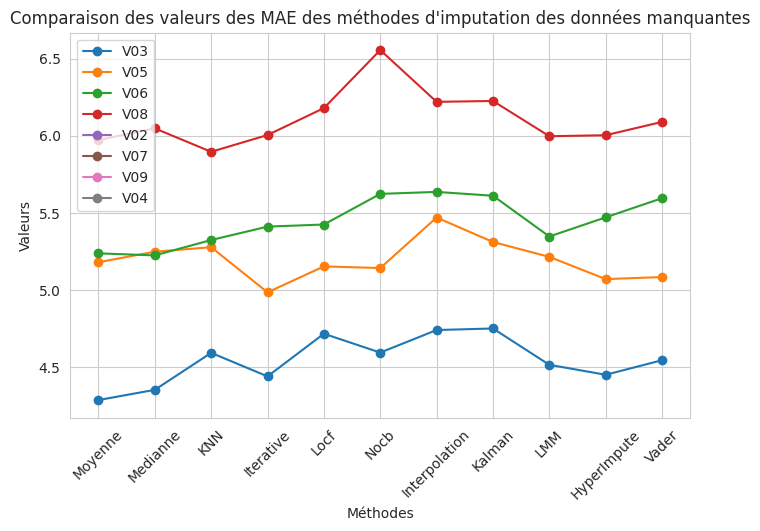

In [61]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
plotdata = pd.DataFrame({
    "Moyenne": dict_simpleImputer_mae,
    "Medianne": dict_simpleImputer_median_mae,
    "KNN": dict_KNNImputer_mae,
    "Iterative": dict_IterativeImputer_mae,
    "Locf": dict_locf_mae,
    "Nocb": dict_nocb_mae,
    "Interpolation": dict_interpolate_mae,
    "Kalman": dict_kalman_maesecond,
    "LMM": dict_lmm_mae,
    "HyperImpute": dict_hi_mae,
    "Vader": dict_vader_mae
}).T

plt.figure(figsize=(8, 5))
sns.set_style("whitegrid")
for col in plotdata.columns:
    plt.plot(plotdata.index, plotdata[col], marker='o', label=col)
plt.xlabel("Méthodes")
plt.ylabel("Valeurs")
plt.xticks(rotation=45)
plt.title("Comparaison des valeurs des MAE des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.show()

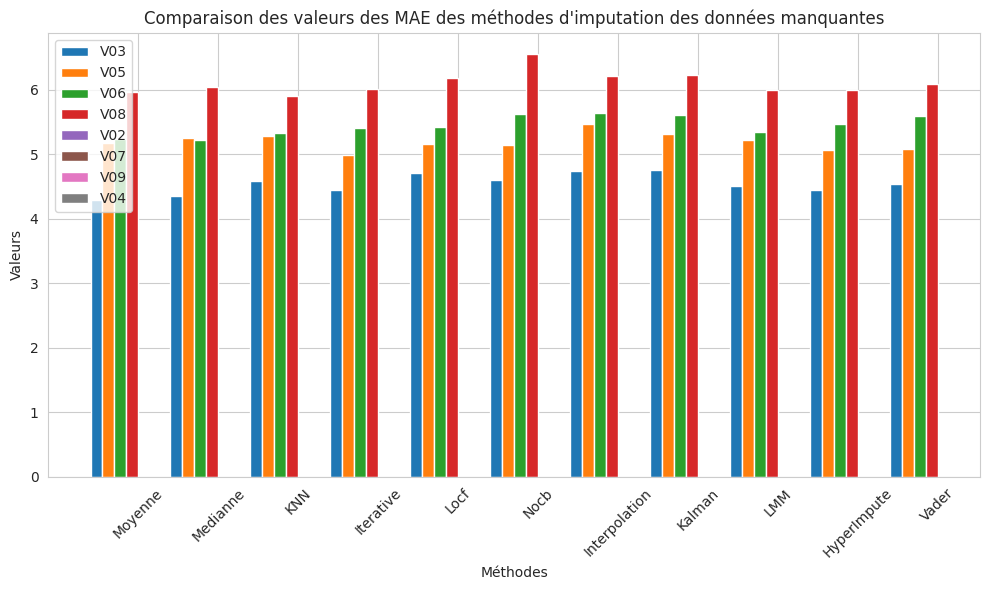

In [62]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.set_style("whitegrid")
n = len(plotdata.columns)
x = np.arange(len(plotdata.index))
bar_width = 0.15

for i, col in enumerate(plotdata.columns):
    plt.bar(x + i * bar_width, plotdata[col], width=bar_width, label=col)

plt.xticks(x + (n - 1) * bar_width / 2, plotdata.index, rotation=45)

plt.xlabel("Méthodes")
plt.ylabel("Valeurs")
plt.title("Comparaison des valeurs des MAE des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


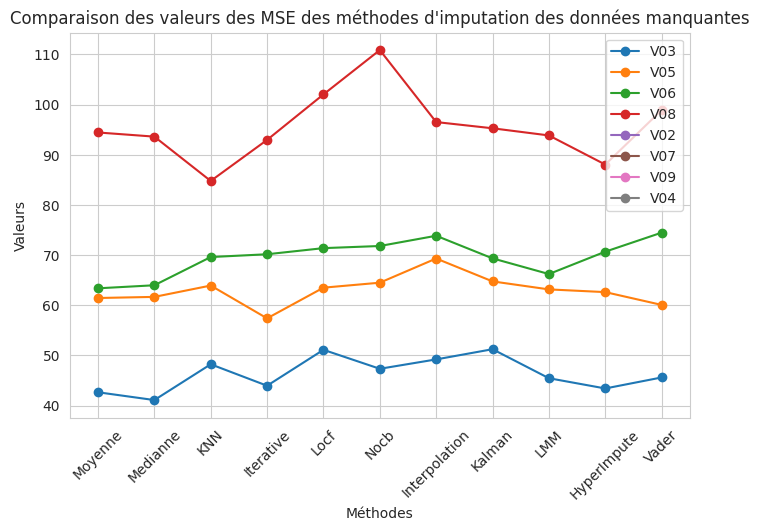

In [63]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
plotdata2 = pd.DataFrame({
    "Moyenne": dict_simpleImputer_mse,
    "Medianne": dict_simpleImputer_median_mse,
    "KNN": dict_KNNImputer_mse,
    "Iterative": dict_IterativeImputer_mse,
    "Locf": dict_locf_mse,
    "Nocb": dict_nocb_mse,
    "Interpolation": dict_interpolate_mse,
    "Kalman": dict_kalman_msesecond,
    "LMM": dict_lmm_mse,
    "HyperImpute": dict_hi_mse,
    "Vader": dict_vader_mse
}).T

plt.figure(figsize=(8, 5))
sns.set_style("whitegrid")
for col in plotdata2.columns:
    plt.plot(plotdata2.index, plotdata2[col], marker='o', label=col)
plt.xlabel("Méthodes")
plt.ylabel("Valeurs")
plt.xticks(rotation=45)
plt.title("Comparaison des valeurs des MSE des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.show()

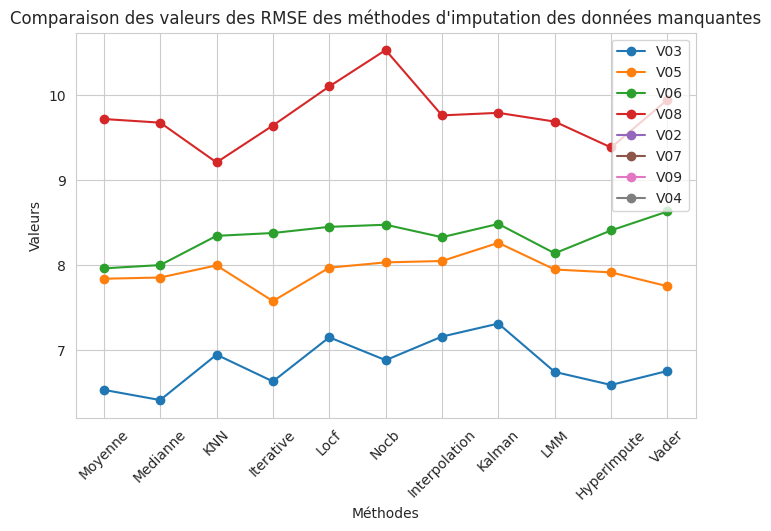

In [64]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
plotdata3 = pd.DataFrame({
    "Moyenne": dict_simpleImputer_rmse,
    "Medianne": dict_simpleImputer_median_rmse,
    "KNN": dict_KNNImputer_rmse,
    "Iterative": dict_IterativeImputer_rmse,
    "Locf": dict_locf_rmse,
    "Nocb": dict_nocb_rmse,
    "Interpolation": dict_kalman_rmsesecond,
    "Kalman": dict_kalman_rmse,
    "LMM": dict_lmm_rmse,
    "HyperImpute": dict_hi_rmse,
    "Vader": dict_vader_rmse
}).T

plt.figure(figsize=(8, 5))
sns.set_style("whitegrid")
for col in plotdata3.columns:
    plt.plot(plotdata3.index, plotdata3[col], marker='o', label=col)
plt.xlabel("Méthodes")
plt.ylabel("Valeurs")
plt.xticks(rotation=45)
plt.title("Comparaison des valeurs des RMSE des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.show()

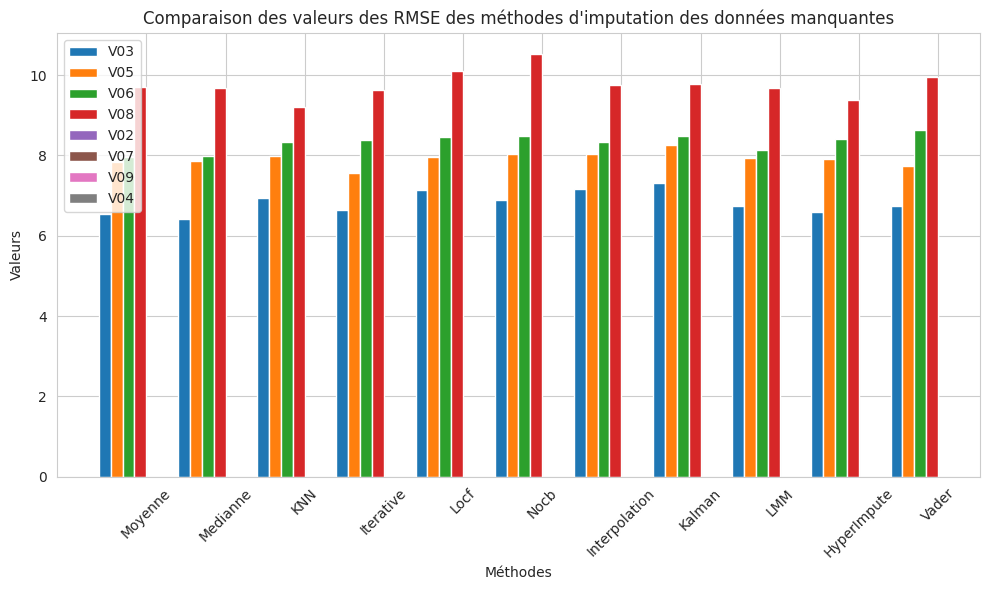

In [65]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.set_style("whitegrid")
n = len(plotdata3.columns)
x = np.arange(len(plotdata3.index))
bar_width = 0.15

for i, col in enumerate(plotdata3.columns):
    plt.bar(x + i * bar_width, plotdata3[col], width=bar_width, label=col)

plt.xticks(x + (n - 1) * bar_width / 2, plotdata3.index, rotation=45)

plt.xlabel("Méthodes")
plt.ylabel("Valeurs")
plt.title("Comparaison des valeurs des RMSE des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


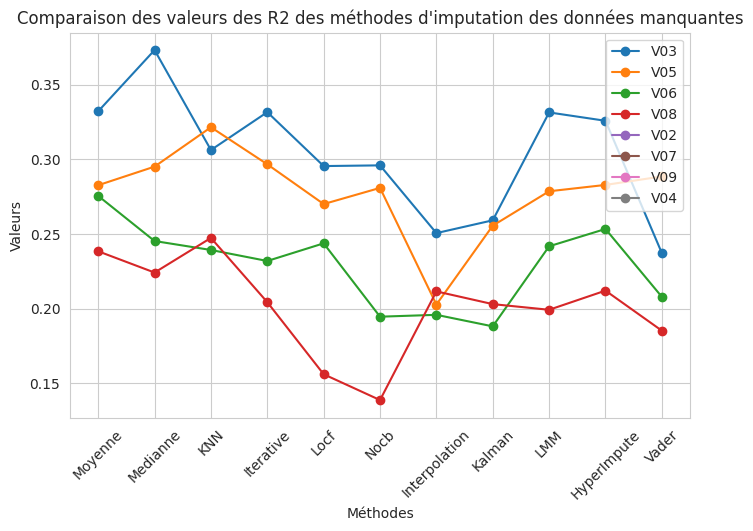

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
plotdata4 = pd.DataFrame({
    "Moyenne": dict_simpleImputer_r2,
    "Medianne": dict_simpleImputer_median_r2,
    "KNN": dict_KNNImputer_r2,
    "Iterative": dict_IterativeImputer_r2,
    "Locf": dict_locf_r2,
    "Nocb": dict_nocb_r2,
    "Interpolation": dict_interpolate_r2,
    "Kalman": dict_kalman_r2second,
    "LMM": dict_lmm_r2,
    "HyperImpute": dict_hi_r2,
    "Vader": dict_vader_r2
}).T

plt.figure(figsize=(8, 5))
sns.set_style("whitegrid")
for col in plotdata4.columns:
    plt.plot(plotdata4.index, plotdata4[col], marker='o', label=col)
plt.xlabel("Méthodes")
plt.xticks(rotation=45)
plt.ylabel("Valeurs")
plt.title("Comparaison des valeurs des R2 des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.show()

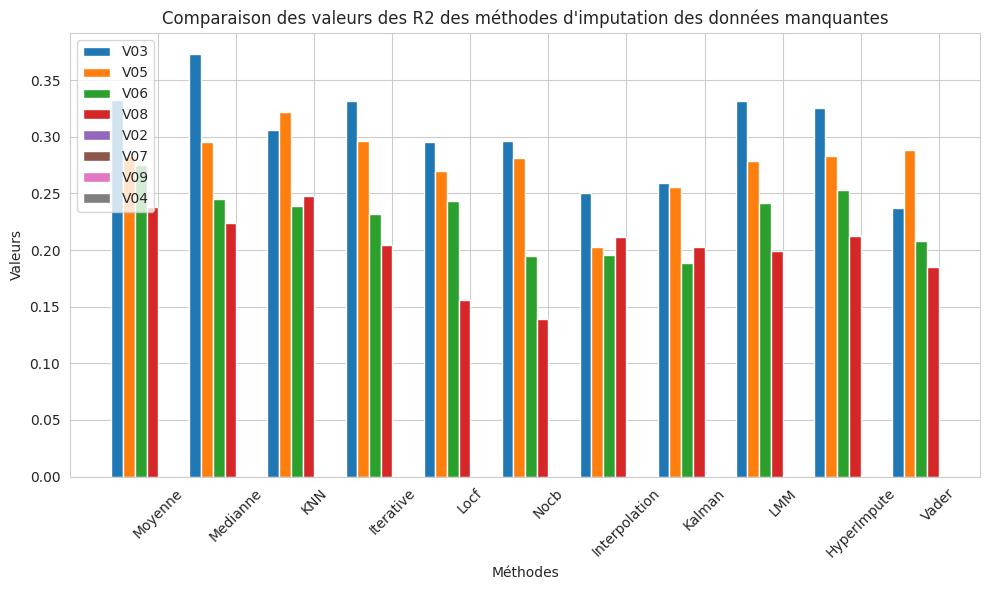

In [67]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.set_style("whitegrid")
n = len(plotdata4.columns)
x = np.arange(len(plotdata4.index))
bar_width = 0.15

for i, col in enumerate(plotdata4.columns):
    plt.bar(x + i * bar_width, plotdata4[col], width=bar_width, label=col)

plt.xticks(x + (n - 1) * bar_width / 2, plotdata4.index, rotation=45)

plt.xlabel("Méthodes")
plt.ylabel("Valeurs")
plt.title("Comparaison des valeurs des R2 des méthodes d'imputation des données manquantes")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


# Metriques D'equite


In [68]:
def ajouter_colonnes_sensibles(df):
    df = df.copy()
    age_cols=[col for col in df.columns if col.startswith("AGE_AT_VISIT_")]
    for col in age_cols:
      suffix=col.split("AGE_AT_VISIT_")[-1]
      df[f'age_group_{suffix}']=df[col].apply(lambda x: 'young' if x < 30 else ('middle' if x < 60 else 'old') if pd.notnull(x) else np.nan)
    edu_cols=[col for col in df.columns if col.startswith("EDUCYRS_")]
    for col in edu_cols:
      suffix=col.split("EDUCYRS_")[-1]
      df[f'edu_group_{suffix}'] = df[col].apply(lambda x: 'low' if x <= 12 else ('middle' if x <= 16 else 'high' if pd.notnull(x) else np.nan))
    if 'BIRTHSEX_SC' in df.columns:
      df['genre']= df['BIRTHSEX_SC'].apply(lambda x: 0 if x<0.5 else 1)
    return df


In [69]:
def ajouter_colonnes_sensibles(df):
    df = df.copy()
    age_cols=[col for col in df.columns if col.startswith("AGE_AT_VISIT_")]
    for col in age_cols:
      suffix=col.split("AGE_AT_VISIT_")[-1]
      df[f'age_group_{suffix}']=df[col].apply(lambda x: 'young' if x < 56.7 else ('middle' if x < 63.4 else 'old') if pd.notnull(x) else np.nan)
    edu_cols=[col for col in df.columns if col.startswith("EDUCYRS_")]
    for col in edu_cols:
      suffix=col.split("EDUCYRS_")[-1]
      df[f'edu_group_{suffix}'] = df[col].apply(lambda x: 'low' if x <= 14 else ('middle' if x <= 16 else 'high' if pd.notnull(x) else np.nan))
    if 'BIRTHSEX_SC' in df.columns:
      df['genre']= df['BIRTHSEX_SC'].apply(lambda x: 0 if x<0.5 else 1)
    return df


In [70]:
ppmi['AGE_AT_VISIT_BL'].describe()



,AGE_AT_VISIT_BL
count,1385.000000
mean,62.688231
std,9.064884
min,26.400000
25%,56.700000
50%,63.400000
75%,69.100000
max,85.200000


In [71]:
ppmi['EDUCYRS_BL'].describe()

,EDUCYRS_BL
count,1383.000000
mean,16.154013
std,3.652031
min,0.000000
25%,14.000000
50%,16.000000
75%,18.000000
max,30.000000


In [72]:
ppmi['BIRTHSEX_SC'].describe()

,BIRTHSEX_SC
count,59.000000
mean,0.423729
std,0.498390
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


In [73]:
ppmi["AGE_AT_VISIT_BL"].mean()

62.68823104693141

In [74]:
ppmi['EDUCYRS_BL'].mean()

16.154013015184383

In [75]:
df_original=ppmi.copy()
df_original=ajouter_colonnes_sensibles(df_original)
df_original.head()

,Unnamed: 0,PATNO,AGE_ASSESS_SDM_BL,AGE_ASSESS_SDM_PW,AGE_ASSESS_SDM_R01,AGE_ASSESS_SDM_R06,AGE_ASSESS_SDM_ST,AGE_ASSESS_SDM_U01,AGE_ASSESS_SDM_V01,AGE_ASSESS_SDM_V03,...,age_group_V17,age_group_V18,age_group_V19,age_group_V20,age_group_V21,edu_group_BL,edu_group_R08,edu_group_R16,edu_group_SC,genre
0,0,3001.0,65.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,old,old,old,old,NaN,middle,NaN,NaN,NaN,1
1,1,3002.0,67.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,old,old,NaN,NaN,NaN,middle,NaN,NaN,NaN,1
2,2,3003.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,old,old,old,old,NaN,middle,NaN,NaN,NaN,1
3,3,3006.0,57.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,low,NaN,NaN,NaN,1
4,4,3007.0,64.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,middle,NaN,NaN,NaN,1


In [76]:
from scipy.stats import ks_2samp

def evaluation_equite_imputation(df_original, df_imputed, col_sensitive, col_val):
    groupes = df_original[col_sensitive].dropna().unique()
    resultats = []

    for grp in groupes:
        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask

        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]

        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)

        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean(),
            'mean_imputed': dist_imputed.mean(),
            'median_original': dist_original.median(),
            'median_imputed': dist_imputed.median(),
            'std_original': dist_original.std(),
            'std_imputed': dist_imputed.std(),
            'ks_stat': ks_stat,
            'ks_pval': ks_pval
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")

    return resultats




In [77]:
for key, value in dict_simpleImputer_imp.items():
    print(f"============== La Visite {key} ==============")
    imputed_mean = ajouter_colonnes_sensibles(value)
    df_original = ppmi.copy()
    df_original = ajouter_colonnes_sensibles(df_original)

    col_sensitive = f'age_group_{key}'
    col_val = 'BIRTHSEX_SC'

    if col_sensitive not in imputed_mean.columns or col_val not in imputed_mean.columns:
        print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
    else:
        res = evaluation_equite_imputation(df_original, imputed_mean, col_sensitive=col_sensitive, col_val=col_val)
        for ligne in res:
            print(ligne)


============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes middle et young (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': 0.4489795918367346, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 1.669115096937996e-15, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.44897959183673447, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 2.2334693049058e-16, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.4489795918367346, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 3.3491216753219436e-16, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V05 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes young et middle (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.44897959183673464, 'median_original': 0.0, 'median_imputed': 0.4489795918367347, 'std_original': 0.0, 'std_imputed': 4.944749670591248e-15, 'ks_stat': 1.0, 'ks_pval': 1.1788768839926214e-05}
{'groupe': 'young', 'n_missing': 217, 'mean_original': nan, 'mean_imputed': 0.44897959183673464, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 1.6135455256712188e-15, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': 0.4489795918367347, 'median_original': 1.0, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 1.779863963919013e-15, 'ks_stat': 1.0, 'ks_pval': 0.007843137254901957}
============== L

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes middle et young (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.44897959183673475, 'median_original': 0.0, 'median_imputed': 0.4489795918367347, 'std_original': 0.5, 'std_imputed': 5.388936366196687e-15, 'ks_stat': 0.625, 'ks_pval': 2.1261248904050805e-06}
{'groupe': 'middle', 'n_missing': 256, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.4489795918367347, 'median_original': 0.0, 'median_imputed': 0.4489795918367347, 'std_original': 0.5773502691896258, 'std_imputed': 1.779836483948286e-15, 'ks_stat': 0.6666666666666666, 'ks_pval': 0.07679872434193308}
{'groupe': 'young', 'n_missing': 213, 'mean_original': nan, 'mean_imputed': 0.44897959183673464, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 1.6136156721999195e-15, 

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


In [78]:
for key,value in dict_simpleImputer_median_imp.items():
  print(f"============== La Visite {key} ==============")
  imputed_median = ajouter_colonnes_sensibles(value)
  df_original = ppmi.copy()
  df_original = ajouter_colonnes_sensibles(df_original)

  col_sensitive = f'age_group_{key}'
  col_val = 'BIRTHSEX_SC'

  if col_sensitive not in imputed_median.columns or col_val not in imputed_median.columns:
      print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
  else:
      res = evaluation_equite_imputation(df_original, imputed_median, col_sensitive=col_sensitive, col_val=col_val)
      for ligne in res:
          print(ligne)

============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes middle et young (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V05 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes young et middle (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.0, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.0, 'std_imputed': 0.0, 'ks_stat': 0.0, 'ks_pval': 1.0}
{'groupe': 'young', 'n_missing': 217, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': 0.0, 'median_original': 1.0, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': 1.0, 'ks_pval': 0.007843137254901957}
============== La Visite V06 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes middle et young (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.0, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.5, 'std_imputed': 0.0, 'ks_stat': 0.375, 'ks_pval': 0.017705931592104415}
{'groupe': 'middle', 'n_missing': 256, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.0, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.5773502691896258, 'std_imputed': 0.0, 'ks_stat': 0.3333333333333333, 'ks_pval': 0.7854367029102349}
{'groupe': 'young', 'n_missing': 213, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V08 ==============
Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différen

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


In [79]:
for key,value in dict_KNNImputer_imp.items():
  print(f"============== La Visite {key} ==============")
  imputed_KNN = ajouter_colonnes_sensibles(value)
  df_original = ppmi.copy()
  df_original = ajouter_colonnes_sensibles(df_original)

  col_sensitive = f'age_group_{key}'
  col_val = 'BIRTHSEX_SC'

  if col_sensitive not in imputed_KNN.columns or col_val not in imputed_KNN.columns:
      print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
  else:
      res = evaluation_equite_imputation(df_original, imputed_KNN, col_sensitive=col_sensitive, col_val=col_val)
      for ligne in res:
          print(ligne)

============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0100
Différence entre groupes old et young (moyenne imputée) : 0.0390
Différence entre groupes middle et young (moyenne imputée) : 0.0291
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': 0.3411764705882353, 'median_original': nan, 'median_imputed': 0.4, 'std_original': nan, 'std_imputed': 0.10944683469917446, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.3511627906976743, 'median_original': nan, 'median_imputed': 0.4, 'std_original': nan, 'std_imputed': 0.11034084737384973, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.38021978021978015, 'median_original': nan, 'median_imputed': 0.4, 'std_original': nan, 'std_imputed': 0.06703196620482275, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V05 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et young (moyenne imputée) : 0.0007
Différence entre groupes old et middle (moyenne imputée) : 0.0110
Différence entre groupes young et middle (moyenne imputée) : 0.0117
{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.2850258175559381, 'median_original': 0.0, 'median_imputed': 0.2, 'std_original': 0.0, 'std_imputed': 0.12811447341273272, 'ks_stat': 0.955249569707401, 'ks_pval': 0.0044561546214920995}
{'groupe': 'young', 'n_missing': 217, 'mean_original': nan, 'mean_imputed': 0.28571428571428575, 'median_original': nan, 'median_imputed': 0.2, 'std_original': nan, 'std_imputed': 0.1255674948670866, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': 0.27401574803149603, 'median_original': 1.0, 'median_imputed': 0.2, 'std_original': nan, 'std_imputed': 0.11331344364157565, 'ks_stat': 1.0, 'ks_pval': 0.007843137254901957}
============== La Visite V06 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0098
Différence entre groupes old et young (moyenne imputée) : 0.0083
Différence entre groupes middle et young (moyenne imputée) : 0.0181
{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.29499192245557354, 'median_original': 0.0, 'median_imputed': 0.2, 'std_original': 0.5, 'std_imputed': 0.11996813870182306, 'ks_stat': 0.6153069466882067, 'ks_pval': 3.392079010654098e-06}
{'groupe': 'middle', 'n_missing': 256, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.28515625000000006, 'median_original': 0.0, 'median_imputed': 0.2, 'std_original': 0.5773502691896258, 'std_imputed': 0.11103071028977071, 'ks_stat': 0.6627604166666666, 'ks_pval': 0.07971046139537674}
{'groupe': 'young', 'n_missing': 213, 'mean_original': nan, 'mean_imputed': 0.3032863849765259, 'median_original': nan, 'median_imputed': 0.4, 'std_original': nan, 'std_imputed': 0.10568062268869326, 'ks_stat': nan, 'ks_pval': nan}
========

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


In [ ]:
for key,value in dict_IterativeImputer_imp.items():
  print(f"============== La Visite {key} ==============")
  imputed_iterative = ajouter_colonnes_sensibles(value)
  df_original = ppmi.copy()
  df_original = ajouter_colonnes_sensibles(df_original)

  col_sensitive = f'age_group_{key}'
  col_val = 'BIRTHSEX_SC'

  if col_sensitive not in imputed_iterative.columns or col_val not in imputed_iterative.columns:
      print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
  else:
      res = evaluation_equite_imputation(df_original, imputed_iterative, col_sensitive=col_sensitive, col_val=col_val)
      for ligne in res:
          print(ligne)

In [81]:
for key, value in dict_hi_imp.items():
  print(f"============== La Visite {key} ==============")
  if value is not None: # Check if value is not None before processing
    imputed_hi = ajouter_colonnes_sensibles(value)
    df_original = ppmi.copy()
    df_original = ajouter_colonnes_sensibles(df_original)

    col_sensitive = f'age_group_{key}'
    col_val = 'BIRTHSEX_SC'

    if col_sensitive not in imputed_hi.columns or col_val not in imputed_hi.columns:
        print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
    else:
        res = evaluation_equite_imputation(df_original, imputed_hi, col_sensitive=col_sensitive, col_val=col_val)
        for ligne in res:
            print(ligne)
  else:
    print(f"Skipping imputation for visit {key} as data is None.") # Print a message if value is None

============== La Visite V02 ==============
Skipping imputation for visit V02 as data is None.
============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': 0.0051813471502590676, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.07198157507486953, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.0, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.0, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V05 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.02127659574468085, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.0, 'std_imputed': 0.14449717168205573, 'ks_stat': 0.02127659574468085, 'ks_pval': 1.0}
{'groupe': 'young', 'n_missing': 217, 'mean_original': nan, 'mean_imputed': 0.014084507042253521, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.11825657242363515, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': 0.005847953216374269, 'median_original': 1.0, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.07647191129018702, 'ks_stat': 0.9941520467836257, 'ks_pval': 0.023255813953488372}
============== La Visite V06 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.03956043956043956, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.5, 'std_imputed': 0.1951386725260393, 'ks_stat': 0.3354395604395604, 'ks_pval': 0.04699402187968201}
{'groupe': 'middle', 'n_missing': 256, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.03571428571428571, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.5773502691896258, 'std_imputed': 0.18605210188381294, 'ks_stat': 0.2976190476190476, 'ks_pval': 0.8974637840796039}
{'groupe': 'young', 'n_missing': 213, 'mean_original': nan, 'mean_imputed': 0.023529411764705882, 'median_original': nan, 'median_imputed': 0.0, 'std_original': nan, 'std_imputed': 0.15202542517309492, 'ks_stat': nan, 'ks_pval': nan}
==========

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


here

In [82]:
res_hi_ks_stat_dict = {}

for key, value in dict_hi_imp.items():
    print(f"============== La Visite {key} ==============")
    if value is not None:
        imputed_hi = ajouter_colonnes_sensibles(value)
        df_original = ppmi.copy()
        df_original = ajouter_colonnes_sensibles(df_original)

        col_sensitive = 'genre'
        col_val = 'AGE_AT_VISIT_V01'

        if col_sensitive not in imputed_hi.columns or col_val not in imputed_hi.columns:
            print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
        else:
            res = evaluation_equite_imputation(df_original, imputed_hi, col_sensitive=col_sensitive, col_val=col_val)
            res_hi_ks_stat_dict[key] = res  # Stocke le résultat dans le dictionnaire
            for ligne in res:
                print(ligne)
    else:
        print(f"Skipping imputation for visit {key} as data is None.")


============== La Visite V02 ==============
Skipping imputation for visit V02 as data is None.
============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes 1 et 0 (moyenne imputée) : nan
{'groupe': 1, 'n_missing': 930, 'mean_original': 62.922717149220496, 'mean_imputed': 62.46955329233955, 'median_original': 63.8, 'median_imputed': 63.149216084227454, 'std_original': 9.446974700584184, 'std_imputed': 8.381653844111296, 'ks_stat': 0.07346940364757737, 'ks_pval': 0.1240870450998155}
{'groupe': 0, 'n_missing': 34, 'mean_original': nan, 'mean_imputed': nan, 'median_original': nan, 'median_imputed': nan, 'std_original': nan, 'std_imputed': nan, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V05 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes 1 et 0 (moyenne imputée) : nan
{'groupe': 1, 'n_missing': 930, 'mean_original': 62.922717149220496, 'mean_imputed': 62.06114839034691, 'median_original': 63.8, 'median_imputed': 62.47936043585345, 'std_original': 9.446974700584184, 'std_imputed': 8.732228967864053, 'ks_stat': 0.09835238528836333, 'ks_pval': 0.03794770090460822}
{'groupe': 0, 'n_missing': 34, 'mean_original': nan, 'mean_imputed': nan, 'median_original': nan, 'median_imputed': nan, 'std_original': nan, 'std_imputed': nan, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V06 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes 1 et 0 (moyenne imputée) : 4.3716
{'groupe': 1, 'n_missing': 930, 'mean_original': 62.922717149220496, 'mean_imputed': 62.00809022838816, 'median_original': 63.8, 'median_imputed': 62.354914679398746, 'std_original': 9.446974700584184, 'std_imputed': 8.365785087368513, 'ks_stat': 0.09893306137755359, 'ks_pval': 0.01883875493937505}
{'groupe': 0, 'n_missing': 34, 'mean_original': nan, 'mean_imputed': 66.37972277054081, 'median_original': nan, 'median_imputed': 66.37972277054081, 'std_original': nan, 'std_imputed': 4.935693903184014, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V07 ==============
Skipping imputation for visit V07 as data is None.
============== La Visite V08 ==============
Différence entre groupes 1 et 0 (moyenne imputée) : nan
{'groupe': 1, 'n_missing': 930, 'mean_original': 62.922717149220496, 'mean_imputed': 61.51036122452102, 'median_original': 63.8, 'median_imputed': 61.89462695802436, 'std_original': 9.446974700584184, 'std_impu

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


In [83]:
for key,value in dict_vader_imp.items():
  print(f"============== La Visite {key} ==============")
  imputed_vader = ajouter_colonnes_sensibles(value)
  df_original = ppmi.copy()
  df_original = ajouter_colonnes_sensibles(df_original)

  col_sensitive = f'age_group_{key}'
  col_val = 'BIRTHSEX_SC'
  if col_sensitive not in imputed_vader.columns or col_val not in imputed_vader.columns:
      print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")
  else:
      res = evaluation_equite_imputation(df_original, imputed_vader, col_sensitive=col_sensitive, col_val=col_val)
      for ligne in res:
          print(ligne)

============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0055
Différence entre groupes old et young (moyenne imputée) : 0.0080
Différence entre groupes middle et young (moyenne imputée) : 0.0025
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': -0.0031176880180265347, 'median_original': nan, 'median_imputed': -0.007410682737827301, 'std_original': nan, 'std_imputed': 0.05668736673147439, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.0023533272845991725, 'median_original': nan, 'median_imputed': 0.008159764111042023, 'std_original': nan, 'std_imputed': 0.05394568765875333, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.0048598097232372866, 'median_original': nan, 'median_imputed': 0.00457720085978508, 'std_original': nan, 'std_imputed': 0.05176633696027993, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V05 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et young (moyenne imputée) : 0.0103
Différence entre groupes old et middle (moyenne imputée) : 0.0016
Différence entre groupes young et middle (moyenne imputée) : 0.0087
{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.0004492193652119284, 'median_original': 0.0, 'median_imputed': 6.862729787826538e-05, 'std_original': 0.0, 'std_imputed': 0.05899846867560032, 'ks_stat': 0.5016077170418006, 'ks_pval': 0.5015974440894557}
{'groupe': 'young', 'n_missing': 217, 'mean_original': nan, 'mean_imputed': -0.009852197320356856, 'median_original': nan, 'median_imputed': -0.014165617525577545, 'std_original': nan, 'std_imputed': 0.061215065132761225, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': -0.0011595004817118516, 'median_original': 1.0, 'median_imputed': 0.0017589852213859558, 'std_original': nan, 'std_imputed': 0.06195686952384898, 'ks_stat': 1.0, 'ks_pval': 0.01342281879194

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0010
Différence entre groupes old et young (moyenne imputée) : 0.0100
Différence entre groupes middle et young (moyenne imputée) : 0.0110
{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': -0.0020126098879366095, 'median_original': 0.0, 'median_imputed': -1.2002885341644287e-05, 'std_original': 0.5, 'std_imputed': 0.08429432151607638, 'ks_stat': 0.5013123359580053, 'ks_pval': 0.00043351546207724874}
{'groupe': 'middle', 'n_missing': 256, 'mean_original': 0.3333333333333333, 'mean_imputed': -0.0030591550527671197, 'median_original': 0.0, 'median_imputed': -0.00476345419883728, 'std_original': 0.5773502691896258, 'std_imputed': 0.06816631981882232, 'ks_stat': 0.5307262569832403, 'ks_pval': 0.2769918847266916}
{'groupe': 'young', 'n_missing': 213, 'mean_original': nan, 'mean_imputed': 0.007988936424055355, 'median_original': nan, 'median_imputed': -0.002253614366054535, 'std_original': nan, 'std_imputed'

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


In [84]:
for key,value in dict_llm_imp.items():
  print(f"============== La Visite {key} ==============")
  imputed_llm = ajouter_colonnes_sensibles(value)
  df_original = ppmi.copy()
  df_original = ajouter_colonnes_sensibles(df_original)

  col_sensitive = f'age_group_{key}'
  col_val = 'BIRTHSEX_SC'
  if col_sensitive not in imputed_llm.columns or col_val not in imputed_llm.columns:
      print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")

  else:
      res = evaluation_equite_imputation(df_original, imputed_llm, col_sensitive=col_sensitive, col_val=col_val)
      for ligne in res:
          print(ligne)

============== La Visite V03 ==============
Différence entre groupes old et middle (moyenne imputée) : 0.0000
Différence entre groupes old et young (moyenne imputée) : 0.0000
Différence entre groupes middle et young (moyenne imputée) : 0.0000
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': 0.44897959183673464, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 1.16989010410352e-15, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.4489795918367347, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 5.602278556055906e-17, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.44897959183673475, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 1.1197530107900952e-16, 'ks_stat': nan, 'ks_pval': nan}
===========

In [85]:
for key,value in dict_lmm_imp.items():
  print(f"============== La Visite {key} ==============")
  if value is not None: # Check if value is not None before processing
    imputed_llm = ajouter_colonnes_sensibles(value)
    df_original = ppmi.copy()
    df_original = ajouter_colonnes_sensibles(df_original)

    col_sensitive = f'age_group_{key}'
    col_val = 'BIRTHSEX_SC'
    if col_sensitive not in imputed_llm.columns or col_val not in imputed_llm.columns:
        print(f"Columns {col_sensitive} or {col_val} not found in the DataFrame.")

    else:
        res = evaluation_equite_imputation(df_original, imputed_llm, col_sensitive=col_sensitive, col_val=col_val)
        for ligne in res:
            print(ligne)
  else:
    print(f"Skipping imputation for visit {key} as data is None.") # Print a message if value is None

============== La Visite V02 ==============
Skipping imputation for visit V02 as data is None.
============== La Visite V03 ==============


<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0004
Différence entre groupes old et young (moyenne imputée) : 0.0116
Différence entre groupes middle et young (moyenne imputée) : 0.0112
{'groupe': 'old', 'n_missing': 221, 'mean_original': nan, 'mean_imputed': 0.4088400126890133, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 0.0662687439925624, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 86, 'mean_original': nan, 'mean_imputed': 0.4092517006802721, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 0.06632490416210525, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'young', 'n_missing': 91, 'mean_original': nan, 'mean_imputed': 0.4204081632653061, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 0.05905941291039368, 'ks_stat': nan, 'ks_pval': nan}
============== La Visite V04 ==============
Skipping imputation 

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et young (moyenne imputée) : 0.0043
Différence entre groupes old et middle (moyenne imputée) : 0.0041
Différence entre groupes young et middle (moyenne imputée) : 0.0002
{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.41530069474598347, 'median_original': 0.0, 'median_imputed': 0.4489795918367347, 'std_original': 0.0, 'std_imputed': 0.06239836082352654, 'ks_stat': 1.0, 'ks_pval': 2.806899358623498e-05}
{'groupe': 'young', 'n_missing': 217, 'mean_original': nan, 'mean_imputed': 0.41960333429146307, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 0.059484592790431785, 'ks_stat': nan, 'ks_pval': nan}
{'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': 0.4193579186060388, 'median_original': 1.0, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 0.0596353821089626, 'ks_stat': 1.0, 'ks_pval': 0.011627906976744186}
============== La Visite

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


Différence entre groupes old et middle (moyenne imputée) : 0.0031
Différence entre groupes old et young (moyenne imputée) : 0.0029
Différence entre groupes middle et young (moyenne imputée) : 0.0002
{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.41623682440008963, 'median_original': 0.0, 'median_imputed': 0.4489795918367347, 'std_original': 0.5, 'std_imputed': 0.061760006333175806, 'ks_stat': 0.625, 'ks_pval': 2.4165012190674098e-06}
{'groupe': 'middle', 'n_missing': 256, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.41933569346105787, 'median_original': 0.0, 'median_imputed': 0.4489795918367347, 'std_original': 0.5773502691896258, 'std_imputed': 0.05962982962139349, 'ks_stat': 0.6666666666666666, 'ks_pval': 0.07767958389084326}
{'groupe': 'young', 'n_missing': 213, 'mean_original': nan, 'mean_imputed': 0.4191836734693877, 'median_original': nan, 'median_imputed': 0.4489795918367347, 'std_original': nan, 'std_imputed': 0.059767883903270744, 'ks_s

<ipython-input-76-531f7db0a606>:17: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)


J'ai la formule suivante pour une metrique d'equite:Statistical Parity Difference
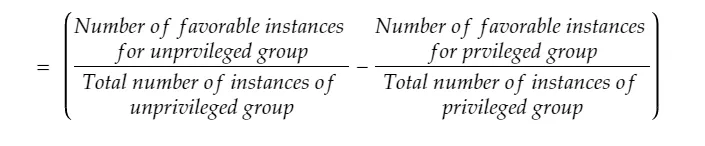

lien:https://transformernlp.medium.com/ai-fairness-a-brief-introduction-to-ai-fairness-360-b2e39c96ca49

In [86]:
def statistical_parity_difference(df, protected_characteristic, target, privileged_group, unprivileged_group, favourable_threshold):
    """
    Calculates the statistical parity difference.
    :param df: the dataframe that you are using, needs to be a pandas df
    :protected_characteristic: the characteristic we are differentiating between (i.e. Gender)
    :target: the target variable (i.e. salary)
    :param privileged_group: the group that is privileged
    :param unprivileged_group: group that is unprivileged
    :param favourable_threshold: amount that labels someone as being treated favourably (we are dealing with salary so that is why we are talking about treating someone favourably)

    Statistical parity is calculated using the formula: (number of favorable instances for unprivileged group/total number of instances of unprivileged group) - (number of favorable instances for privileged group/total number of instances of privileged group)
    """

    # Check if columns exist in the DataFrame
    if protected_characteristic not in df.columns or target not in df.columns:
        print(f"Warning: Columns {protected_characteristic} or {target} not found in DataFrame. Skipping calculation.")
        return np.nan  # Return NaN if columns are missing

    number_of_favourable_instances_for_unprivileged_group = df.query(f'{target} >= {favourable_threshold} & {protected_characteristic} == {unprivileged_group}').shape[0]
    total_number_of_instances_of_unprivileged_group = df.query(f'{protected_characteristic} == {unprivileged_group}').shape[0]

    number_of_favourable_instances_for_privileged_group = df.query(f'{target} >= {favourable_threshold} & {protected_characteristic} == {privileged_group}').shape[0]
    total_number_of_instances_of_privileged_group = df.query(f'{protected_characteristic} == {privileged_group}').shape[0]

    return (number_of_favourable_instances_for_unprivileged_group/total_number_of_instances_of_unprivileged_group) - (number_of_favourable_instances_for_privileged_group /total_number_of_instances_of_privileged_group)

In [87]:
for key, value in dict_simpleImputer_imp.items():
  imputed_simple=ajouter_colonnes_sensibles(value)
  print(statistical_parity_difference(imputed_simple, 'genre', 'AGE_AT_VISIT_V01',0, 1, 60)) # Pass column names as strings

0.11239193083573484
0.11239193083573484
0.11239193083573484
0.11239193083573484


In [88]:
for key,value in dict_simpleImputer_median_imp.items():
  imputed_simple_median=ajouter_colonnes_sensibles(value)
  print(statistical_parity_difference(imputed_simple_median, 'genre', 'AGE_AT_VISIT_V01',0, 1, 60))

0.11239193083573484
0.11239193083573484
0.11239193083573484
0.11239193083573484


In [89]:
for key,value in dict_KNNImputer_imp.items():
  imputed_knn=ajouter_colonnes_sensibles(value)
  print(statistical_parity_difference(imputed_knn, 'genre', 'AGE_AT_VISIT_V01',0, 1, 60)) # Pass column names as strings

0.13108614232209737
0.13108614232209737
0.13108614232209737
0.13108614232209737


In [90]:
for key, value in dict_IterativeImputer_imp.items():
  # Check if columns exist before calling the function
    imputed_iterative=ajouter_colonnes_sensibles(value)
    print(statistical_parity_difference(imputed_iterative, 'genre', 'AGE_AT_VISIT_V01',0, 1, 60)) # Pass column names as strings


0.2913623441941833
0.2913623441941833
0.2913623441941833
0.2913623441941833


In [91]:
result_spd_hi_dict = {}

for key, value in dict_hi_imp.items():
    if value is not None:
        imputed_hi = ajouter_colonnes_sensibles(value)
        result_spd_hi = statistical_parity_difference(imputed_hi, 'genre', 'AGE_AT_VISIT_V01', 0, 1, 60)
        result_spd_hi_dict[key] = result_spd_hi
        print(f"Résultat SPD pour la visite {key} : {result_spd_hi}")
    else:
        print(f"Value for {key} is None. Skipping calculation.")


Value for V02 is None. Skipping calculation.
Résultat SPD pour la visite V03 : 0.17849398777843484
Résultat SPD pour la visite V05 : 0.19177732379979573
Résultat SPD pour la visite V06 : 0.07300765663754993
Value for V07 is None. Skipping calculation.
Résultat SPD pour la visite V08 : 0.24135338345864654
Value for V09 is None. Skipping calculation.


In [92]:
for key,value in dict_llm_imp.items():
  imputed_llm=ajouter_colonnes_sensibles(value)
  print(statistical_parity_difference(imputed_llm, 'genre', 'AGE_AT_VISIT_V01',0, 1, 60))

-0.01567867180181126
-0.022036838381302326
-0.016570489547903855
-0.0339943055738503


Disparate impact est egale a

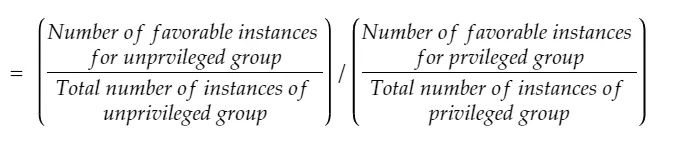

In [93]:
def disparate_impact(df, protected_characteristic, target, privileged_group, unprivileged_group, favourable_threshold):
    """
    Calculates the disparate impact.
    :param df: the dataframe that you are using, needs to be a pandas df
    :protected_characteristic: the characteristic we are differentiating between (i.e. Gender)
    :target: the target variable (i.e. salary)
    :param privileged_group: the group that is privileged
    :param unprivileged_group: group that is unprivileged
    :param favourable_threshold: amount that labels someone as being treated favourably (we are dealing with salary so that is why we are talking about treating someone favourably)

    Disparate impact is calculated using the formula: (number of favorable instances for unprivileged group/total number of instances of unprivileged group) / (number of favorable instances for privileged group/total number of instances of privileged group)
    """
    number_of_favourable_instances_for_unprivileged_group = df.query(f'{target} >= {favourable_threshold} & {protected_characteristic} == {unprivileged_group}').shape[0]
    total_number_of_instances_of_unprivileged_group = df.query(f'{protected_characteristic} == {unprivileged_group}').shape[0]

    number_of_favourable_instances_for_privileged_group = df.query(f'{target} >= {favourable_threshold} & {protected_characteristic} == {privileged_group}').shape[0]
    total_number_of_instances_of_privileged_group = df.query(f'{protected_characteristic} == {privileged_group}').shape[0]

    if number_of_favourable_instances_for_privileged_group == 0 or total_number_of_instances_of_privileged_group == 0:
        print(f"Warning: Potential for ZeroDivisionError for privileged group calculation. Skipping calculation for {target}.")
        return np.nan

    return (number_of_favourable_instances_for_unprivileged_group/total_number_of_instances_of_unprivileged_group) / (number_of_favourable_instances_for_privileged_group /total_number_of_instances_of_privileged_group)

In [94]:
for key,value in dict_simpleImputer_imp.items():
  imputed_simple=ajouter_colonnes_sensibles(value)
  result=disparate_impact(imputed_simple,'genre','AGE_AT_VISIT_V01',0,1,60)
  print(f"{key} - Disparate Impact: {result}")

V03 - Disparate Impact: 1.1266233766233766
V05 - Disparate Impact: 1.1266233766233766
V06 - Disparate Impact: 1.1266233766233766
V08 - Disparate Impact: 1.1266233766233766


In [95]:
for key,value in dict_simpleImputer_median_imp.items():
  imputed_simple_median=ajouter_colonnes_sensibles(value)
  result=disparate_impact(imputed_simple_median,'genre','AGE_AT_VISIT_V01',0,1,60)
  print(f"{key} - Disparate Impact: {result}")

V03 - Disparate Impact: 1.1266233766233766
V05 - Disparate Impact: 1.1266233766233766
V06 - Disparate Impact: 1.1266233766233766
V08 - Disparate Impact: 1.1266233766233766


In [96]:
for key,value in dict_KNNImputer_imp.items():
  imputed_knn=ajouter_colonnes_sensibles(value)
  result=disparate_impact(imputed_knn,'genre','AGE_AT_VISIT_V01',0,1,60)
  print(f"{key} - Disparate Impact: {result}")

V03 - Disparate Impact: 1.1508620689655171
V05 - Disparate Impact: 1.1508620689655171
V06 - Disparate Impact: 1.1508620689655171
V08 - Disparate Impact: 1.1508620689655171


In [97]:
for key, value in dict_IterativeImputer_imp.items():
    imputed_iterative = ajouter_colonnes_sensibles(value)

    result = disparate_impact(
        imputed_iterative,
        'genre',
        'AGE_AT_VISIT_V01',
        0,
        1,
        60
    )

    print(f"{key} - Disparate Impact: {result}")


V03 - Disparate Impact: 1.4483779781935657
V05 - Disparate Impact: 1.4483779781935657
V06 - Disparate Impact: 1.4483779781935657
V08 - Disparate Impact: 1.4483779781935657


In [98]:
result_di_hi_dict = {}

for key, value in dict_hi_imp.items():
    if value is not None:
        imputed_hi = ajouter_colonnes_sensibles(value)
        result_di_hi = disparate_impact(imputed_hi, 'genre', 'AGE_AT_VISIT_V01', 0, 1, 60)
        result_di_hi_dict[key] = result_di_hi
        print(f"{key} - Disparate Impact: {result_di_hi}")
    else:
        print(f"Value for {key} is None. Skipping calculation.")


Value for V02 is None. Skipping calculation.
V03 - Disparate Impact: 1.27627765064836
V05 - Disparate Impact: 1.3061557276803915
V06 - Disparate Impact: 1.1170065675769099
Value for V07 is None. Skipping calculation.
V08 - Disparate Impact: 1.3919413919413919
Value for V09 is None. Skipping calculation.


In [99]:
for key,value in dict_llm_imp.items():
  imputed_llm=ajouter_colonnes_sensibles(value)
  result=disparate_impact(imputed_llm,'genre','AGE_AT_VISIT_V01',0,1,60)
  print(f"{key} - Disparate Impact: {result}")

V03 - Disparate Impact: 0.9820084806497849
V05 - Disparate Impact: 0.9731499763619679
V06 - Disparate Impact: 0.9803619630790413
V08 - Disparate Impact: 0.9592997864906831


In [100]:
def conditional_demographic_disparity(df, protected_characteristic, target, privileged_group, unprivileged_group, favourable_threshold, conditonals:list):
    """
    Calculates the conditional demographic disparity.
    :param df: the dataframe that you are using, needs to be a pandas df
    :param protected_characteristic: the characteristic we are differentiating between (i.e. Gender)
    :param target: the target variable (i.e. salary)
    :param privileged_group: the group that is privileged
    :param unprivileged_group: group that is unprivileged
    :param favourable_threshold: amount that labels someone as being treated favourably (we are dealing with salary so that is why we are talking about treating someone favourably)
    :param conditionals: variables to be conditionalised on (e.g. education or job type)
    :return: conditional demographic disparity
    """
    total_number_of_observations = df.shape[0]
    sub_group_count = 0
    for i in conditonals:
        for j in df[f'{i}'].unique():
            curr_df = df.loc[(df[f'{i}']) == j]
            sub_group_count += statistical_parity_difference(curr_df, protected_characteristic, target, privileged_group, unprivileged_group, favourable_threshold) * curr_df.shape[0]

    return (1/total_number_of_observations) * sub_group_count




In [101]:
for key,value in dict_simpleImputer_imp.items():
  imputed_simple=ajouter_colonnes_sensibles(value)
  result=conditional_demographic_disparity(imputed_simple,'genre','AGE_AT_VISIT_V01',0,1,60,['edu_group_BL'])
  print(f"{key} - Conditional Demographic Disparity: {result}")

V03 - Conditional Demographic Disparity: 0.11208785067007038
V05 - Conditional Demographic Disparity: 0.11208785067007038
V06 - Conditional Demographic Disparity: 0.11208785067007038
V08 - Conditional Demographic Disparity: 0.11208785067007038


In [ ]:
for key,value in dict_simpleImputer_median_imp.items():
  imputed_simple_median=ajouter_colonnes_sensibles(value)
  result=conditional_demographic_disparity(imputed_simple_median,'genre','AGE_AT_VISIT_V01',0,1,60,['edu_group_BL'])
  print(f"{key} - Conditional Demographic Disparity: {result}")

In [103]:
for key,value in dict_KNNImputer_imp.items():
  imputed_knn=ajouter_colonnes_sensibles(value)
  result=conditional_demographic_disparity(imputed_knn,'genre','AGE_AT_VISIT_V01',0,1,60,['edu_group_BL'])
  print(f"{key} - Conditional Demographic Disparity: {result}")

V03 - Conditional Demographic Disparity: 0.130617838622394
V05 - Conditional Demographic Disparity: 0.130617838622394
V06 - Conditional Demographic Disparity: 0.130617838622394
V08 - Conditional Demographic Disparity: 0.130617838622394


In [104]:
result_cdd_hi_dict = {}

for key, value in dict_hi_imp.items():
    if value is not None:
        imputed_hi = ajouter_colonnes_sensibles(value)
        result_cdd_hi = conditional_demographic_disparity(
            imputed_hi, 'genre', 'AGE_AT_VISIT_V01', 0, 1, 60, ['edu_group_BL']
        )
        result_cdd_hi_dict[key] = result_cdd_hi
        print(f"{key} - Conditional Demographic Disparity: {result_cdd_hi}")
    else:
        result_cdd_hi_dict[key] = None
        print(f"{key} - Conditional Demographic Disparity: None")


V02 - Conditional Demographic Disparity: None
V03 - Conditional Demographic Disparity: 0.18899231371653724
V05 - Conditional Demographic Disparity: 0.2237412373882784
V06 - Conditional Demographic Disparity: 0.02755541075482886
V07 - Conditional Demographic Disparity: None
V08 - Conditional Demographic Disparity: 0.25704727219275375
V09 - Conditional Demographic Disparity: None


In [105]:
for key,value in dict_IterativeImputer_imp.items():
  imputed_iterative=ajouter_colonnes_sensibles(value)
  result=conditional_demographic_disparity(imputed_iterative,'genre','AGE_AT_VISIT_V01',0,1,60,['edu_group_BL'])
  print(f"{key} - Conditional Demographic Disparity: {result}")

V03 - Conditional Demographic Disparity: 0.29987328181344297
V05 - Conditional Demographic Disparity: 0.29987328181344297
V06 - Conditional Demographic Disparity: 0.29987328181344297
V08 - Conditional Demographic Disparity: 0.29987328181344297


# Metrique personnelle pour l'equite

## Etude de la ponderation des metriques pour trouver les poids a utiliser

In [163]:
res_hi_ks_stat_dict

{'V03': [{'groupe': 1,
   'n_missing': 930,
   'mean_original': 62.922717149220496,
   'mean_imputed': 62.46955329233955,
   'median_original': 63.8,
   'median_imputed': 63.149216084227454,
   'std_original': 9.446974700584184,
   'std_imputed': 8.381653844111296,
   'ks_stat': 0.07346940364757737,
   'ks_pval': 0.1240870450998155},
  {'groupe': 0,
   'n_missing': 34,
   'mean_original': nan,
   'mean_imputed': nan,
   'median_original': nan,
   'median_imputed': nan,
   'std_original': nan,
   'std_imputed': nan,
   'ks_stat': nan,
   'ks_pval': nan}],
 'V05': [{'groupe': 1,
   'n_missing': 930,
   'mean_original': 62.922717149220496,
   'mean_imputed': 62.06114839034691,
   'median_original': 63.8,
   'median_imputed': 62.47936043585345,
   'std_original': 9.446974700584184,
   'std_imputed': 8.732228967864053,
   'ks_stat': 0.09835238528836333,
   'ks_pval': 0.03794770090460822},
  {'groupe': 0,
   'n_missing': 34,
   'mean_original': nan,
   'mean_imputed': nan,
   'median_origina

In [164]:
result_spd_hi_dict

{'V03': 0.17849398777843484,
 'V05': 0.19177732379979573,
 'V06': 0.07300765663754993,
 'V08': 0.24135338345864654}

In [165]:
result_di_hi_dict

{'V03': 1.27627765064836,
 'V05': 1.3061557276803915,
 'V06': 1.1170065675769099,
 'V08': 1.3919413919413919}

In [166]:
result_cdd_hi_dict

{'V02': None,
 'V03': 0.18899231371653724,
 'V05': 0.2237412373882784,
 'V06': 0.02755541075482886,
 'V07': None,
 'V08': 0.25704727219275375,
 'V09': None}

          spd        di       cdd
spd  1.000000  0.998605  0.987589
di   0.998605  1.000000  0.981864
cdd  0.987589  0.981864  1.000000


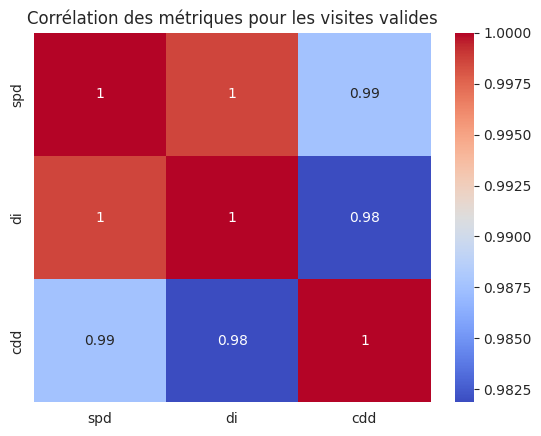

In [167]:
# Trouver les clés communes à tous les dictionnaires
common_keys = set(result_spd_hi_dict.keys()) & set(result_di_hi_dict.keys()) & set(result_cdd_hi_dict.keys()) & set(res_hi_ks_stat_dict.keys())

# Créer le DataFrame uniquement avec ces clés communes
df_cor = pd.DataFrame({
    'visite': list(common_keys),
    'spd': [result_spd_hi_dict[k] for k in common_keys],
    'di': [result_di_hi_dict[k] for k in common_keys],
    'cdd': [result_cdd_hi_dict[k] for k in common_keys]#,
   # 'dist_ks': [res_hi_ks_stat_dict[k] for k in common_keys]
})

# Supprimer les lignes avec des NaN
df_cor = df_cor.dropna()

# Calculer la matrice de corrélation
correlation_matrix = df_cor[['spd', 'di', 'cdd']].corr()
print(correlation_matrix)
# Afficher
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Corrélation des métriques pour les visites valides")
plt.show()


              spd        di       cdd   dist_ks
spd      1.000000  0.998605  0.987589  0.243459
di       0.998605  1.000000  0.981864  0.294275
cdd      0.987589  0.981864  1.000000  0.167072
dist_ks  0.243459  0.294275  0.167072  1.000000


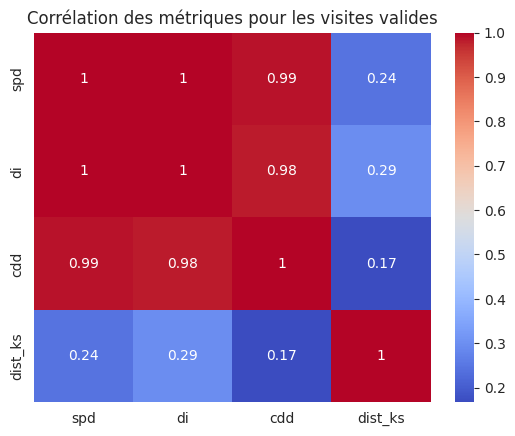

In [168]:
# Extraction des statistiques KS pour le groupe 1 (qui semble avoir des données valides)
res_hi_ks_stat_dict_simplified = {}
for key, value in res_hi_ks_stat_dict.items():
    # Vérifier s'il y a au moins un groupe et si le premier groupe a une valeur ks_stat non-NaN
    if value and len(value) > 0 and value[0].get('ks_stat') is not None and not pd.isna(value[0].get('ks_stat')):
        res_hi_ks_stat_dict_simplified[key] = value[0]['ks_stat']

# Créer le DataFrame avec toutes les métriques
df_cor = pd.DataFrame({
    'visite': list(common_keys),
    'spd': [result_spd_hi_dict.get(k, float('nan')) for k in common_keys],
    'di': [result_di_hi_dict.get(k, float('nan')) for k in common_keys],
    'cdd': [result_cdd_hi_dict.get(k, float('nan')) for k in common_keys],
    'dist_ks': [res_hi_ks_stat_dict_simplified.get(k, float('nan')) for k in common_keys]
})

# Supprimer les lignes avec des NaN
df_cor = df_cor.dropna()

# Calculer la matrice de corrélation
correlation_matrix = df_cor[['spd', 'di', 'cdd', 'dist_ks']].corr()
print(correlation_matrix)
# Afficher
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Corrélation des métriques pour les visites valides")
plt.show()

etre correles peut signifier le choix dun ou de lautre mais aussi l faites que ptt elles calculent la meme chose?

In [169]:
from sklearn.decomposition import PCA

# Appliquer l'ACP aux métriques
pca = PCA()
metrics_matrix = df_cor[['spd', 'di', 'cdd', 'dist_ks']].values
pca.fit(metrics_matrix)

# Examiner la variance expliquée par chaque composante
print("Variance expliquée:", pca.explained_variance_ratio_)

# Transformer les données en composantes principales
transformed_metrics = pca.transform(metrics_matrix)
print("Coefficients de la première composante:", pca.components_[0])

Variance expliquée: [9.82929663e-01 1.40749800e-02 2.99535687e-03 1.67375970e-31]
Coefficients de la première composante: [0.42002601 0.68042083 0.60001327 0.02428407]


métrique_composite = (0.685*DI + 0.564*CDD + 0.400*SPD + 0.230*KS) / (0.685 + 0.564 + 0.400 + 0.230)

Mais PCA change avec le changement de donnees, on a donc besoin de choisir une approche qui optimise au mieux les poids

## Optimisateurs de poids: GridSearch, Random Search et Approche Bayesinne
    Celle retenu est bayesienne grace a son score eleve et sa combinaison equitable entre metriques

In [170]:
from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance

def metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,
                            conditionnels=None, favourable_threshold=None,
                            poids={'spd': 0.351 , 'di': 0.187, 'cdd': 0.461, 'dist': 0.001},
                            alpha=0.7, visualiser=True, longitudinal=True, coeff_R =None ):


    coef_R=coeff_R
    if abs(sum(poids.values()) - 1) > 1e-10:
        raise ValueError("La somme des poids doit être égale à 1")


    if favourable_threshold is None:
        favourable_threshold = df_original[col_val].dropna().median()

    groupes = df_original[col_sensitive].dropna().unique()
    if len(groupes) < 2:
        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l'équité")


    resultats = []
    counts = df_original[col_sensitive].value_counts()
    nb_categorie=counts.shape[0]
    if nb_categorie==2:
        privileged_group=counts.idxmax()
        unprivileged_group=counts.idxmin()
    elif nb_categorie>2:
        privileged_group=counts.idxmax()
        unprivileged_group = [g for g in groupes if g != privileged_group][0]

    for grp in groupes:

        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask


        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]


        if dist_original.empty:
            dist_original = pd.Series([0])
        if dist_imputed.empty:
            dist_imputed = pd.Series([0])


        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
        w_distance = wasserstein_distance(dist_original, dist_imputed)

        prop_favorable_orig = (df_original[col_val] >= favourable_threshold).mean()
        prop_favorable_imp = (df_imputed[col_val] >= favourable_threshold).mean()
        prop_favorable_imp_priv = (df_imputed.loc[mask, col_val] >= favourable_threshold).mean()
        prop_favorable_imp_unpriv = (df_imputed.loc[missing_mask, col_val] >= favourable_threshold).mean()
        prop_favorable_orig_priv = (df_original.loc[mask, col_val] >= favourable_threshold).mean()
        prop_favorable_orig_unpriv = (df_original.loc[missing_mask, col_val] >= favourable_threshold).mean()


        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean(),
            'mean_imputed': dist_imputed.mean(),
            'median_original': dist_original.median(),
            'median_imputed': dist_imputed.median(),
            'std_original': dist_original.std(),
            'std_imputed': dist_imputed.std(),
            'ks_stat': ks_stat,
            'ks_pval': ks_pval,
            'wasserstein_dist': w_distance,
            'prop_favorable_orig': prop_favorable_orig,
            'prop_favorable_imp': prop_favorable_imp,
            'priviliged_group':privileged_group,
            'unpriviliged_group':unprivileged_group,


            #'dist_original': dist_original,
            #'dist_imputed': dist_imputed
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")


    #comparaison:
    comparaison=[]
    for i in range(len(resultats)):
        for j in range(i + 1, len(resultats)):
          grp1=resultats[i]
          grp2=resultats[j]
          privileged_group=grp1['priviliged_group']
          unprivileged_group=grp1['unpriviliged_group']
          resultat_privileged = next((r for r in resultats if r['groupe'] == privileged_group), None)
          resultat_unprivileged = next((r for r in resultats if r['groupe'] == unprivileged_group), None)

          if not resultat_privileged or not resultat_unprivileged:
              print("Avertissement: Données manquantes pour l'un des groupes privilégié/non privilégié")
              return {'resultats': resultats, 'score_global': 0}


          #statistical parity difference
          spd_imputed  = resultat_unprivileged['prop_favorable_imp'] - resultat_privileged['prop_favorable_imp']
          print("prop_unpriv:", resultat_unprivileged['prop_favorable_imp'],
          "prop_priv:", resultat_privileged['prop_favorable_imp'],
          "SPD:", spd_imputed)

          #disparate impact

          if resultat_privileged['prop_favorable_imp'] > 0:
              di_imputed = resultat_unprivileged['prop_favorable_imp'] / resultat_privileged['prop_favorable_imp']

          else:
              di_imputed = 1.0
          #denominator = max(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #numerator = min(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #di_imputed = numerator / denominator if denominator > 0 else 1.0

          #conditional demographic disparity
          cdd_imputed = np.nan
          cdd_sum = 0
          total_count = df_original.shape[0]

          if conditionnels:
            for cond in conditionnels:
                for val in df_original[cond].dropna().unique():
                    subset = df_imputed[df_original[cond] == val]


                    prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
                    prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()


                    spd_sub = prop_fav_unpriv - prop_fav_priv
                    cdd_sum += spd_sub * subset.shape[0]

            cdd_imputed = cdd_sum / total_count

          else:
                cdd_imputed=np.nan

          preservation_dist = abs(grp1['ks_stat'] - grp2['ks_stat'])

          comparaison.append({
            'groupe1': grp1['groupe'],
            'groupe2': grp2['groupe'],
            'paire': f"{grp1['groupe']}_vs_{grp2['groupe']}",
            'spd': spd_imputed,
            'di': di_imputed,
            'cdd': cdd_imputed,
            'preservation_dist': preservation_dist
          })

    for comp in comparaison:
        di_norm = abs(1 - comp['di']) if not pd.isna(comp['di']) else 0
        spd_abs = abs(comp['spd']) if not pd.isna(comp['spd']) else 0
        cdd_abs = abs(comp['cdd']) if not pd.isna(comp['cdd']) else 0
        pres_dist_abs = abs(comp['preservation_dist']) if not pd.isna(comp['preservation_dist']) else 0

        spd_vals = [abs(c['spd']) for c in comparaison if not pd.isna(c['spd'])]
        cdd_vals = [abs(c['cdd']) for c in comparaison if not pd.isna(c['cdd'])]
        pres_dist_vals = [abs(c['preservation_dist']) for c in comparaison if not pd.isna(c['preservation_dist'])]
        max_spd = max(spd_vals) if spd_vals else 1
        max_cdd = max(cdd_vals) if cdd_vals else 1
        max_preservation_dist = max(pres_dist_vals) if pres_dist_vals else 1

        spd_norm = spd_abs / max_spd if max_spd > 0 else 0
        cdd_norm = cdd_abs / max_cdd if max_cdd > 0 else 0
        preservation_dist_norm = pres_dist_abs / max_preservation_dist if max_preservation_dist > 0 else 0
        score_inequite = (poids['di']*di_norm + poids['spd']*spd_norm + poids['cdd']*cdd_norm + poids['dist']*preservation_dist_norm)
        comp['score_equite'] = 1 - score_inequite
        comp['score_equite']= comp['score_equite'] * alpha +coef_R * ( 1 - alpha )
    if len(comparaison)==0:
      score_global=0
    else:
      score_global=sum([c['score_equite'] for c in comparaison ])/len(comparaison)

    resultat_final={
        'resultats':resultats,
        'comparaison':comparaison,
        'score_global':score_global
    }
    return resultat_final

In [171]:
import numpy as np
import pandas as pd
from sklearn.model_selection import ParameterGrid
from itertools import product

def optimiser_poids_equite(df_original, df_imputed, col_sensitive, col_val,
                          conditionnels=None, favourable_threshold=None,
                          n_steps=5, cv_folds=5):
    """
     GridSearch pour trouver les poids optimaux pour la métrique d'équité

    Parameters:
    -----------
    df_original, df_imputed, col_sensitive, col_val: Arguments à passer à metrique_equite_globale
    conditionnels, favourable_threshold: Arguments optionnels
    n_steps: Nombre d'étapes pour chaque poids (granularité de la recherche)
    cv_folds: Nombre de folds pour la validation croisée

    Returns:
    --------
    dict: Meilleurs poids trouvés et meilleur score
    """
    # Créer une grille de poids possible (somme = 1)
    step = 1.0 / n_steps
    weights_combinations = []

    # Génération de toutes les combinaisons possibles où la somme = 1
    for spd in np.arange(0, 1 + step, step):
        for di in np.arange(0, 1 + step - spd, step):
            for cdd in np.arange(0, 1 + step - spd - di, step):
                dist = 1 - spd - di - cdd
                if abs(dist - round(dist, 10)) < 1e-10:  # Pour éviter les erreurs d'arrondi
                    weights_combinations.append({
                        'spd': spd,
                        'di': di,
                        'cdd': cdd,
                        'dist': dist
                    })

    print(f"Évaluation de {len(weights_combinations)} combinaisons de poids...")


    resultats_grid = []

    # Tester chaque combinaison de poids
    for weights in weights_combinations:
        result = metrique_equite_globale(
            df_original=df_original,
            df_imputed=df_imputed,
            col_sensitive=col_sensitive,
            col_val=col_val,
            conditionnels=conditionnels,
            favourable_threshold=favourable_threshold,
            poids=weights,
            visualiser=False,
            longitudinal=False,
            coeff_R=r2_mean_hi
        )

        resultats_grid.append({
            'poids': weights,
            'score': result['score_global']
        })

    # Trier pour trouver les meilleurs poids
    resultats_grid.sort(key=lambda x: x['score'], reverse=True)

    # Prendre les 5 meilleurs résultats
    top_results = resultats_grid[:5]

    print("Top 5 combinaisons de poids:")
    for i, res in enumerate(top_results):
        print(f"{i+1}. Poids: {res['poids']}, Score: {res['score']:.4f}")

    return {
        'meilleurs_poids': resultats_grid[0]['poids'],
        'meilleur_score': resultats_grid[0]['score'],
        'tous_resultats': resultats_grid
    }
meilleurs_poids_par_imputeur = {}

for key, value in dict_hi_imp.items():
  if value is not None:
    print(f"\nOptimisation des poids pour l'imputeur {key}...")

    imputed_mean = ajouter_colonnes_sensibles(value)
    df_original = ppmi.copy()
    df_original = ajouter_colonnes_sensibles(df_original)

    col_sensitive = f'age_group_{key}'
    col_val = 'BIRTHSEX_SC'


    resultats_opt = optimiser_poids_equite(
        df_original,
        imputed_mean,
        col_sensitive,
        col_val,
        conditionnels=['edu_group_BL'],
        n_steps=4
    )

    meilleurs_poids = resultats_opt['meilleurs_poids']
    meilleur_score = resultats_opt['meilleur_score']

    meilleurs_poids_par_imputeur[key] = {
        'poids': meilleurs_poids,
        'score': meilleur_score
    }

    print(f"Meilleurs poids pour {key}: {meilleurs_poids}")
    print(f"Score optimal: {meilleur_score:.4f}")
  else:
    print(f"{key} - Score Equité Global: None")

# Afficher un résumé des résultats
resume_resultats = []
for key, results in meilleurs_poids_par_imputeur.items():
    resume_resultats.append({
        'Imputeur': key,
        'Score Équité Global': results['score'],
        'Poids SPD': results['poids']['spd'],
        'Poids DI': results['poids']['di'],
        'Poids CDD': results['poids']['cdd'],
        'Poids Dist': results['poids']['dist']
    })

df_scores_optimises = pd.DataFrame(resume_resultats)
print("\nRésumé des scores avec poids optimisés:")
print(df_scores_optimises)

V02 - Score Equité Global: None

Optimisation des poids pour l'imputeur V03...
Évaluation de 35 combinaisons de poids...
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD:

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Top 5 combinaisons de poids:
1. Poids: {'spd': 0.0, 'di': 0.0, 'cdd': 1.0, 'dist': 0.0}, Score: 0.7806
2. Poids: {'spd': 0.0, 'di': 0.25, 'cdd': 0.75, 'dist': 0.0}, Score: 0.7806
3. Poids: {'spd': 0.0, 'di': 0.5, 'cdd': 0.5, 'dist': 0.0}, Score: 0.7806
4. Poids: {'spd': 0.0, 'di': 0.75, 'cdd': 0.25, 'dist': 0.0}, Score: 0.7806
5. Poids: {'spd': 0.0, 'di': 1.0, 'cdd': 0.0, 'dist': 0.0}, Score: 0.7806
Meilleurs poids pour V03: {'spd': 0.0, 'di': 0.0, 'cdd': 1.0, 'dist': 0.0}
Score optimal: 0.7806

Optimisation des poids pour l'imputeur V05...
Évaluation de 35 combinaisons de poids...
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Top 5 combinaisons de poids:
1. Poids: {'spd': 0.0, 'di': 0.0, 'cdd': 1.0, 'dist': 0.0}, Score: 0.7806
2. Poids: {'spd': 0.0, 'di': 0.25, 'cdd': 0.75, 'dist': 0.0}, Score: 0.7806
3. Poids: {'spd': 0.0, 'di': 0.5, 'cdd': 0.5, 'dist': 0.0}, Score: 0.7806
4. Poids: {'spd': 0.0, 'di': 0.75, 'cdd': 0.25, 'dist': 0.0}, Score: 0.7806
5. Poids: {'spd': 0.0, 'di': 1.0, 'cdd': 0.0, 'dist': 0.0}, Score: 0.7806
Meilleurs poids pour V05: {'spd': 0.0, 'di': 0.0, 'cdd': 1.0, 'dist': 0.0}
Score optimal: 0.7806

Optimisation des poids pour l'imputeur V06...
Évaluation de 35 combinaisons de poids...
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupe

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Évaluation de 35 combinaisons de poids...
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 S

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

In [172]:
import numpy as np
import pandas as pd
from sklearn.model_selection import ParameterGrid
import random

def optimiser_poids_equite_random(df_original, df_imputed, col_sensitive, col_val,
                                conditionnels=None, favourable_threshold=None,
                                n_iterations=100, cv_folds=5):
    """
    RandomSearch pour trouver les poids optimaux pour la métrique d'équité

    Parameters:
    -----------
    df_original, df_imputed, col_sensitive, col_val: Arguments à passer à metrique_equite_globale
    conditionnels, favourable_threshold: Arguments optionnels
    n_iterations: Nombre d'échantillons aléatoires à évaluer
    cv_folds: Nombre de folds pour la validation croisée

    Returns:
    --------
    dict: Meilleurs poids trouvés et meilleur score
    """
    print(f"Évaluation de {n_iterations} combinaisons aléatoires de poids...")

    resultats_random = []

    # Générer n_iterations combinaisons aléatoires où la somme = 1
    for _ in range(n_iterations):
        # Générer 3 nombres aléatoires
        a = random.random()
        b = random.random()
        c = random.random()
        d = random.random()

        # Normaliser pour que la somme = 1
        somme = a + b + c + d
        spd = a / somme
        di = b / somme
        cdd = c / somme
        dist = d / somme

        weights = {
            'spd': spd,
            'di': di,
            'cdd': cdd,
            'dist': dist
        }

        # Tester cette combinaison de poids
        result = metrique_equite_globale(
            df_original=df_original,
            df_imputed=df_imputed,
            col_sensitive=col_sensitive,
            col_val=col_val,
            conditionnels=conditionnels,
            favourable_threshold=favourable_threshold,
            poids=weights,
            visualiser=False,
            longitudinal=False,
            coeff_R=r2_mean_hi
        )

        resultats_random.append({
            'poids': weights,
            'score': result['score_global']
        })

    # Trier pour trouver les meilleurs poids
    resultats_random.sort(key=lambda x: x['score'], reverse=True)

    # Prendre les 5 meilleurs résultats
    top_results = resultats_random[:5]

    print("Top 5 combinaisons de poids:")
    for i, res in enumerate(top_results):
        print(f"{i+1}. Poids: {res['poids']}, Score: {res['score']:.4f}")

    return {
        'meilleurs_poids': resultats_random[0]['poids'],
        'meilleur_score': resultats_random[0]['score'],
        'tous_resultats': resultats_random
    }

# Exemple d'utilisation:
meilleurs_poids_par_imputeur = {}

for key, value in dict_hi_imp.items():
    if value is not None:
        print(f"\nOptimisation des poids pour l'imputeur {key}...")

        imputed_mean = ajouter_colonnes_sensibles(value)
        df_original = ppmi.copy()
        df_original = ajouter_colonnes_sensibles(df_original)

        col_sensitive = f'age_group_{key}'
        col_val = 'BIRTHSEX_SC'

        # Utiliser la version Random Search plutôt que GridSearch
        resultats_opt = optimiser_poids_equite_random(
            df_original,
            imputed_mean,
            col_sensitive,
            col_val,
            conditionnels=['edu_group_BL'],
            n_iterations=100  # Nombre d'échantillons aléatoires
        )

        meilleurs_poids = resultats_opt['meilleurs_poids']
        meilleur_score = resultats_opt['meilleur_score']

        meilleurs_poids_par_imputeur[key] = {
            'poids': meilleurs_poids,
            'score': meilleur_score
        }

        print(f"Meilleurs poids pour {key}: {meilleurs_poids}")
        print(f"Score optimal: {meilleur_score:.4f}")
    else:
        print(f"{key} - Score Equité Global: None")

# Afficher un résumé des résultats
resume_resultats = []
for key, results in meilleurs_poids_par_imputeur.items():
    resume_resultats.append({
        'Imputeur': key,
        'Score Équité Global': results['score'],
        'Poids SPD': results['poids']['spd'],
        'Poids DI': results['poids']['di'],
        'Poids CDD': results['poids']['cdd'],
        'Poids Dist': results['poids']['dist']
    })

df_scores_optimises = pd.DataFrame(resume_resultats)
print("\nRésumé des scores avec poids optimisés:")
print(df_scores_optimises)

V02 - Score Equité Global: None

Optimisation des poids pour l'imputeur V03...
Évaluation de 100 combinaisons aléatoires de poids...
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_pr

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Top 5 combinaisons de poids:
1. Poids: {'spd': 0.36531734076310324, 'di': 0.1921569432520414, 'cdd': 0.44221457768906824, 'dist': 0.00031113829578695887}, Score: 0.7804
2. Poids: {'spd': 0.35501288083562366, 'di': 0.5151733699704271, 'cdd': 0.12825850926026977, 'dist': 0.0015552399336795344}, Score: 0.7798
3. Poids: {'spd': 0.6495358915321697, 'di': 0.26

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Évaluation de 100 combinaisons aléatoires de poids...
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Top 5 combinaisons de poids:
1. Poids: {'spd': 0.2672934934570083, 'di': 0.7021234021772639, 'cdd': 0.023190728842566875, 'dist': 0.00739237552316089}, Score: 0.7771
2. Poids: {'spd': 0.043326433316220825, 'di': 0.8511382386969258, 'cdd': 0.0979584095512303, 'dist': 0.007576918435623064}, Score: 0.7770
3. Poids: {'spd': 0.3537665840456857, 'di': 0.5138656539051271, 'cdd': 0.11989408730586992, 'dist': 0.01247367474331737}, Score: 0.7747
4. Poids: {'spd': 0.5695468955631797, 'di': 0.28433910755321495, 'cdd': 0.12040914664420554, 'dist': 0.02570485023939987}, Score: 0.7686
5. Poids: {'spd': 0.08617205292838677, 'di': 0.4323111417152

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SP

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Top 5 combinaisons de poids:
1. Po

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

In [173]:
import numpy as np
import pandas as pd
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import Matern
from scipy.stats import norm
import random

def optimiser_poids_equite_bayesien(df_original, df_imputed, col_sensitive, col_val,
                                   conditionnels=None, favourable_threshold=None,
                                   n_iterations=50, n_initial=10, xi=0.01):
    """
    Optimisation bayésienne pour trouver les poids optimaux pour la métrique d'équité

    Parameters:
    -----------
    df_original, df_imputed, col_sensitive, col_val: Arguments à passer à metrique_equite_globale
    conditionnels, favourable_threshold: Arguments optionnels
    n_iterations: Nombre total d'itérations
    n_initial: Nombre d'échantillons initiaux aléatoires avant de commencer l'optimisation
    xi: Paramètre d'exploration-exploitation pour l'acquisition

    Returns:
    --------
    dict: Meilleurs poids trouvés et meilleur score
    """
    print(f"Optimisation bayésienne avec {n_iterations} itérations...")

    # Fonction pour normaliser les poids à 1
    def normaliser_poids(w):
        return w / np.sum(w)

    # Fonction qui évalue un ensemble de poids non normalisés
    def evaluer_poids(poids_raw):
        # Convertir en array 1D si ce n'est pas déjà le cas
        if isinstance(poids_raw, list):
            poids_raw = np.array(poids_raw)

        # Normaliser les poids pour que leur somme soit 1
        poids_norm = normaliser_poids(poids_raw)

        # Convertir en dictionnaire
        weights = {
            'spd': poids_norm[0],
            'di': poids_norm[1],
            'cdd': poids_norm[2],
            'dist': poids_norm[3]
        }

        # Évaluer avec la fonction originale
        try:
            result = metrique_equite_globale(
                df_original=df_original,
                df_imputed=df_imputed,
                col_sensitive=col_sensitive,
                col_val=col_val,
                conditionnels=conditionnels,
                favourable_threshold=favourable_threshold,
                poids=weights,
                visualiser=False,
                longitudinal=False,
                coeff_R=r2_mean_hi
            )
            return result['score_global']
        except Exception as e:
            print(f"Erreur lors de l'évaluation: {e}")
            return -1  # Une valeur faible en cas d'erreur

    # Phase 1: Échantillonnage initial aléatoire
    X_samples = []  # Points échantillonnés (poids non normalisés)
    y_samples = []  # Scores correspondants

    print("Phase 1: Échantillonnage initial aléatoire...")

    for _ in range(n_initial):
        # Générer des poids aléatoires non normalisés
        x = np.random.rand(4)
        X_samples.append(x)

        # Évaluer
        y = evaluer_poids(x)
        y_samples.append(y)

    X = np.array(X_samples)
    y = np.array(y_samples)

    # Trouver le meilleur score jusqu'à présent
    best_idx = np.argmax(y)
    best_score = y[best_idx]
    best_x = X[best_idx]

    # Fonction d'acquisition (Expected Improvement)
    def acquisition_ei(X_new, model, y_max, xi=0.01):
        mean, std = model.predict(X_new.reshape(1, -1), return_std=True)
        z = (mean - y_max - xi) / std
        return (mean - y_max - xi) * norm.cdf(z) + std * norm.pdf(z)

    # Phase 2: Optimisation bayésienne
    print("Phase 2: Optimisation bayésienne...")

    for i in range(n_iterations - n_initial):
        # Créer et ajuster le modèle de processus gaussien
        kernel = Matern(nu=2.5)
        model = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10)
        model.fit(X, y)

        # Échantillonner des candidats aléatoires et choisir le meilleur selon l'acquisition
        n_candidates = 1000
        candidates = np.random.rand(n_candidates, 4)

        acq_values = [acquisition_ei(candidate, model, best_score, xi) for candidate in candidates]
        next_idx = np.argmax(acq_values)
        next_x = candidates[next_idx]

        # Évaluer le nouveau point
        next_y = evaluer_poids(next_x)

        # Ajouter aux données d'entraînement
        X = np.vstack((X, next_x))
        y = np.append(y, next_y)

        # Mettre à jour le meilleur point si nécessaire
        if next_y > best_score:
            best_score = next_y
            best_x = next_x

        print(f"Itération {i+1+n_initial}/{n_iterations}, Meilleur score: {best_score:.6f}")

    # Normaliser les meilleurs poids
    best_weights_normalized = normaliser_poids(best_x)
    best_weights = {
        'spd': best_weights_normalized[0],
        'di': best_weights_normalized[1],
        'cdd': best_weights_normalized[2],
        'dist': best_weights_normalized[3]
    }

    # Collecter tous les résultats
    all_results = []
    for i in range(len(X)):
        weights_norm = normaliser_poids(X[i])
        weights_dict = {
            'spd': weights_norm[0],
            'di': weights_norm[1],
            'cdd': weights_norm[2],
            'dist': weights_norm[3]
        }
        all_results.append({
            'poids': weights_dict,
            'score': y[i]
        })

    # Trier les résultats
    all_results.sort(key=lambda x: x['score'], reverse=True)

    # Afficher le top 5
    print("\nTop 5 combinaisons de poids:")
    for i, res in enumerate(all_results[:5]):
        print(f"{i+1}. Poids: {res['poids']}, Score: {res['score']:.4f}")

    return {
        'meilleurs_poids': best_weights,
        'meilleur_score': best_score,
        'tous_resultats': all_results
    }

# Exemple d'utilisation
meilleurs_poids_par_imputeur_bayes = {}

for key, value in dict_hi_imp.items():
    if value is not None:
        print(f"\nOptimisation bayésienne des poids pour l'imputeur {key}...")

        imputed_mean = ajouter_colonnes_sensibles(value)
        df_original = ppmi.copy()
        df_original = ajouter_colonnes_sensibles(df_original)

        col_sensitive = f'age_group_{key}'
        col_val = 'BIRTHSEX_SC'

        # Utiliser l'optimisation bayésienne
        resultats_opt = optimiser_poids_equite_bayesien(
            df_original,
            imputed_mean,
            col_sensitive,
            col_val,
            conditionnels=['edu_group_BL'],
            n_iterations=50,  # Total d'itérations
            n_initial=10      # Points initiaux aléatoires
        )

        meilleurs_poids = resultats_opt['meilleurs_poids']
        meilleur_score = resultats_opt['meilleur_score']

        meilleurs_poids_par_imputeur_bayes[key] = {
            'poids': meilleurs_poids,
            'score': meilleur_score
        }

        print(f"Meilleurs poids pour {key}: {meilleurs_poids}")
        print(f"Score optimal: {meilleur_score:.4f}")
    else:
        print(f"{key} - Score Equité Global: None")

# Afficher un résumé des résultats
resume_resultats = []
for key, results in meilleurs_poids_par_imputeur_bayes.items():
    resume_resultats.append({
        'Imputeur': key,
        'Score Équité Global': results['score'],
        'Poids SPD': results['poids']['spd'],
        'Poids DI': results['poids']['di'],
        'Poids CDD': results['poids']['cdd'],
        'Poids Dist': results['poids']['dist']
    })

df_scores_optimises_bayes = pd.DataFrame(resume_resultats)
print("\nRésumé des scores avec poids optimisés par méthode bayésienne:")
print(df_scores_optimises_bayes)

# Comparer avec la méthode aléatoire précédente
if 'df_scores_optimises' in locals():
    print("\nComparaison des méthodes:")
    df_comparaison = pd.DataFrame({
        'Imputeur': df_scores_optimises_bayes['Imputeur'],
        'Score_Bayes': df_scores_optimises_bayes['Score Équité Global'],
        'Score_Random': df_scores_optimises['Score Équité Global'],
        'Différence': df_scores_optimises_bayes['Score Équité Global'] - df_scores_optimises['Score Équité Global']
    })
    print(df_comparaison)

V02 - Score Equité Global: None

Optimisation bayésienne des poids pour l'imputeur V03...
Optimisation bayésienne avec 50 itérations...
Phase 1: Échantillonnage initial aléatoire...
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (m

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Phase 2: Optimisation bayésienne...
Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 11/50, Meilleur score: 0.776689


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 12/50, Meilleur score: 0.779251


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 13/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 14/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 15/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 16/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 17/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 18/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 19/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 20/50, Meilleur score: 0.779849


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 21/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 22/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 23/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 24/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 25/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 26/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 27/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 28/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 29/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 30/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 31/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 32/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 33/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 34/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 35/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 36/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 37/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 38/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 39/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 40/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 41/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 42/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 43/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 44/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 45/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 46/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 47/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 48/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 49/50, Meilleur score: 0.780467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0052
Différence entre groupes old et young (moyenne imputée) : 0.0052
Différence entre groupes middle et young (moyenne imputée) : 0.0000
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 50/50, Meilleur score: 0.780467

Top 5 combinaisons de poids:
1. Poids: {'spd': 0.11773997739340024, 'di': 0.019092079403459295, 'cdd': 0.862967700797088, 'dist': 0.000200242406052485}, Score: 0.7805
2. Poids: {'spd': 0.2942325415594631, 'di': 0.44077094437504716, 'cdd': 0.2647153487554856, 'dist': 0.00028116531000411856}, Score: 0.7804
3. Poids: {'spd': 0.6107481655035406, 'di': 0.34718379718236997, 'cdd': 0.04160917847457341, 'dist': 0.0004588588395159549}, Score: 0.7803
4. Poids: {'spd': 0.4832597706309769, 'di': 0.3775600333488165, 'cdd': 0.13865983886102987, 'dist': 0.0005203571591766844}, Score: 0.7803
5. Poids: {'spd': 0.2257910827965233, 'di': 0.390337

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Optimisation bayésienne avec 50 itérations...
Phase 1: Échantillonnage initial aléatoire...
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_pr

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et yo

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Phase 2: Optimisation bayésienne...


<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 11/50, Meilleur score: 0.778467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 12/50, Meilleur score: 0.778467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 13/50, Meilleur score: 0.778467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 14/50, Meilleur score: 0.778467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 15/50, Meilleur score: 0.778467


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 16/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 17/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 18/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 19/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 20/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 21/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 22/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 23/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 24/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 25/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 26/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 27/50, Meilleur score: 0.780078


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 28/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 29/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 30/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 31/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 32/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 33/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 34/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 35/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 36/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 37/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 38/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 39/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 40/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 41/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 42/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 43/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 44/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 45/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 46/50, Meilleur score: 0.780456


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 47/50, Meilleur score: 0.780548


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 48/50, Meilleur score: 0.780548


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 49/50, Meilleur score: 0.780548


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et young (moyenne imputée) : 0.0072
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Différence entre groupes young et middle (moyenne imputée) : 0.0082
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 50/50, Meilleur score: 0.780548

Top 5 combinaisons de poids:
1. Poids: {'spd': 0.1904979693441908, 'di': 0.36708287936679856, 'cdd': 0.4423925990548658, 'dist': 2.655223414486364e-05}, Score: 0.7805
2. Poids: {'spd': 0.03427292014644497, 'di': 0.18910338291983958, 'cdd': 0.7764001632927051, 'dist': 0.00022353364101038427}, Score: 0.7805
3. Poids: {'spd': 0.33386383497175076, 'di': 0.34485860712745103, 'cdd': 0.320566763148729, 'dist': 0.0007107947520691327}, Score: 0.7802
4. Poids: {'spd': 0.14408110136392763, 'di': 0.07567135280006648, 'cdd': 0.7794536584689183, 'dist': 0.000793887367087574}, Score: 0.7802
5. Poids: {'spd': 0.6301639586253842, 'di': 0.233450

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Optimisation bayésienne avec 50 itérations...
Phase 1: Échantillonnage initial aléatoire...
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_pr

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Phase 2: Optimisation bayésienne...


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 11/50, Meilleur score: 0.770806


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 12/50, Meilleur score: 0.778498


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 13/50, Meilleur score: 0.778498


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 14/50, Meilleur score: 0.778498


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 15/50, Meilleur score: 0.778498


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 16/50, Meilleur score: 0.778498


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 17/50, Meilleur score: 0.779533


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 18/50, Meilleur score: 0.779533


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 19/50, Meilleur score: 0.779533


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 20/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 21/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 22/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 23/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 24/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 25/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 26/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 27/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 28/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 29/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 30/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 31/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 32/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 33/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 34/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 35/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 36/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 37/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 38/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 39/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 40/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 41/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 42/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 43/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 44/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 45/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 46/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 47/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 48/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 49/50, Meilleur score: 0.780538


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0038
Différence entre groupes old et young (moyenne imputée) : 0.0160
Différence entre groupes middle et young (moyenne imputée) : 0.0122
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 50/50, Meilleur score: 0.780538

Top 5 combinaisons de poids:
1. Poids: {'spd': 0.13231615192242036, 'di': 0.25927255476788225, 'cdd': 0.6083625326446828, 'dist': 4.876066501463458e-05}, Score: 0.7805
2. Poids: {'spd': 0.4112814673078682, 'di': 0.5730128956454889, 'cdd': 0.015527890089985789, 'dist': 0.0001777469566570956}, Score: 0.7805
3. Poids: {'spd': 0.10029001038959501, 'di': 0.5292101392709398, 'cdd': 0.37031454820718257, 'dist': 0.00018530213228266777}, Score: 0.7805
4. Poids: {'spd': 0.34758770328138355, 'di': 0.5213251815508612, 'cdd': 0.13038803318883926, 'dist': 0.0006990819789160941}, Score: 0.7802
5. Poids: {'spd': 0.0073042642418979144, 'di': 0.

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Optimisation bayésienne avec 50 itérations...
Phase 1: Échantillonnage initial aléatoire...
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_pr

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et mi

<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Phase 2: Optimisation bayésienne...


<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 11/50, Meilleur score: 0.777343


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 12/50, Meilleur score: 0.777895


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 13/50, Meilleur score: 0.778659


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 14/50, Meilleur score: 0.778659


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 15/50, Meilleur score: 0.779496


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 16/50, Meilleur score: 0.779496


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 17/50, Meilleur score: 0.779496


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 18/50, Meilleur score: 0.779796


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 19/50, Meilleur score: 0.779796


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 20/50, Meilleur score: 0.779796


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 21/50, Meilleur score: 0.779796


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 22/50, Meilleur score: 0.779796


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 23/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 24/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 25/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 26/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 27/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 28/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 29/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 30/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 31/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 32/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 33/50, Meilleur score: 0.780358


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 34/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 35/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 36/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 37/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 38/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 39/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 40/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 41/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 42/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 43/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 44/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 45/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 46/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 47/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 48/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 49/50, Meilleur score: 0.780434


<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0127
Différence entre groupes old et young (moyenne imputée) : 0.0173
Différence entre groupes middle et young (moyenne imputée) : 0.0045
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
prop_unpriv: 1.0 prop_priv: 1.0 SPD: 0.0
Itération 50/50, Meilleur score: 0.780434

Top 5 combinaisons de poids:
1. Poids: {'spd': 0.16869917049819413, 'di': 0.4343449515164679, 'cdd': 0.39668344279772316, 'dist': 0.00027243518761461597}, Score: 0.7804
2. Poids: {'spd': 0.28236287536667987, 'di': 0.056331811912264745, 'cdd': 0.660871453353174, 'dist': 0.00043385936788133855}, Score: 0.7804
3. Poids: {'spd': 0.26412911516136706, 'di': 0.18148363859844846, 'cdd': 0.5539444273252248, 'dist': 0.0004428189149598169}, Score: 0.7804
4. Poids: {'spd': 0.07276374141524568, 'di': 0.5042341647147315, 'cdd': 0.4222907533570503, 'dist': 0.0007113405129725636}, Score: 0.7802
5. Poids: {'spd': 0.2505987070075515, 'di': 0.307

<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:139: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-170-a8099dc6e8cf>:135: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-170-a8099dc6e8cf>:138: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

## Le code de la metrique composite

Metrique personnelle:combinatoire des metriques precedentes
Avec:

    1 = parfaite équité entre groupes sensibles après imputation
    0 = forte inéquité entre groupes sensibles après imputation

In [174]:
df_original["age_group_V05"].value_counts()

,count
age_group_V05,
old,583
middle,255
young,217


In [175]:
'''from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance

def metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,
                            conditionnels=None, favourable_threshold=None,
                            poids={'spd': 0.351 , 'di': 0.187, 'cdd': 0.461, 'dist': 0.001},
                            alpha=0.7, visualiser=True, longitudinal=True, coeff_R =None ):


    coef_R=coeff_R
    if abs(sum(poids.values()) - 1) > 1e-10:
        raise ValueError("La somme des poids doit être égale à 1")


    if favourable_threshold is None:
        favourable_threshold = df_original[col_val].dropna().median()

    groupes = df_original[col_sensitive].dropna().unique()
    if len(groupes) < 2:
        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l'équité")


    resultats = []
    counts = df_original[col_sensitive].value_counts()
    nb_categorie=counts.shape[0]
    if nb_categorie==2:
        privileged_group=counts.idxmax()
        unprivileged_group=counts.idxmin()
    elif nb_categorie>2:
        privileged_group=counts.idxmax()
        unprivileged_group = [g for g in groupes if g != privileged_group][0]

    for grp in groupes:

        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask


        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]


        if dist_original.empty:
            dist_original = pd.Series([0])
        if dist_imputed.empty:
            dist_imputed = pd.Series([0])


        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
        w_distance = wasserstein_distance(dist_original, dist_imputed)

        prop_favorable_orig = (df_original[col_val] >= favourable_threshold).mean()
        prop_favorable_imp = (df_imputed[col_val] >= favourable_threshold).mean()
        prop_favorable_imp_priv = (df_imputed.loc[mask, col_val] >= favourable_threshold).mean()
        prop_favorable_imp_unpriv = (df_imputed.loc[missing_mask, col_val] >= favourable_threshold).mean()
        prop_favorable_orig_priv = (df_original.loc[mask, col_val] >= favourable_threshold).mean()
        prop_favorable_orig_unpriv = (df_original.loc[missing_mask, col_val] >= favourable_threshold).mean()


        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean(),
            'mean_imputed': dist_imputed.mean(),
            'median_original': dist_original.median(),
            'median_imputed': dist_imputed.median(),
            'std_original': dist_original.std(),
            'std_imputed': dist_imputed.std(),
            'ks_stat': ks_stat,
            'ks_pval': ks_pval,
            'wasserstein_dist': w_distance,
            'prop_favorable_orig': prop_favorable_orig,
            'prop_favorable_imp': prop_favorable_imp,
            'priviliged_group':privileged_group,
            'unpriviliged_group':unprivileged_group,


            #'dist_original': dist_original,
            #'dist_imputed': dist_imputed
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")


    #comparaison:
    comparaison=[]
    for i in range(len(resultats)):
        for j in range(i + 1, len(resultats)):
          grp1=resultats[i]
          grp2=resultats[j]
          privileged_group=grp1['priviliged_group']
          unprivileged_group=grp1['unpriviliged_group']
          resultat_privileged = next((r for r in resultats if r['groupe'] == privileged_group), None)
          resultat_unprivileged = next((r for r in resultats if r['groupe'] == unprivileged_group), None)

          if not resultat_privileged or not resultat_unprivileged:
              print("Avertissement: Données manquantes pour l'un des groupes privilégié/non privilégié")
              return {'resultats': resultats, 'score_global': 0}


          #statistical parity difference
          spd_imputed  = resultat_unprivileged['prop_favorable_imp'] - resultat_privileged['prop_favorable_imp']
          print("prop_unpriv:", resultat_unprivileged['prop_favorable_imp'],
          "prop_priv:", resultat_privileged['prop_favorable_imp'],
          "SPD:", spd_imputed)

          #disparate impact

          if resultat_privileged['prop_favorable_imp'] > 0:
              di_imputed = resultat_unprivileged['prop_favorable_imp'] / resultat_privileged['prop_favorable_imp']

          else:
              di_imputed = 1.0
          #denominator = max(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #numerator = min(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #di_imputed = numerator / denominator if denominator > 0 else 1.0

          #conditional demographic disparity
          cdd_imputed = np.nan
          cdd_sum = 0
          total_count = df_original.shape[0]

          if conditionnels:
            for cond in conditionnels:
                for val in df_original[cond].dropna().unique():
                    subset = df_imputed[df_original[cond] == val]


                    prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
                    prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()


                    spd_sub = prop_fav_unpriv - prop_fav_priv
                    cdd_sum += spd_sub * subset.shape[0]

            cdd_imputed = cdd_sum / total_count

          else:
                cdd_imputed=np.nan

          preservation_dist = abs(grp1['ks_stat'] - grp2['ks_stat'])

          comparaison.append({
            'groupe1': grp1['groupe'],
            'groupe2': grp2['groupe'],
            'paire': f"{grp1['groupe']}_vs_{grp2['groupe']}",
            'spd': spd_imputed,
            'di': di_imputed,
            'cdd': cdd_imputed,
            'preservation_dist': preservation_dist
          })

    for comp in comparaison:
        di_norm = abs(1 - comp['di']) if not pd.isna(comp['di']) else 0
        spd_abs = abs(comp['spd']) if not pd.isna(comp['spd']) else 0
        cdd_abs = abs(comp['cdd']) if not pd.isna(comp['cdd']) else 0
        pres_dist_abs = abs(comp['preservation_dist']) if not pd.isna(comp['preservation_dist']) else 0

        spd_vals = [abs(c['spd']) for c in comparaison if not pd.isna(c['spd'])]
        cdd_vals = [abs(c['cdd']) for c in comparaison if not pd.isna(c['cdd'])]
        pres_dist_vals = [abs(c['preservation_dist']) for c in comparaison if not pd.isna(c['preservation_dist'])]
        max_spd = max(spd_vals) if spd_vals else 1
        max_cdd = max(cdd_vals) if cdd_vals else 1
        max_preservation_dist = max(pres_dist_vals) if pres_dist_vals else 1

        spd_norm = spd_abs / max_spd if max_spd > 0 else 0
        cdd_norm = cdd_abs / max_cdd if max_cdd > 0 else 0
        preservation_dist_norm = pres_dist_abs / max_preservation_dist if max_preservation_dist > 0 else 0
        score_inequite = (poids['di']*di_norm + poids['spd']*spd_norm + poids['cdd']*cdd_norm + poids['dist']*preservation_dist_norm)
        comp['score_equite'] = 1 - score_inequite
        comp['score_equite']= comp['score_equite'] * alpha +coef_R * ( 1 - alpha )
    if len(comparaison)==0:
      score_global=0
    else:
      score_global=sum([c['score_equite'] for c in comparaison ])/len(comparaison)

    resultat_final={
        'resultats':resultats,
        'comparaison':comparaison,
        'score_global':score_global
    }
    return resultat_final
'''

'from scipy.stats import ks_2samp\nfrom scipy.stats import wasserstein_distance\n\ndef metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,\n                            conditionnels=None, favourable_threshold=None,\n                            poids={\'spd\': 0.351 , \'di\': 0.187, \'cdd\': 0.461, \'dist\': 0.001},\n                            alpha=0.7, visualiser=True, longitudinal=True, coeff_R =None ):\n\n\n    coef_R=coeff_R\n    if abs(sum(poids.values()) - 1) > 1e-10:\n        raise ValueError("La somme des poids doit être égale à 1")\n\n\n    if favourable_threshold is None:\n        favourable_threshold = df_original[col_val].dropna().median()\n\n    groupes = df_original[col_sensitive].dropna().unique()\n    if len(groupes) < 2:\n        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l\'équité")\n\n\n    resultats = []\n    counts = df_original[col_sensitive].value_counts()\n    nb_categorie=counts.shape[0]\n    if nb_categorie==2:\

métrique_composite = (0.685*DI + 0.564*CDD + 0.400*SPD + 0.230*KS) / (0.685 + 0.564 + 0.400 + 0.230)

In [204]:
'''from sklearn.gaussian_process import GaussianProcessRegressor
from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance
from sklearn.gaussian_process.kernels import Matern


def metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,
                            conditionnels=None, favourable_threshold=None,
                            poids=None,
                            alpha=0.7, visualiser=True, longitudinal=True,
                            coeff_R=1.0,
                            optimiser_poids_bayesien=True,
                            n_iter_bayes=30):
    #optimisateur avec une approche bayesinne
    if not isinstance(df_original, pd.DataFrame) or not isinstance(df_imputed, pd.DataFrame):
        raise ValueError("df_original et df_imputed doivent être des DataFrames pandas.")
    if col_sensitive not in df_original.columns or col_val not in df_original.columns:
        raise ValueError(f"Les colonnes {col_sensitive} et {col_val} doivent exister dans df_original.")

    if optimiser_poids_bayesien:
        result_opt = optimiser_poids_equite_bayesien(
            df_original, df_imputed, col_sensitive, col_val,
            conditionnels, favourable_threshold, n_iterations=n_iter_bayes
        )
        poids = result_opt['meilleurs_poids']
        print("Poids optimisés bayésien:", poids)

    if poids is None:
        print("Cas par defaut!")
        poids = {'spd': 0.25 , 'di': 0.25, 'cdd': 0.25, 'dist': 0.25}

    #code
    coef_R=coeff_R
    if abs(sum(poids.values()) - 1) > 1e-10:
        raise ValueError("La somme des poids doit être égale à 1")


    if favourable_threshold is None:
        favourable_threshold = df_original[col_val].dropna().median()

    groupes = df_original[col_sensitive].dropna().unique()
    if len(groupes) < 2:
        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l'équité")


    resultats = []
    counts = df_original[col_sensitive].value_counts()
    nb_categorie=counts.shape[0]
    if nb_categorie==2:
        privileged_group=counts.idxmax()
        unprivileged_group=counts.idxmin()
    elif nb_categorie>2:
        privileged_group=counts.idxmax()
        unprivileged_group = [g for g in groupes if g != privileged_group][0]

    for grp in groupes:

        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask


        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]


        if dist_original.empty or dist_imputed.empty:
            print(f"Pas de données pour le groupe {grp}")
            continue


        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed) if not dist_original.empty and not dist_imputed.empty else (None, None)
        w_distance = wasserstein_distance(dist_original, dist_imputed) if not dist_original.empty and not dist_imputed.empty else None


        prop_favorable_orig = (df_original[col_val] >= favourable_threshold).mean() if not dist_original.empty else 0
        prop_favorable_imp = (df_imputed[col_val] >= favourable_threshold).mean() if not dist_imputed.empty else 0
        #prop_favorable_imp_priv = (df_imputed.loc[mask, col_val] >= favourable_threshold).mean()
        #prop_favorable_imp_unpriv = (df_imputed.loc[missing_mask, col_val] >= favourable_threshold).mean()
        #prop_favorable_orig_priv = (df_original.loc[mask, col_val] >= favourable_threshold).mean()
        #prop_favorable_orig_unpriv = (df_original.loc[missing_mask, col_val] >= favourable_threshold).mean()


        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean() if not dist_original.empty else None,
            'mean_imputed': dist_imputed.mean() if not dist_imputed.empty else None,
            'median_original': dist_original.median() if not dist_original.empty else None,
            'median_imputed': dist_imputed.median() if not dist_imputed.empty else None,
            'std_original': dist_original.std() if not dist_original.empty else None,
            'std_imputed': dist_imputed.std() if not dist_imputed.empty else None,
            'ks_stat': ks_stat,
            'ks_pval': ks_pval,
            'wasserstein_dist': w_distance,
            'prop_favorable_orig': prop_favorable_orig,
            'prop_favorable_imp': prop_favorable_imp,
            'priviliged_group':privileged_group,
            'unpriviliged_group':unprivileged_group,


            #'dist_original': dist_original,
            #'dist_imputed': dist_imputed
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")


    #comparaison:
    comparaison=[]
    for i in range(len(resultats)):
      for j in range(i + 1, len(resultats)):
          grp1=resultats[i]
          grp2=resultats[j]
          privileged_group=grp1['priviliged_group']
          unprivileged_group=grp1['unpriviliged_group']
          resultat_privileged = next((r for r in resultats if r['groupe'] == privileged_group), None)
          resultat_unprivileged = next((r for r in resultats if r['groupe'] == unprivileged_group), None)

          if not resultat_privileged or not resultat_unprivileged:
              print("Avertissement: Données manquantes pour l'un des groupes privilégié/non privilégié")
              return {'resultats': resultats, 'score_global': 0}


          #statistical parity difference
          spd_imputed  = resultat_unprivileged['prop_favorable_imp'] - resultat_privileged['prop_favorable_imp']
          print("prop_unpriv:", resultat_unprivileged['prop_favorable_imp'],
          "prop_priv:", resultat_privileged['prop_favorable_imp'],
          "SPD:", spd_imputed)

          #disparate impact

          if resultat_privileged['prop_favorable_imp'] > 0:
              di_imputed = resultat_unprivileged['prop_favorable_imp'] / resultat_privileged['prop_favorable_imp']

          else:
              di_imputed = 1.0
          #denominator = max(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #numerator = min(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #di_imputed = numerator / denominator if denominator > 0 else 1.0

          #conditional demographic disparity
          cdd_imputed = np.nan
          cdd_sum = 0
          total_count = df_original.shape[0]

          if conditionnels:
            for cond in conditionnels:
                for val in df_original[cond].dropna().unique():
                    subset = df_imputed[df_original[cond] == val]


                    prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
                    prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()


                    spd_sub = prop_fav_unpriv - prop_fav_priv
                    cdd_sum += spd_sub * subset.shape[0]

            cdd_imputed = cdd_sum / total_count

          else:
                cdd_imputed=np.nan

          preservation_dist = abs(grp1['ks_stat'] - grp2['ks_stat'])

          comparaison.append({
            'groupe1': grp1['groupe'],
            'groupe2': grp2['groupe'],
            'paire': f"{grp1['groupe']}_vs_{grp2['groupe']}",
            'spd': spd_imputed,
            'di': di_imputed,
            'cdd': cdd_imputed,
            'preservation_dist': preservation_dist
          })

    for comp in comparaison:
        di_norm = abs(1 - comp['di']) if not pd.isna(comp['di']) else 0
        spd_abs = abs(comp['spd']) if not pd.isna(comp['spd']) else 0
        cdd_abs = abs(comp['cdd']) if not pd.isna(comp['cdd']) else 0
        pres_dist_abs = abs(comp['preservation_dist']) if not pd.isna(comp['preservation_dist']) else 0

        spd_vals = [abs(c['spd']) for c in comparaison if not pd.isna(c['spd'])]
        cdd_vals = [abs(c['cdd']) for c in comparaison if not pd.isna(c['cdd'])]
        pres_dist_vals = [abs(c['preservation_dist']) for c in comparaison if not pd.isna(c['preservation_dist'])]
        max_spd = max(spd_vals) if spd_vals else 1
        max_cdd = max(cdd_vals) if cdd_vals else 1
        max_preservation_dist = max(pres_dist_vals) if pres_dist_vals else 1

        spd_norm = spd_abs / max_spd if max_spd > 0 else 0
        cdd_norm = cdd_abs / max_cdd if max_cdd > 0 else 0
        preservation_dist_norm = pres_dist_abs / max_preservation_dist if max_preservation_dist > 0 else 0
        score_inequite = (poids['di']*di_norm + poids['spd']*spd_norm + poids['cdd']*cdd_norm + poids['dist']*preservation_dist_norm)
        comp['score_equite'] = 1 - score_inequite
        comp['score_equite']= comp['score_equite'] * alpha +coef_R * ( 1 - alpha )
    if len(comparaison)==0:
      score_global=0
    else:
      score_global=sum([c['score_equite'] for c in comparaison ])/len(comparaison)

    resultat_final={
        'resultats':resultats,
        'comparaison':comparaison,
        'score_global':score_global
    }
    return resultat_final

def optimiser_poids_equite_bayesien(df_original, df_imputed, col_sensitive, col_val,
                                     conditionnels=None, favourable_threshold=None, n_iterations=30):


    def score_from_poids(poids_dict):
        try:
            score = metrique_equite_globale(
                df_original, df_imputed, col_sensitive, col_val,
                conditionnels=conditionnels, favourable_threshold=favourable_threshold,optimiser_poids_bayesien=False,
                poids=poids_dict, visualiser=False, alpha=0.7, coeff_R=0.5
            )['score_global']
            return score
        except Exception:
            return 0

    def random_poids():
        vals = np.random.dirichlet(np.ones(4), size=1)[0]
        return {'spd': vals[0], 'di': vals[1], 'cdd': vals[2], 'dist': vals[3]}

    X = []
    y = []

    n_initial = 5
    xi = 0.01


    for _ in range(n_initial):
        p = random_poids()
        score = score_from_poids(p)
        X.append(list(p.values()))
        y.append(score)

    kernel = Matern()
    gp = GaussianProcessRegressor(kernel=kernel)
    for i in range(n_iterations - n_initial):
        gp.fit(X, y)


        candidates = [random_poids() for _ in range(100)]
        candidates_X = np.array([list(c.values()) for c in candidates])

        mu, sigma = gp.predict(candidates_X, return_std=True)
        acquisition = mu + xi * sigma

        best_idx = np.argmax(acquisition)
        best_p = candidates[best_idx]

        best_score = score_from_poids(best_p)
        X.append(list(best_p.values()))
        y.append(best_score)

    best_idx = np.argmax(y)
    meilleurs_poids = {'spd': X[best_idx][0], 'di': X[best_idx][1],
                       'cdd': X[best_idx][2], 'dist': X[best_idx][3]}

    return {
        'meilleurs_poids': meilleurs_poids,
        'meilleur_score': y[best_idx]
    }'''

'from sklearn.gaussian_process import GaussianProcessRegressor \nfrom scipy.stats import ks_2samp\nfrom scipy.stats import wasserstein_distance\nfrom sklearn.gaussian_process.kernels import Matern\n\n\ndef metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,\n                            conditionnels=None, favourable_threshold=None,\n                            poids=None,\n                            alpha=0.7, visualiser=True, longitudinal=True,\n                            coeff_R=1.0,\n                            optimiser_poids_bayesien=True,\n                            n_iter_bayes=30):\n    #optimisateur avec une approche bayesinne\n    if not isinstance(df_original, pd.DataFrame) or not isinstance(df_imputed, pd.DataFrame):\n        raise ValueError("df_original et df_imputed doivent être des DataFrames pandas.")\n    if col_sensitive not in df_original.columns or col_val not in df_original.columns:\n        raise ValueError(f"Les colonnes {col_sensitive} e

In [205]:
'''from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance

def metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,
                             conditionnels=None, favourable_threshold=None,
                             alpha=0.7, visualiser=True, longitudinal=True, coeff_R=None):

    poids_opt = optimiser_poids_equite_bayesien(
        df_original=df_original,
        df_imputed=df_imputed,
        col_sensitive=col_sensitive,
        col_val=col_val,
        conditionnels=conditionnels,
        favourable_threshold=favourable_threshold,
        n_iterations=30,  # Tu peux ajuster
        n_initial=5
    )['meilleurs_poids']


    coef_R=coeff_R
    #if abs(sum(poids_opt.values()) - 1) > 1e-10:
     #   raise ValueError("La somme des poids doit être égale à 1")


    if favourable_threshold is None:
        favourable_threshold = df_original[col_val].dropna().median()

    groupes = df_original[col_sensitive].dropna().unique()
    if len(groupes) < 2:
        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l'équité")


    groupes = df_original[col_sensitive].dropna().unique()
    resultats = []
    counts = df_original[col_sensitive].value_counts()
    nb_categorie=counts.shape[0]
    if nb_categorie==2:
        privileged_group=counts.idxmax()
        unprivileged_group=counts.idxmin()
    elif nb_categorie>2:
        privileged_group=counts.idxmax()
        unprivileged_group = [g for g in groupes if g != privileged_group][0]

    for grp in groupes:

        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask


        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]


        if dist_original.empty:
            dist_original = pd.Series([0])
        if dist_imputed.empty:
            dist_imputed = pd.Series([0])


        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
        w_distance = wasserstein_distance(dist_original, dist_imputed)

        prop_favorable_orig = (df_original[col_val] >= favourable_threshold).mean()
        prop_favorable_imp = (df_imputed[col_val] >= favourable_threshold).mean()
        prop_favorable_imp_priv = (df_imputed.loc[mask, col_val] >= favourable_threshold).mean()
        prop_favorable_imp_unpriv = (df_imputed.loc[missing_mask, col_val] >= favourable_threshold).mean()
        prop_favorable_orig_priv = (df_original.loc[mask, col_val] >= favourable_threshold).mean()
        prop_favorable_orig_unpriv = (df_original.loc[missing_mask, col_val] >= favourable_threshold).mean()


        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean(),
            'mean_imputed': dist_imputed.mean(),
            'median_original': dist_original.median(),
            'median_imputed': dist_imputed.median(),
            'std_original': dist_original.std(),
            'std_imputed': dist_imputed.std(),
            'ks_stat': ks_stat,
            'ks_pval': ks_pval,
            'wasserstein_dist': w_distance,
            'prop_favorable_orig': prop_favorable_orig,
            'prop_favorable_imp': prop_favorable_imp,
            'priviliged_group':privileged_group,
            'unpriviliged_group':unprivileged_group,


            #'dist_original': dist_original,
            #'dist_imputed': dist_imputed
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")


    #comparaison:
    comparaison=[]
    for i in range(len(resultats)):
        for j in range(i + 1, len(resultats)):
          grp1=resultats[i]
          grp2=resultats[j]
          privileged_group=grp1['priviliged_group']
          unprivileged_group=grp1['unpriviliged_group']
          resultat_privileged = next((r for r in resultats if r['groupe'] == privileged_group), None)
          resultat_unprivileged = next((r for r in resultats if r['groupe'] == unprivileged_group), None)

          if not resultat_privileged or not resultat_unprivileged:
              print("Avertissement: Données manquantes pour l'un des groupes privilégié/non privilégié")
              return {'resultats': resultats, 'score_global': 0}


          #statistical parity difference
          spd_imputed  = resultat_unprivileged['prop_favorable_imp'] - resultat_privileged['prop_favorable_imp']
          print("prop_unpriv:", resultat_unprivileged['prop_favorable_imp'],
          "prop_priv:", resultat_privileged['prop_favorable_imp'],
          "SPD:", spd_imputed)

          #disparate impact

          if resultat_privileged['prop_favorable_imp'] > 0:
              di_imputed = resultat_unprivileged['prop_favorable_imp'] / resultat_privileged['prop_favorable_imp']

          else:
              di_imputed = 1.0
          #denominator = max(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #numerator = min(grp1['prop_favorable_imp'], grp2['prop_favorable_imp'])
          #di_imputed = numerator / denominator if denominator > 0 else 1.0

          #conditional demographic disparity
          cdd_imputed = np.nan
          cdd_sum = 0
          total_count = df_original.shape[0]

          if conditionnels:
            for cond in conditionnels:
                for val in df_original[cond].dropna().unique():
                    subset = df_imputed[df_original[cond] == val]


                    prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
                    prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()


                    spd_sub = prop_fav_unpriv - prop_fav_priv
                    cdd_sum += spd_sub * subset.shape[0]

            cdd_imputed = cdd_sum / total_count

          else:
                cdd_imputed=np.nan

          preservation_dist = abs(grp1['ks_stat'] - grp2['ks_stat'])

          comparaison.append({
            'groupe1': grp1['groupe'],
            'groupe2': grp2['groupe'],
            'paire': f"{grp1['groupe']}_vs_{grp2['groupe']}",
            'spd': spd_imputed,
            'di': di_imputed,
            'cdd': cdd_imputed,
            'preservation_dist': preservation_dist
          })

    for comp in comparaison:
        di_norm = abs(1 - comp['di']) if not pd.isna(comp['di']) else 0
        spd_abs = abs(comp['spd']) if not pd.isna(comp['spd']) else 0
        cdd_abs = abs(comp['cdd']) if not pd.isna(comp['cdd']) else 0
        pres_dist_abs = abs(comp['preservation_dist']) if not pd.isna(comp['preservation_dist']) else 0

        spd_vals = [abs(c['spd']) for c in comparaison if not pd.isna(c['spd'])]
        cdd_vals = [abs(c['cdd']) for c in comparaison if not pd.isna(c['cdd'])]
        pres_dist_vals = [abs(c['preservation_dist']) for c in comparaison if not pd.isna(c['preservation_dist'])]
        max_spd = max(spd_vals) if spd_vals else 1
        max_cdd = max(cdd_vals) if cdd_vals else 1
        max_preservation_dist = max(pres_dist_vals) if pres_dist_vals else 1

        spd_norm = spd_abs / max_spd if max_spd > 0 else 0
        cdd_norm = cdd_abs / max_cdd if max_cdd > 0 else 0
        preservation_dist_norm = pres_dist_abs / max_preservation_dist if max_preservation_dist > 0 else 0
        score_inequite = (
            poids_opt['di'] * di_norm +
            poids_opt['spd'] * spd_norm +
            poids_opt['cdd'] * cdd_norm +
            poids_opt['dist'] * preservation_dist_norm
        )
        comp['score_equite'] = 1 - score_inequite
        comp['score_equite']= comp['score_equite'] * alpha +coef_R * ( 1 - alpha )
    if len(comparaison)==0:
      score_global=0
    else:
      score_global=sum([c['score_equite'] for c in comparaison ])/len(comparaison)

    resultat_final={
        'resultats':resultats,
        'comparaison':comparaison,
        'score_global':score_global,
        'poids_opt':poids_opt
    }
    return resultat_final
'''

'from scipy.stats import ks_2samp\nfrom scipy.stats import wasserstein_distance\n\ndef metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,\n                             conditionnels=None, favourable_threshold=None,\n                             alpha=0.7, visualiser=True, longitudinal=True, coeff_R=None):\n\n    poids_opt = optimiser_poids_equite_bayesien(\n        df_original=df_original,\n        df_imputed=df_imputed,\n        col_sensitive=col_sensitive,\n        col_val=col_val,\n        conditionnels=conditionnels,\n        favourable_threshold=favourable_threshold,\n        n_iterations=30,  # Tu peux ajuster\n        n_initial=5\n    )[\'meilleurs_poids\']\n\n\n    coef_R=coeff_R\n    #if abs(sum(poids_opt.values()) - 1) > 1e-10:\n     #   raise ValueError("La somme des poids doit être égale à 1")\n\n\n    if favourable_threshold is None:\n        favourable_threshold = df_original[col_val].dropna().median()\n\n    groupes = df_original[col_sensitive].drop

In [206]:
'''from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance

def metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,
                            conditionnels=None, favourable_threshold=None,
                            poids={'spd': 0.365 , 'di': 0.300, 'cdd': 0.213, 'dist': 0.122},
                            alpha=0.7, visualiser=True, longitudinal=True, coeff_R =None ):

    coef_R=coeff_R
    if abs(sum(poids.values()) - 1) > 1e-10:
        raise ValueError("La somme des poids doit être égale à 1")


    if favourable_threshold is None:
        favourable_threshold = df_original[col_val].dropna().median()

    groupes = df_original[col_sensitive].dropna().unique()
    if len(groupes) < 2:
        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l'équité")


    groupes = df_original[col_sensitive].dropna().unique()
    resultats = []

    if col_sensitive=="genre":
            privileged_group=0
            unprivileged_group=1
    elif col_sensitive.startswith('age_group'):
      groupes_sorted = sorted(groupes)
      if 'middle' in groupes:
          privileged_group = 'middle'
      else:
          privileged_group = groupes_sorted[len(groupes_sorted)//2]
      unprivileged_group = [g for g in groupes if g != privileged_group][0]

    elif col_sensitive.startswith('edu_group'):
        groupes_sorted = sorted(groupes)
        if 'middle' in groupes:
            privileged_group = 'middle'
        else:
            privileged_group = groupes_sorted[len(groupes_sorted)//2]

    for grp in groupes:

        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask


        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]

        if dist_original.empty or dist_imputed.empty:
          continue

        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed)
        w_distance = wasserstein_distance(dist_original, dist_imputed)
        mae = np.nan

        prop_favorable_orig = (dist_original >= favourable_threshold).mean()
        prop_favorable_imp = (dist_imputed >= favourable_threshold).mean()

        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean(),
            'mean_imputed': dist_imputed.mean(),
            'median_original': dist_original.median(),
            'median_imputed': dist_imputed.median(),
            'std_original': dist_original.std(),
            'std_imputed': dist_imputed.std(),
            'ks_stat': ks_stat,
            'ks_pval': ks_pval,
            'wasserstein_dist': w_distance,
            'mae': mae,
            'prop_favorable_orig': prop_favorable_orig,
            'prop_favorable_imp': prop_favorable_imp,
            'priviliged_group':privileged_group,
            'unpriviliged_group':unprivileged_group

            #'dist_original': dist_original,
            #'dist_imputed': dist_imputed
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")


    #comparaison:
    comparaison=[]

    for i in range(len(resultats)):
        for j in range(i + 1, len(resultats)):
          grp1=resultats[i]
          grp2=resultats[j]
          privileged_group=grp1['priviliged_group']
          unprivileged_group=grp1['unpriviliged_group']
          resultat_privileged = next((r for r in resultats if r['groupe'] == privileged_group), None)
          resultat_unprivileged = next((r for r in resultats if r['groupe'] == unprivileged_group), None)

          spd_imputed=statistical_parity_difference(df_imputed,col_sensitive,col_val,privileged_group,unprivileged_group,favourable_threshold)
          di_imputed=disparate_impact(df_imputed,col_sensitive,col_val,privileged_group,unprivileged_group,favourable_threshold)
          cdd_imputed=conditional_demographic_disparity(df_imputed,col_sensitive,col_val,privileged_group,unprivileged_group,favourable_threshold,conditionnels)
          preservation_dist = abs(grp1['ks_stat'] - grp2['ks_stat'])

          comparaison.append({
            'groupe1': grp1['groupe'],
            'groupe2': grp2['groupe'],
            'paire': f"{grp1['groupe']}_vs_{grp2['groupe']}",
            'spd': spd_imputed,
            'di': di_imputed,
            'cdd': cdd_imputed,
            'preservation_dist': preservation_dist
          })

    for comp in comparaison:
        di_norm = abs(1 - comp['di']) if not pd.isna(comp['di']) else 0
        spd_abs = abs(comp['spd']) if not pd.isna(comp['spd']) else 0
        cdd_abs = abs(comp['cdd']) if not pd.isna(comp['cdd']) else 0
        pres_dist_abs = abs(comp['preservation_dist']) if not pd.isna(comp['preservation_dist']) else 0
        max_spd = max([abs(c['spd']) for c in comparaison if not pd.isna(c['spd'])]) or 1
        max_cdd = max([abs(c['cdd']) for c in comparaison if not pd.isna(c['cdd'])]) or 1
        max_preservation_dist = max([abs(c['preservation_dist']) for c in comparaison if not pd.isna(c['preservation_dist'])]) or 1
        spd_norm = spd_abs / max_spd if max_spd > 0 else 0
        cdd_norm = cdd_abs / max_cdd if max_cdd > 0 else 0
        preservation_dist_norm = pres_dist_abs / max_preservation_dist if max_preservation_dist > 0 else 0
        score_inequite = (poids['di']*di_norm + poids['di']*spd_norm + poids['cdd']*cdd_norm + poids['dist']*preservation_dist_norm)
        comp['score_equite'] = 1 - score_inequite
        comp['score_equite']= comp['score_equite'] * alpha +coef_R * ( 1 - alpha )
    if len(comparaison)==0:
      score_global=0
    else:
      score_global=sum([c['score_equite'] for c in comparaison ])/len(comparaison)

    resultat_final={
        'resultats':resultats,
        'comparaison':comparaison,
        'score_global':score_global
    }
    return resultat_final
'''

'from scipy.stats import ks_2samp\nfrom scipy.stats import wasserstein_distance\n\ndef metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,\n                            conditionnels=None, favourable_threshold=None,\n                            poids={\'spd\': 0.365 , \'di\': 0.300, \'cdd\': 0.213, \'dist\': 0.122},\n                            alpha=0.7, visualiser=True, longitudinal=True, coeff_R =None ):\n\n    coef_R=coeff_R\n    if abs(sum(poids.values()) - 1) > 1e-10:\n        raise ValueError("La somme des poids doit être égale à 1")\n\n\n    if favourable_threshold is None:\n        favourable_threshold = df_original[col_val].dropna().median()\n\n    groupes = df_original[col_sensitive].dropna().unique()\n    if len(groupes) < 2:\n        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l\'équité")\n\n\n    groupes = df_original[col_sensitive].dropna().unique()\n    resultats = []\n\n    if col_sensitive=="genre":\n            privileged

In [207]:
from sklearn.gaussian_process import GaussianProcessRegressor
from scipy.stats import ks_2samp
from scipy.stats import wasserstein_distance
from sklearn.gaussian_process.kernels import Matern


def metrique_equite_globale(df_original, df_imputed, col_sensitive, col_val,
                            conditionnels=None, favourable_threshold=None,
                            poids=None,
                            alpha=0.7, visualiser=True, longitudinal=True,
                            coeff_R=1.0,
                            optimiser_poids_bayesien=True,
                            n_iter_bayes=30):
    #optimisateur avec une approche bayesinne
    if not isinstance(df_original, pd.DataFrame) or not isinstance(df_imputed, pd.DataFrame):
        raise ValueError("df_original et df_imputed doivent être des DataFrames pandas.")
    if col_sensitive not in df_original.columns or col_val not in df_original.columns:
        raise ValueError(f"Les colonnes {col_sensitive} et {col_val} doivent exister dans df_original.")

    if optimiser_poids_bayesien:
        result_opt = optimiser_poids_equite_bayesien(
            df_original, df_imputed, col_sensitive, col_val,
            conditionnels, favourable_threshold, n_iterations=n_iter_bayes
        )
        poids = result_opt['meilleurs_poids']
        print("Poids optimisés bayésien:", poids)

    if poids is None:
        print("Cas par defaut!")
        poids = {'spd': 0.25 , 'di': 0.25, 'cdd': 0.25, 'dist': 0.25}

    #code
    coef_R=coeff_R
    if abs(sum(poids.values()) - 1) > 1e-10:
        raise ValueError("La somme des poids doit être égale à 1")


    if favourable_threshold is None:
        favourable_threshold = df_original[col_val].dropna().median()

    groupes = df_original[col_sensitive].dropna().unique()
    if len(groupes) < 2:
        raise ValueError("Au moins deux groupes sont nécessaires pour évaluer l'équité")


    resultats = []
    counts = df_original[col_sensitive].value_counts()
    nb_categorie=counts.shape[0]
    if nb_categorie==2:
        privileged_group=counts.idxmax()
        unprivileged_group=counts.idxmin()
    elif nb_categorie>2:
        privileged_group=counts.idxmax()
        unprivileged_group = [g for g in groupes if g != privileged_group]

    for grp in groupes:

        mask = df_original[col_sensitive] == grp
        missing_mask = df_original[col_val].isna() & mask


        if missing_mask.sum() == 0:
            continue

        dist_original = df_original.loc[mask & ~df_original[col_val].isna(), col_val]
        dist_imputed = df_imputed.loc[missing_mask, col_val]


        if dist_original.empty or dist_imputed.empty:
            print(f"Pas de données pour le groupe {grp}")
            continue


        ks_stat, ks_pval = ks_2samp(dist_original, dist_imputed) if not dist_original.empty and not dist_imputed.empty else (None, None)
        w_distance = wasserstein_distance(dist_original, dist_imputed) if not dist_original.empty and not dist_imputed.empty else None


        prop_favorable_orig = (df_original[col_val] >= favourable_threshold).mean() if not dist_original.empty else 0
        prop_favorable_imp = (df_imputed[col_val] >= favourable_threshold).mean() if not dist_imputed.empty else 0
        #prop_favorable_imp_priv = (df_imputed.loc[mask, col_val] >= favourable_threshold).mean()
        #prop_favorable_imp_unpriv = (df_imputed.loc[missing_mask, col_val] >= favourable_threshold).mean()
        #prop_favorable_orig_priv = (df_original.loc[mask, col_val] >= favourable_threshold).mean()
        #prop_favorable_orig_unpriv = (df_original.loc[missing_mask, col_val] >= favourable_threshold).mean()


        resultats.append({
            'groupe': grp,
            'n_missing': missing_mask.sum(),
            'mean_original': dist_original.mean() if not dist_original.empty else None,
            'mean_imputed': dist_imputed.mean() if not dist_imputed.empty else None,
            'median_original': dist_original.median() if not dist_original.empty else None,
            'median_imputed': dist_imputed.median() if not dist_imputed.empty else None,
            'std_original': dist_original.std() if not dist_original.empty else None,
            'std_imputed': dist_imputed.std() if not dist_imputed.empty else None,
            'ks_stat': ks_stat,
            'ks_pval': ks_pval,
            'wasserstein_dist': w_distance,
            'prop_favorable_orig': prop_favorable_orig,
            'prop_favorable_imp': prop_favorable_imp,
            'priviliged_group':privileged_group,
            'unpriviliged_group':unprivileged_group,


            #'dist_original': dist_original,
            #'dist_imputed': dist_imputed
        })

    if len(resultats) >= 2:
        for i in range(len(resultats)):
            for j in range(i + 1, len(resultats)):
                grp1 = resultats[i]
                grp2 = resultats[j]
                diff_mean_imputed = abs(grp1['mean_imputed'] - grp2['mean_imputed'])
                print(f"Différence entre groupes {grp1['groupe']} et {grp2['groupe']} (moyenne imputée) : {diff_mean_imputed:.4f}")


    #comparaison:
    comparaison=[]
    for i in range(len(resultats)):
      for j in range(i + 1, len(resultats)):
          grp1=resultats[i]
          grp2=resultats[j]
          #privileged_group=grp1['priviliged_group']
          #unprivileged_group=grp1['unpriviliged_group']
          is_unprivileged = grp2['groupe'] in unprivileged_group

          # Calculer les métriques pour chaque groupe non privilégié
          if is_unprivileged:
              resultat_privileged = next((r for r in resultats if r['groupe'] == privileged_group), None)
              if resultat_privileged:
                spd_imputed = grp2['prop_favorable_imp'] - resultat_privileged['prop_favorable_imp']
                if resultat_privileged['prop_favorable_imp'] > 0:
                    di_imputed = grp2['prop_favorable_imp'] / resultat_privileged['prop_favorable_imp']
                else:
                    di_imputed = 1.0



                cdd_imputed = np.nan
                cdd_sum = 0
                total_count = df_original.shape[0]

                if conditionnels:
                  for cond in conditionnels:
                      for val in df_original[cond].dropna().unique():
                          subset = df_imputed[df_original[cond] == val]


                          prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
                          prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()


                          spd_sub = prop_fav_unpriv - prop_fav_priv
                          cdd_sum += spd_sub * subset.shape[0]

                  cdd_imputed = cdd_sum / total_count

                else:
                      cdd_imputed=np.nan

                preservation_dist = abs(grp1['ks_stat'] - grp2['ks_stat'])

                comparaison.append({
                  'groupe1': grp1['groupe'],
                  'groupe2': grp2['groupe'],
                  'paire': f"{grp1['groupe']}_vs_{grp2['groupe']}",
                  'spd': spd_imputed,
                  'di': di_imputed,
                  'cdd': cdd_imputed,
                  'preservation_dist': preservation_dist
                })

    for comp in comparaison:
        di_norm = abs(1 - comp['di']) if not pd.isna(comp['di']) else 0
        spd_abs = abs(comp['spd']) if not pd.isna(comp['spd']) else 0
        cdd_abs = abs(comp['cdd']) if not pd.isna(comp['cdd']) else 0
        pres_dist_abs = abs(comp['preservation_dist']) if not pd.isna(comp['preservation_dist']) else 0

        spd_vals = [abs(c['spd']) for c in comparaison if not pd.isna(c['spd'])]
        cdd_vals = [abs(c['cdd']) for c in comparaison if not pd.isna(c['cdd'])]
        pres_dist_vals = [abs(c['preservation_dist']) for c in comparaison if not pd.isna(c['preservation_dist'])]
        max_spd = max(spd_vals) if spd_vals else 1
        max_cdd = max(cdd_vals) if cdd_vals else 1
        max_preservation_dist = max(pres_dist_vals) if pres_dist_vals else 1

        spd_norm = spd_abs / max_spd if max_spd > 0 else 0
        cdd_norm = cdd_abs / max_cdd if max_cdd > 0 else 0
        preservation_dist_norm = pres_dist_abs / max_preservation_dist if max_preservation_dist > 0 else 0
        score_inequite = (poids['di']*di_norm + poids['spd']*spd_norm + poids['cdd']*cdd_norm + poids['dist']*preservation_dist_norm)
        comp['score_equite'] = 1 - score_inequite
        comp['score_equite']= comp['score_equite'] * alpha +coef_R * ( 1 - alpha )
    if len(comparaison)==0:
      score_global=0
    else:
      score_global=sum([c['score_equite'] for c in comparaison ])/len(comparaison)

    resultat_final={
        'resultats':resultats,
        'comparaison':comparaison,
        'score_global':score_global
    }
    return resultat_final

def optimiser_poids_equite_bayesien(df_original, df_imputed, col_sensitive, col_val,
                                     conditionnels=None, favourable_threshold=None, n_iterations=30):


    def score_from_poids(poids_dict):
        try:
            score = metrique_equite_globale(
                df_original, df_imputed, col_sensitive, col_val,
                conditionnels=conditionnels, favourable_threshold=favourable_threshold,optimiser_poids_bayesien=False,
                poids=poids_dict, visualiser=False, alpha=0.7, coeff_R=0.5
            )['score_global']
            return score
        except Exception:
            return 0

    def random_poids():
        vals = np.random.dirichlet(np.ones(4), size=1)[0]
        return {'spd': vals[0], 'di': vals[1], 'cdd': vals[2], 'dist': vals[3]}

    X = []
    y = []

    n_initial = 5
    xi = 0.01


    for _ in range(n_initial):
        p = random_poids()
        score = score_from_poids(p)
        X.append(list(p.values()))
        y.append(score)

    kernel = Matern()
    gp = GaussianProcessRegressor(kernel=kernel)
    for i in range(n_iterations - n_initial):
        gp.fit(X, y)


        candidates = [random_poids() for _ in range(100)]
        candidates_X = np.array([list(c.values()) for c in candidates])

        mu, sigma = gp.predict(candidates_X, return_std=True)
        acquisition = mu + xi * sigma

        best_idx = np.argmax(acquisition)
        best_p = candidates[best_idx]

        best_score = score_from_poids(best_p)
        X.append(list(best_p.values()))
        y.append(best_score)

    best_idx = np.argmax(y)
    meilleurs_poids = {'spd': X[best_idx][0], 'di': X[best_idx][1],
                       'cdd': X[best_idx][2], 'dist': X[best_idx][3]}

    return {
        'meilleurs_poids': meilleurs_poids,
        'meilleur_score': y[best_idx]
    }

pour l'imputation avec la moyenne:

In [208]:
resume_resultats = []
for key,value in dict_IterativeImputer_imp.items():
  imputed_mean = ajouter_colonnes_sensibles(value)
  df_original = ppmi.copy()
  df_original = ajouter_colonnes_sensibles(df_original)

  col_sensitive = f'age_group_{key}'
  col_val = 'BIRTHSEX_SC'

  result=metrique_equite_globale(df_original,imputed_mean,col_sensitive,col_val,favourable_threshold=60,conditionnels=['edu_group_BL'],coeff_R= dict_IterativeImputer_r2[key])
  score=result['score_global']
  resume_resultats.append({'Imputeur': key, 'Score Equité Global': score})
  print(f"{key} - Resultat: {result}")

df_scores_it = pd.DataFrame(resume_resultats)
print(df_scores_it)

Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas

/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Poids optimisés bayésien: {'spd': 0.0

/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
Poids optimisés bayésien: {'spd': 0.16127919494794418, 'di': 0.4673383259508292, 'cdd': 0.07439372810855584, 'dist': 0.2969887509926708}
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0733
V05 - Resultat: {'resultats': [{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.41952125576619503, 'median_original': 0.0, 'median_imputed': 0.41250611403623266, 'std_original': 0.0, 'std_imputed': 0.04597587407857818, 'ks_stat': 1.0, 'ks_pval': 1.1788768839926214e-05, 'wasserstein_dist': 0.41952125576619514, 'prop_favorable_orig': 0.0, 'prop_favorable_imp': 0.0, 'priviliged_group': 'old', 'unpriviliged_group': ['young', 'middle']}, {'groupe': 'middle', 'n_missing': 254, 'mean_original': 1.0, 'mean_imputed': 0.3462402972131726, 'median_original': 1.0, 'median_imputed': 0.34512106837778106, 'std_original': nan, 'std_imputed':

<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773


<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773


<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
Poids optimisés bayésien: {'spd': 0.18808575079279893, 'di': 0.3452543421485373, 'cdd': 0.4664303594540009, 'dist': 0.00022954760466269153}
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0773
V06 - Resultat: {'resultats': [{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.41981477948128704, 'median_original': 0.0, 'median_imputed': 0.41250611403623266, 'std_original': 0.5, 'std_imputed': 0.047889780550656784, 'ks_stat': 0.625, 'ks_pval': 2.1261248904050805e-06, 'wasserstein_dist': 0.4442292244110947, 'prop_fa

<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820


<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond]

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820


<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
Poids optimisés bayésien: {'spd': 0.4022143034421681, 'di': 0.4820803302683235, 'cdd': 0.11564400178772834, 'dist': 6.136450177991404e-05}
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0820
V08 - Resultat: {'resultats': [{'groupe': 'old', 'n_missing': 615, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.4142861818895938, 'median_original': 0.0, 'median_imputed': 0.40937921060573296, 'std_original': 0.5773502691896258, 'std_imputed': 0.04734994096586218, 'ks_stat': 0.6666666666666666, 'ks_pval': 0.07554347903830999, 'wasserstein_

<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()


Pour hyperImpute

In [209]:
resume_resultats = []
for key,value in dict_hi_imp.items():
  if value is not None:
    imputed_hi = ajouter_colonnes_sensibles(value)
    df_original = ppmi.copy()
    df_original = ajouter_colonnes_sensibles(df_original)

    col_sensitive = f'age_group_{key}'
    col_val = 'BIRTHSEX_SC'
    #col_sensitive = 'genre'
    #col_val = 'AGE_AT_VISIT_V01'
    result=metrique_equite_globale(df_original,imputed_hi,col_sensitive,col_val,favourable_threshold=60,conditionnels=['edu_group_BL'],coeff_R=dict_hi_r2[key])
    score=result['score_global']
    resume_resultats.append({'Imputeur': key, 'Score Equité Global': score})
    print(f"{key} - Resultat: {result}")
  else:
    print(f"{key} - Score Equité Global: None")

df_scores_it = pd.DataFrame(resume_resultats)
print(df_scores_it)

V02 - Score Equité Global: None
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas d

/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Pas de données pour le groupe old
Pas de données pour le groupe middle
Pas de données pour le groupe young
Poids optimisés bayésien: {'spd': 0.1

/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter length_scale is close to the specified upper bound 100000.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
Poids optimisés bayésien: {'spd': 0.3467812607810349, 'di': 0.3281691462844409, 'cdd': 0.32495489654101134, 'dist': 9.469639351292961e-05}
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0154
V05 - Resultat: {'resultats': [{'groupe': 'old', 'n_missing': 581, 'mean_original': 0.0, 'mean_imputed': 0.02127659574468085, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.0, 'std_imputed': 0.14449717168205573, 'ks_stat': 0.02127659574468085, 'ks_pval': 1.0, 'wasserstein_dist': 0.021276595744680882, 'prop_favorable_orig': 0.0, 'pr

<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038


<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[c

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
Poids optimisés bayésien: {'spd': 0.12973999458086505, 'di': 0.7945271234277486, 'cdd': 0.07567544379087529, 'dist': 5.743820051099427e-05}
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0038
V06 - Resultat: {'resultats': [{'groupe': 'old', 'n_missing': 619, 'mean_original': 0.375, 'mean_imputed': 0.03956043956043956, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.5, 'std_imputed': 0.1951386725260393, 'ks_stat': 0.3354395604395604, 'ks_pval': 0.04699402187968201, 'wasserstein_dist': 0.33543956043956047, 'prop_favorable_orig': 0.0, 'prop_favorable_imp': 0.0, 'priviliged_group': 'old', 'unpriviliged_group': ['middle', 'y

<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127


<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).

Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
Poids optimisés bayésien: {'spd': 0.3107679880662338, 'di': 0.34080940699987494, 'cdd': 0.3483519296038717, 'dist': 7.067533001969297e-05}
Pas de données pour le groupe young
Différence entre groupes old et middle (moyenne imputée) : 0.0127
V08 - Resultat: {'resultats': [{'groupe': 'old', 'n_missing': 615, 'mean_original': 0.3333333333333333, 'mean_imputed': 0.024774774774774775, 'median_original': 0.0, 'median_imputed': 0.0, 'std_original': 0.5773502691896258, 'std_imputed': 0.15561338239322123, 'ks_stat': 0.30855855855855857, 'ks_pval': 0.8679072758955007, 'wasserstein_dist': 0.30855

<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:150: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_unpriv = (subset[df_original[col_sensitive] == grp2['groupe']][col_val] >= favourable_threshold).mean()
<ipython-input-207-d80e94fe00db>:146: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset = df_imputed[df_original[cond] == val]
<ipython-input-207-d80e94fe00db>:149: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  prop_fav_priv = (subset[df_original[col_sensitive] == grp1['groupe']][col_val] >= favourable_threshold).